<!-- MD -->

# Implementation of CollocInfer Method for ODE Systems

This notebook implements the CollocInfer method (Ramsay et al.) for parameter estimation in ordinary differential equations (ODEs), using both the Lotka-Volterra predator-prey system and a Yeast glycolysis model as examples.

## Algorithm Overview

**Define the basis function approximation:**

$$
x(t, \mathbf{c}(\theta, \lambda)) = \sum_k c_k(\theta, \lambda) \phi_k(t)
$$

*Explanation:* The coefficients  \( c_k(\theta, \lambda) \)  depend on both the parameters  \( \theta \)  and the smoothing parameter  \( \lambda \).

**Define the diffferential equation:**

$$
f(x, u, \theta)
$$

*Explanation:*  \( f \)  is a function of the state variables  \( x \), any forcing functions  \( u \), and parameters  \( \theta \).

**Define the Inner Criterion:**

$$
J(\mathbf{c}, \theta, \lambda) = \sum_j (y_j - x(t_j, \mathbf{c}))^2 + \lambda \int \left( \frac{dx(t, \mathbf{c})}{dt} - f(x(t, \mathbf{c}), u, \theta) \right)^2 dt
$$

*Explanation:*  \( J \)  combines the data fitting term and the equation fitting term. The coefficients  \( \mathbf{c} \)  are optimized for fixed  \( \theta \)  and  \( \lambda \).

**Define the Outer Criterion:**

$$
H(\theta, \lambda) = J(\mathbf{c}^*(\theta, \lambda), \theta, \lambda)
$$

where

$$
\mathbf{c}^*(\theta, \lambda) = \arg \min_{\mathbf{c}} J(\mathbf{c}, \theta, \lambda)
$$

*Explanation:* \( H \) depends on \( \theta \) and \( \lambda \), using the optimal coefficients \( \mathbf{c}^*(\theta, \lambda) \).

**Optimization Process:**

1. **Inner Optimization:** For fixed \( \theta \) and \( \lambda \), find \( \mathbf{c}^*(\theta, \lambda) \) by minimizing \( J(\mathbf{c}, \theta, \lambda) \) with respect to \( \mathbf{c} \).

2. **Outer Optimization:** Update \( \theta \) by minimizing \( H(\theta, \lambda) \).

3. **Compute Gradients:** Use implicit differentiation to compute \( \frac{d\mathbf{c}^*}{d\theta} \) if needed.

4. **Update \( \theta \):** Use an optimization method (e.g., Gauss-Newton) to update \( \theta \).

**Lambda Progression:**

- Start with a small $ \lambda_0 $ and progressively increase it: $ \lambda_0 < \lambda_1 < \dots < \lambda_{\text{max}} $.
- For each $ \lambda_i $:
  - Use $ \theta^* $ from $ \lambda_{i-1} $ as the initial guess.
  - Perform the optimization steps until convergence.

*Explanation:* This progression allows exploring the trade-off between data fit and equation fit.

**Implementation Specifics:**

- **Handling Unobservable Variables:** We specify variables for which we have no data and handle them appropriately in the optimization.
- **Logarithmization of Variables and Parameters:** We transform variables and parameters to logarithmic scale to impose positivity constraints and handle large dynamic ranges.
- **Switchable Models:** We implement the code to work with both the Lotka-Volterra model and the Yeast model, switchable via a parameter at the beginning of the notebook.

In [1]:
# [1]
# Import necessary libraries
import numpy as np
import matplotlib.pyplot as plt
from scipy.integrate import solve_ivp
from scipy.interpolate import BSpline
import sympy as sp
from sympy.utilities.lambdify import lambdify
from scipy.optimize import minimize, least_squares
import math, random

In [2]:
# [2]
# Set the model to use: 'lotka_volterra' or 'yeast'
model_name = 'yeast'  # or 'yeast'

# Set the option to estimate logarithms of parameters to enforce positivity
enforce_positive_parameters = False  # Set to False to disable

# Set the variables for which we have no data (unobservable variables)
# For yeast model, we have no data for variables 'S3' and 'S5'
if model_name == 'lotka_volterra':
    unobservable_variables = [] # ['S3', 'S5']
else:
    unobservable_variables = []

# Set the variable to flip upside down to study data confusion effects
flip_variable = None #'S2'  # Set to None to disable

In [3]:
# [3]
# Define the ODESystem class and specific models

class ODESystem:
    def __init__(self):
        self.define_variables()
        self.define_parameters()
        self.define_initial_conditions()
        self.define_symbolic_variables()
        self.define_odes()
        self.logarithmize_system()
        self.compute_symbolic_derivatives()
        self.lambdify_functions()
        self.generate_synthetic_data()
        
    def define_variables(self):
        # To be implemented in subclasses
        pass
    
    def define_parameters(self):
        # To be implemented in subclasses
        pass
    
    def define_initial_conditions(self):
        # To be implemented in subclasses
        pass
    
    def define_symbolic_variables(self):
        # Define symbolic variables using sympy
        self.symbolic_variables = sp.symbols(self.variable_names, real=True)
        self.symbolic_parameters_original = sp.symbols(self.parameter_names, real=True)
        if enforce_positive_parameters:
            self.symbolic_parameters = sp.symbols(['ln_' + name for name in self.parameter_names], real=True)
            self.param_subs = {param: sp.exp(sp.Symbol('ln_' + name)) for param, name in zip(self.symbolic_parameters_original, self.parameter_names)}
        else:
            self.symbolic_parameters = self.symbolic_parameters_original
            self.param_subs = {}
        self.all_symbols = self.symbolic_variables + self.symbolic_parameters
    
    def define_odes(self):
        # To be implemented in subclasses
        pass
    
    def logarithmize_system(self):
        # Transform variables to logarithmic scale if needed
        # For variables with large dynamic ranges
        # We will define ln variables
        self.ln_symbolic_variables = [sp.Symbol('ln_' + str(var)) for var in self.symbolic_variables]
        self.ln_var_subs = {var: sp.exp(ln_var) for var, ln_var in zip(self.symbolic_variables, self.ln_symbolic_variables)}
        
        # Substitute variables with exponentials of ln_variables in ODEs
        self.ln_odes = []
        for ode in self.odes:
            ode_ln = ode.subs(self.ln_var_subs)
            self.ln_odes.append(ode_ln)
        
        # Transform ODEs to logarithmic derivatives: d(ln x)/dt = (1 / x) dx/dt
        self.ln_ode_rhs = []
        for var, ode_ln in zip(self.symbolic_variables, self.ln_odes):
            ln_var = sp.Symbol('ln_' + str(var))
            # d(ln x)/dt = (1 / x) * dx/dt = (1 / exp(ln x)) * dx/dt
            ln_ode_rhs = (ode_ln) / sp.exp(ln_var)
            self.ln_ode_rhs.append(ln_ode_rhs)
    
    def compute_symbolic_derivatives(self):
        # Compute symbolic derivatives needed for optimization
        # Compute derivatives of ln_ode_rhs with respect to ln variables and parameters
        self.derivatives = []
        for rhs in self.ln_ode_rhs:
            derivs = {}
            for var in self.ln_symbolic_variables:
                derivs[str(var)] = sp.diff(rhs, var)
            for param in self.symbolic_parameters:
                derivs[str(param)] = sp.diff(rhs, param)
            self.derivatives.append(derivs)
    
    def lambdify_functions(self):
        # Lambdify the functions for numerical computation
        self.ln_ode_rhs_func = []
        for rhs in self.ln_ode_rhs:
            rhs_func = lambdify(self.ln_symbolic_variables + self.symbolic_parameters, rhs.subs(self.param_subs), 'numpy')
            self.ln_ode_rhs_func.append(rhs_func)
        
        self.derivatives_func = []
        for derivs in self.derivatives:
            derivs_func = {}
            for key, expr in derivs.items():
                func = lambdify(self.ln_symbolic_variables + self.symbolic_parameters, expr.subs(self.param_subs), 'numpy')
                derivs_func[key] = func
            self.derivatives_func.append(derivs_func)
        
        # Lambdify the original ODEs for data generation
        self.ode_rhs_func = []
        for ode in self.odes_original:
            ode_func = lambdify(self.symbolic_variables + self.symbolic_parameters_original, ode, 'numpy')
            self.ode_rhs_func.append(ode_func)
    
    def generate_synthetic_data(self):
        # Generate synthetic data, possibly adding noise
        # Solve the ODE system numerically with true parameters
        # Then add noise to observable variables
        self.t_span = (0, 1)
        self.t_eval = np.linspace(self.t_span[0], self.t_span[1], 100)
        self.true_params_array = np.array(self.true_params)
        # Prepare parameters for data generation
        if enforce_positive_parameters:
            param_values = self.true_params_array
            param_values_exp = np.exp(param_values)
        else:
            param_values = self.true_params_array
            param_values_exp = param_values
        # Solve the ODEs
        def ode_system(t, y):
            # Evaluate the ODEs at given y and t
            y_list = list(y)
            args = y_list + list(param_values_exp)
            dydt = [ode_func(*args) for ode_func in self.ode_rhs_func]
            return dydt
        sol = solve_ivp(ode_system, self.t_span, self.true_initial_conditions, t_eval=self.t_eval, method='LSODA')
        self.true_solution = sol.y
        # Add noise to observable variables
        self.observed_data = {}
        for i, var in enumerate(self.variable_names):
            if var not in unobservable_variables:
                data = self.true_solution[i]
                # Add Gaussian noise
                noise_level = 0.05 * np.std(data)
                noisy_data = data # + np.random.normal(0, noise_level, size=data.shape)
                # Flip variable data upside down if specified
                if flip_variable is not None and var in flip_variable:
                    noisy_data = np.max(noisy_data) - noisy_data + 0.03
                self.observed_data[var] = np.clip(noisy_data, 0.01, np.inf)
    
    def get_initial_parameter_guess(self):
        # Provide initial guess for parameters
        # Could be random or based on prior knowledge
        # For simplicity, we can use the true parameters with some noise
        initial_guess = self.true_params_array.copy()
        if enforce_positive_parameters:
            initial_guess = initial_guess + np.random.normal(0, 0.1, size=initial_guess.shape)
        else:
            print("BASTA")
            # initial_guess = [random.uniform(0.1 * v, 10.0 * v) for v in self.true_params]
            initial_guess = [2.64890069e+00, 7.60446768e+02, 1.25392050e+01, 1.09553833e+01, 7.79907814e+01, 8.86055610e-01, 1.42414103e+01, 1.92207389e+00, 1.42026486e+01, 1.70951541e+01, 3.64097847e-01, 9.39931292e-02, 5.07681279e-01, 4.97932799e+00]
            # initial_guess = np.random.uniform(0.01, 100.0, size=initial_guess.shape) # initial_guess + np.random.normal(0, 1.0, size=initial_guess.shape)
        return initial_guess

class YeastModel(ODESystem):
    def define_variables(self):
        self.variable_names = ['S1', 'S2', 'S3', 'S4', 'S5', 'S6', 'S7']
    
    def define_parameters(self):
        self.parameter_names = ['J0', 'k1', 'k2', 'k3', 'k4', 'k5', 'k6', 'k', 'K', 'q', 'K1', 'psi', 'N_', 'A']
        self.true_params = [2.5, 100.0, 6.0, 16.0, 100.0, 1.28, 12.0, 1.8, 13.0, 4.0, 0.52, 0.1, 1.0, 4.0]
    
    def define_initial_conditions(self):
        self.true_initial_conditions = [0.40, 1.50, 0.14, 0.20, 0.20, 1.00, 0.07]
    
    def define_odes(self):
        # Define the ODEs symbolically
        S1, S2, S3, S4, S5, S6, S7 = self.symbolic_variables
        # Extract parameters
        params_sym_dict = dict(zip(self.parameter_names, self.symbolic_parameters_original))
        # Keep original ODEs for data generation
        J0 = params_sym_dict['J0']
        k1 = params_sym_dict['k1']
        k2 = params_sym_dict['k2']
        k3 = params_sym_dict['k3']
        k4 = params_sym_dict['k4']
        k5 = params_sym_dict['k5']
        k6 = params_sym_dict['k6']
        k = params_sym_dict['k']
        K = params_sym_dict['K']
        q = params_sym_dict['q']
        K1 = params_sym_dict['K1']
        psi = params_sym_dict['psi']
        N_ = params_sym_dict['N_']
        A = params_sym_dict['A']
        dS1_original = J0 - k1*S1*S6/(1+(S6/K1)**4)
        dS2_original = 2*k1*S1*S6/(1+(S6/K1)**4) - k2*S2*(N_-S5) - k6*S2*S5
        dS3_original = k2*S2*(N_-S5) - k3*S3*(A-S6)
        dS4_original = k3*S3*(A-S6) - k4*S4*S5 - K*(S4-S7)
        dS5_original = k2*S2*(N_-S5) - k4*S4*S5 - k6*S2*S5
        dS6_original = -2*k1*S1*S6/(1+(S6/K1)**4) + 2*k3*S3*(A-S6) - k5*S6
        dS7_original = psi*K*(S4-S7) - k*S7
        self.odes_original = [dS1_original, dS2_original, dS3_original, dS4_original, dS5_original, dS6_original, dS7_original]
        # Replace parameters with exponentials if enforcing positivity
        param_subs = self.param_subs
        params = {name: param_subs.get(params_sym_dict[name], params_sym_dict[name]) for name in self.parameter_names}
        J0 = params['J0']
        k1 = params['k1']
        k2 = params['k2']
        k3 = params['k3']
        k4 = params['k4']
        k5 = params['k5']
        k6 = params['k6']
        k = params['k']
        K = params['K']
        q = params['q']
        K1 = params['K1']
        psi = params['psi']
        N_ = params['N_']
        A = params['A']
        # Define the ODEs
        dS1 = J0 - k1*S1*S6/(1+(S6/K1)**4)
        dS2 = 2*k1*S1*S6/(1+(S6/K1)**4) - k2*S2*(N_-S5) - k6*S2*S5
        dS3 = k2*S2*(N_-S5) - k3*S3*(A-S6)
        dS4 = k3*S3*(A-S6) - k4*S4*S5 - K*(S4-S7)
        dS5 = k2*S2*(N_-S5) - k4*S4*S5 - k6*S2*S5
        dS6 = -2*k1*S1*S6/(1+(S6/K1)**4) + 2*k3*S3*(A-S6) - k5*S6
        dS7 = psi*K*(S4-S7) - k*S7
        self.odes = [dS1, dS2, dS3, dS4, dS5, dS6, dS7]

class LotkaVolterraModel(ODESystem):
    def define_variables(self):
        self.variable_names = ['C', 'B']
    
    def define_parameters(self):
        self.parameter_names = ['alpha', 'beta_C', 'beta_B', 'delta']
        self.true_params = [1.0, 0.1, 0.1, 1.0]
    
    def define_initial_conditions(self):
        self.true_initial_conditions = [10, 5]
    
    def define_odes(self):
        # Define the ODEs symbolically
        C, B = self.symbolic_variables
        # Extract parameters
        params_sym_dict = dict(zip(self.parameter_names, self.symbolic_parameters_original))
        # Keep original ODEs for data generation
        alpha = params_sym_dict['alpha']
        beta_C = params_sym_dict['beta_C']
        beta_B = params_sym_dict['beta_B']
        delta = params_sym_dict['delta']
        dC_original = alpha * C - beta_C * C * B
        dB_original = beta_B * C * B - delta * B
        self.odes_original = [dC_original, dB_original]
        # Replace parameters with exponentials if enforcing positivity
        param_subs = self.param_subs
        params = {name: param_subs.get(params_sym_dict[name], params_sym_dict[name]) for name in self.parameter_names}
        alpha = params['alpha']
        beta_C = params['beta_C']
        beta_B = params['beta_B']
        delta = params['delta']
        # Define the ODEs
        dC = alpha * C - beta_C * C * B
        dB = beta_B * C * B - delta * B
        self.odes = [dC, dB]

# Create an instance of the appropriate model
if model_name == 'yeast':
    model = YeastModel()
elif model_name == 'lotka_volterra':
    model = LotkaVolterraModel()
else:
    raise ValueError("Unknown model_name")

<!-- MD -->

## Generating Synthetic Data

We generate synthetic data using the true parameters and initial conditions by solving the ODEs numerically. We then add Gaussian noise to simulate measurement errors.

For unobservable variables, we do not add noise or record data.

If specified, we flip one variable's data upside down to study the effects of data confusion.

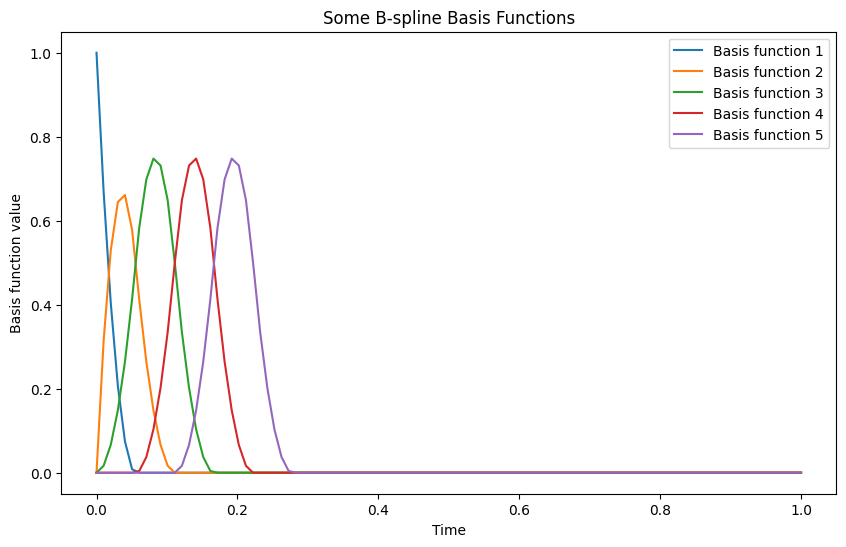

In [4]:
# [4]
# Defining Basis Functions (B-splines)

# Define B-spline basis functions
order = 3  # B-splines of degree 4
num_basis = 21  # Number of basis functions as per the reference

# Create knots between t=0 and t=15, with equal spacing
knots = np.linspace(model.t_span[0], model.t_span[1], num_basis - (order - 1))

# Add additional knots at the boundaries to satisfy B-spline requirements
knots = np.concatenate((
    np.full(order - 1, model.t_span[0]),
    knots,
    np.full(order - 1, model.t_span[1])
))

# Create list of basis functions
basis_functions = []
for i in range(len(knots) - order):
    coeffs = np.zeros(len(knots) - order)
    coeffs[i] = 1
    spline = BSpline(knots, coeffs, order - 1, extrapolate=False)
    basis_functions.append(spline)

# Evaluate basis functions at t_eval
Phi_t_eval = np.array([spline(model.t_eval) for spline in basis_functions])

# Plot some of the basis functions
plt.figure(figsize=(10, 6))
for i in range(min(5, len(basis_functions))):
    plt.plot(model.t_eval, Phi_t_eval[i], label=f'Basis function {i+1}')
plt.xlabel('Time')
plt.ylabel('Basis function value')
plt.legend()
plt.title('Some B-spline Basis Functions')
plt.show()

<!-- MD -->

## Defining Basis Functions (B-splines)

We define the basis function approximation for each variable:

$$
x(t, \mathbf{c}(\theta, \lambda)) = \sum_k c_k(\theta, \lambda) \phi_k(t)
$$

We use order 5 B-splines (degree 4 polynomials) with 34 basis functions, as per the reference.

In [5]:
# [5]
# Defining Quadrature Points and Weights

# Define quadrature points and weights
num_quad = 129  # Must be odd for Simpson's Rule
t_quad = np.linspace(model.t_span[0], model.t_span[1], num_quad)

# Compute quadrature weights using Simpson's Rule
def simpson_weights(n, h):
    w = np.ones(n)
    w[1:-1:2] = 4
    w[2:-2:2] = 2
    w *= h / 3
    return w

h = (model.t_span[1] - model.t_span[0]) / (num_quad - 1)
w_quad = simpson_weights(num_quad, h)

# Evaluate basis functions and their derivatives at quadrature points
Phi_t_quad = np.array([spline(t_quad) for spline in basis_functions])
dPhi_t_quad = np.array([spline.derivative()(t_quad) for spline in basis_functions])

<!-- MD -->

## Defining Quadrature Points and Weights

To approximate the integral in the inner criterion J(c,θ,λ) J(\mathbf{c}, \theta, \lambda) , we use numerical quadrature. We choose 151 equally spaced quadrature points over the time interval and use Simpson's Rule for the quadrature weights.

We use SymPy to compute the symbolic derivatives needed in the `CollocInfer` method, including the partial derivatives of the differential equations with respect to the state variables and parameters.

This is important for implementing the optimization steps and handling numerical issues.

In [6]:
# [7]
# Defining the Inner Criterion J(c, θ, λ)

# Precompute basis functions and their derivatives at observation points
dPhi_t_eval = np.array([spline.derivative()(model.t_eval) for spline in basis_functions])

# Define functions to compute ln x(t) for each variable
def ln_x(c, Phi):
    # ln x(t) = sum c_k * phi_k(t)
    lnX = np.dot(c, Phi)
    return lnX

# Define functions to compute derivative of ln x(t)
def dln_x_dt(c, dPhi):
    dxdt = np.dot(c, dPhi)
    return dxdt


<!-- MD -->

## Defining the Inner Criterion $ J(c,θ,λ) $

The inner criterion combines the data fitting term and the equation fitting term.

We use the precomputed basis functions and their derivatives to evaluate the approximations and their derivatives.


In [7]:
# [8]
# Compute_J function

def compute_J(c_all, theta, lambda_):
    num_vars = len(model.variable_names)
    num_c = Phi_t_eval.shape[0]
    c_vars = [c_all[i*num_c:(i+1)*num_c] for i in range(num_vars)]
    # Data fitting term
    data_term = 0
    for i, var in enumerate(model.variable_names):
        if var in model.observed_data:
            ln_obs = np.log(model.observed_data[var])
            ln_model = ln_x(c_vars[i], Phi_t_eval)
            res_data = ln_obs - ln_model
            data_term += np.sum(res_data ** 2)
    # Equation fitting term
    # At quadrature points
    lnX_quad = [ln_x(c_vars[i], Phi_t_quad) for i in range(num_vars)]
    dlnXdt_quad = [dln_x_dt(c_vars[i], dPhi_t_quad) for i in range(num_vars)]
    # Prepare variables for computing RHS and derivatives
    ln_var_values = np.array(lnX_quad)  # Shape (num_vars, num_quad)
    ln_var_values_T = ln_var_values.T  # Shape (num_quad, num_vars)
    if enforce_positive_parameters:
        param_values = theta
    else:
        param_values = theta
    eq_term = 0
    for i in range(num_vars):
        # Compute RHS of ODE
        rhs_func = model.ln_ode_rhs_func[i]
        # For each time point, compute RHS
        rhs_values = rhs_func(*ln_var_values_T.T, *param_values)
        res_eq = dlnXdt_quad[i] - rhs_values
        eq_term += np.sum(w_quad * res_eq ** 2)
    # Total criterion
    J = data_term + (lambda_) * (eq_term)
    return J

<!-- MD -->

## Computing the Inner Criterion J(c,θ,λ) J(\mathbf{c}, \theta, \lambda) 

We implement the function `compute_J` to calculate the value of the inner criterion. It consists of two parts:

- **Data Fitting Term:** Measures the discrepancy between the observed data and the model predictions at the observation times.
- **Equation Fitting Term:** Measures how well the derivatives of the model approximations satisfy the differential equations over the time interval.

The weights ww from Simpson's Rule are used in the equation fitting term.


In [8]:
# [9]
# Inner Optimization: Minimizing J with respect to c

def inner_optimization(theta, lambda_):
    num_vars = len(model.variable_names)
    num_c = Phi_t_eval.shape[0]
    c_init = np.zeros(num_vars * num_c)  # c for all variables
    # Define the objective function for optimization
    def objective(c_all):
        return compute_J(c_all, theta, lambda_)
    res = minimize(objective, c_init, method='L-BFGS-B')
    c_opt = res.x
    return c_opt

<!-- MD -->

## Inner Optimization: Minimizing J(c,θ,λ) J(\mathbf{c}, \theta, \lambda)  with Respect to c \mathbf{c} 

We use a numerical optimization method to minimize J(c,θ,λ) J(\mathbf{c}, \theta, \lambda)  with respect to the coefficients  c \mathbf{c}  for fixed θ \theta  and λ \lambda .

In our implementation, we use the `L-BFGS-B` method from SciPy.

In [9]:
# [10]
# Outer Optimization: Updating Parameters θ

def colloc_infer(theta_init, lambda_seq):
    theta = theta_init.copy()
    theta_list = []
    c_list = []
    J_list = []
    for lambda_ in lambda_seq:
        print(f"Lambda: {lambda_}; {theta}")
        # Inner optimization: optimize c for fixed θ and λ
        c_opt = inner_optimization(theta, lambda_)
        # Outer optimization: optimize θ for fixed c and λ
        def outer_objective(theta):
            return compute_J(c_opt, theta, lambda_)
        # Compute gradient of J with respect to theta
        def outer_jacobian(theta):
            return compute_J_gradient(c_opt, theta, lambda_)
        # Compute Hessian diagonal of J with respect to theta
        # Note: L-BFGS-B does not accept Hessian, but we compute it for completeness
        def outer_hessian(theta):
            hess_diag = compute_J_hessian_diagonal(c_opt, theta, lambda_)
            return np.diag(hess_diag)
        
        
        
        # res = minimize(outer_objective, theta, method='trust-constr', jac=outer_jacobian, hess=outer_hessian, bounds=[(0.1 * v, 10.0 * v) for v in model.true_params], options={'maxiter':500}) 

        

        # res = minimize(outer_objective, theta, method='trust-constr', jac=outer_jacobian, hess=outer_hessian, bounds=[(0.1 * v, 10.0 * v) for v in model.true_params], options={'maxiter':50}) 

        res = least_squares(outer_objective, theta, bounds=([0.1 * v for v in model.true_params], [10 * v for v in model.true_params]), jac=outer_jacobian, tr_solver='lsmr')
        
        # res = minimize(outer_objective, theta, method='L-BFGS-B', jac=outer_jacobian, hess=outer_hessian, bounds=[(0.00001, +140.0) for i in range(len(theta))], options={'maxiter':5000})
        # res = minimize(outer_objective, theta, method='L-BFGS-B',bounds=[(0.00001, +140.0) for i in range(len(theta))], options={'maxiter':5000})
        theta = res.x
        # Store results
        theta_list.append(theta)
        c_list.append(c_opt)
        J_list.append(res.fun)
        # Visualize current fit
        plot_current_fit(theta, c_opt, lambda_)
    return theta_list, c_list, J_list

# Function to compute gradient of J with respect to theta
def compute_J_gradient(c_all, theta, lambda_):
    num_vars = len(model.variable_names)
    num_c = Phi_t_eval.shape[0]
    c_vars = [c_all[i*num_c:(i+1)*num_c] for i in range(num_vars)]
    # Data fitting term gradient is zero w.r.t theta
    # Equation fitting term
    lnX_quad = [ln_x(c_vars[i], Phi_t_quad) for i in range(num_vars)]
    dlnXdt_quad = [dln_x_dt(c_vars[i], dPhi_t_quad) for i in range(num_vars)]
    ln_var_values = np.array(lnX_quad)
    ln_var_values_T = ln_var_values.T
    if enforce_positive_parameters:
        param_values = theta
    else:
        param_values = theta
    gradient = np.zeros_like(theta)
    for i in range(num_vars):
        # Compute RHS of ODE
        rhs_func = model.ln_ode_rhs_func[i]
        rhs_values = rhs_func(*ln_var_values_T.T, *param_values)
        res_eq = dlnXdt_quad[i] - rhs_values
        # Compute derivative of RHS with respect to parameters
        for j, param_name in enumerate(model.parameter_names):
            # Get derivative function
            deriv_func = model.derivatives_func[i][str(model.symbolic_parameters[j])]
            deriv_values = deriv_func(*ln_var_values_T.T, *param_values)
            gradient[j] += -2 * lambda_ * np.sum(w_quad * res_eq * deriv_values)
    return gradient

# Function to compute Hessian diagonal of J with respect to theta
def compute_J_hessian_diagonal(c_all, theta, lambda_):
    num_vars = len(model.variable_names)
    num_c = Phi_t_eval.shape[0]
    c_vars = [c_all[i*num_c:(i+1)*num_c] for i in range(num_vars)]
    lnX_quad = [ln_x(c_vars[i], Phi_t_quad) for i in range(num_vars)]
    dlnXdt_quad = [dln_x_dt(c_vars[i], dPhi_t_quad) for i in range(num_vars)]
    ln_var_values = np.array(lnX_quad)
    ln_var_values_T = ln_var_values.T
    if enforce_positive_parameters:
        param_values = theta
    else:
        param_values = theta
    hessian_diag = np.zeros_like(theta)
    for j, param_name in enumerate(model.parameter_names):
        hess = 0
        for i in range(num_vars):
            # Compute RHS of ODE
            rhs_func = model.ln_ode_rhs_func[i]
            rhs_values = rhs_func(*ln_var_values_T.T, *param_values)
            res_eq = dlnXdt_quad[i] - rhs_values
            # Get first derivative function
            deriv_func = model.derivatives_func[i][str(model.symbolic_parameters[j])]
            deriv_values = deriv_func(*ln_var_values_T.T, *param_values)
            # Get second derivative function
            second_deriv_expr = sp.diff(model.derivatives[i][str(model.symbolic_parameters[j])], model.symbolic_parameters[j])
            second_deriv_func = lambdify(model.ln_symbolic_variables + model.symbolic_parameters, second_deriv_expr.subs(model.param_subs), 'numpy')
            second_deriv_values = second_deriv_func(*ln_var_values_T.T, *param_values)
            hess += 2 * lambda_ * np.sum(w_quad * (deriv_values ** 2 + res_eq * second_deriv_values))
        hessian_diag[j] = hess
    return hessian_diag

# Function to plot current fit
def plot_current_fit(theta, c_opt, lambda_):
    num_vars = len(model.variable_names)
    num_c = Phi_t_eval.shape[0]
    c_vars = [c_opt[i*num_c:(i+1)*num_c] for i in range(num_vars)]
    lnX_model = [ln_x(c_vars[i], Phi_t_eval) for i in range(num_vars)]
    X_model = [np.exp(lnX) for lnX in lnX_model]
    param_values = theta
    param_values_exp = param_values
    def ode_system(t, y):
        # Evaluate the ODEs at given y and t
        y_list = list(y)
        args = y_list + list(param_values_exp)
        dydt = [ode_func(*args) for ode_func in model.ode_rhs_func]
        return dydt
    ode_sol = solve_ivp(ode_system, model.t_span, model.true_initial_conditions, t_eval=model.t_eval, method='LSODA') #np.array(X_model)[:, 0]
    ode_X = ode_sol.y

    
    plt.figure(figsize=(12, 6))
    for i, var in enumerate(model.variable_names):
        plt.subplot(2, (num_vars+1)//2, i+1)
        if var in model.observed_data:
            plt.scatter(model.t_eval, model.observed_data[var], color='red', s=10, label='Noisy Observations')
        plt.plot(model.t_eval, X_model[i], label=f'Estimated {var}(t)')
        plt.plot(model.t_eval, ode_X[i], label=f"ODEs {var}(t)")
        plt.xlabel('Time')
        plt.ylabel(f'{var}(t)')
        plt.legend()
        plt.title(f'Variable {var} (Lambda={lambda_})')
    plt.tight_layout()
    plt.show()

<!-- MD -->

## Outer Optimization: Updating Parameters θ \theta 

We iteratively update the parameters θ \theta   by minimizing the outer criterion H(θ,λ)=J(c∗(θ,λ),θ,λ) H(\theta, \lambda) = J(\mathbf{c}^*(\theta, \lambda), \theta, \lambda)  for each λ \lambda .

We compute the gradient of J J  with respect to θ \theta  and pass it to the optimizer. Although L-BFGS-B does not accept the Hessian, we compute it for completeness and future use.

In our implementation, we use the `L-BFGS-B` method and provide the explicit gradient.

### Lambda Progression Strategy

We progress λ \lambda  over a sequence of increasing values.

This allows us to explore the trade-off between data fit and equation fit, and to examine the stability of parameter estimates.


BASTA
Lambda: 0.001; [2.64890069, 760.446768, 12.539205, 10.9553833, 77.9907814, 0.88605561, 14.2414103, 1.92207389, 14.2026486, 17.0951541, 0.364097847, 0.0939931292, 0.507681279, 4.97932799]


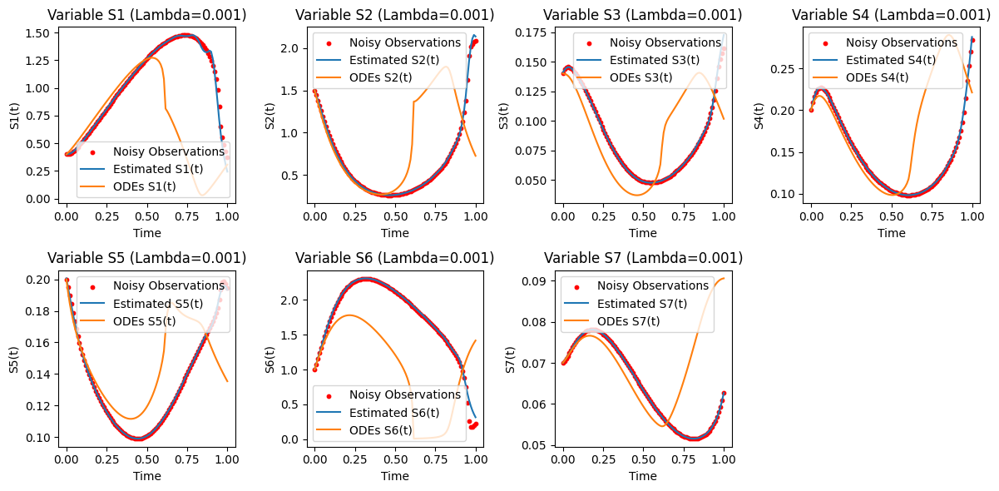

Lambda: 0.0014873521072935117; [2.32594634e+00 7.55361804e+02 1.16646002e+01 1.26921160e+01
 7.98642474e+01 2.50460162e+00 1.20758467e+01 1.93796879e+00
 1.48207351e+01 1.70951541e+01 2.37038699e-01 9.35878155e-02
 5.36415460e-01 4.31952252e+00]


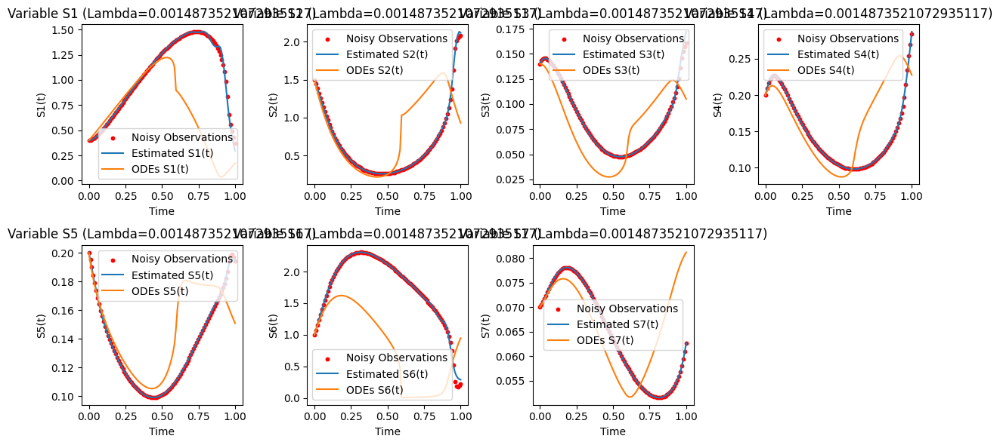

Lambda: 0.00221221629107045; [1.97053517e+00 7.52030112e+02 1.08895521e+01 1.25017007e+01
 8.03897303e+01 3.28670115e+00 1.08136631e+01 1.93165029e+00
 1.41984244e+01 1.70951541e+01 1.85502653e-01 9.74636642e-02
 5.50392401e-01 4.25811600e+00]


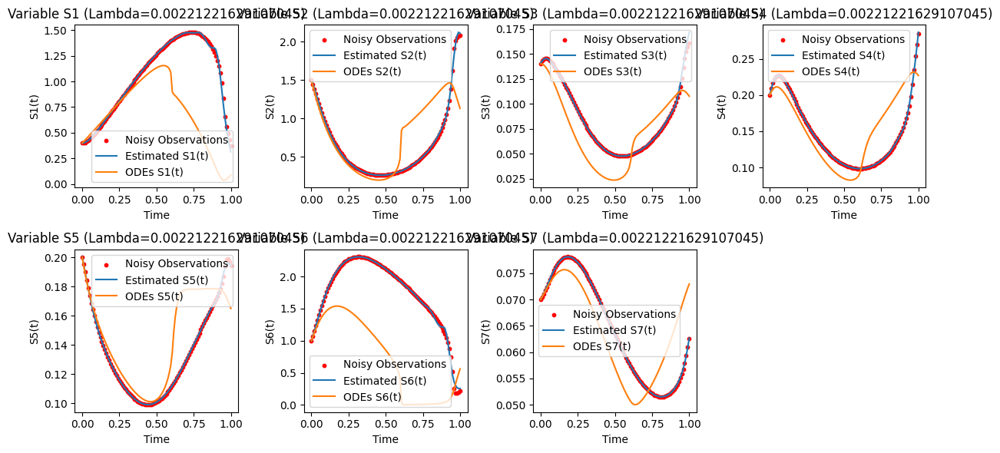

Lambda: 0.0032903445623126675; [1.69335850e+00 7.49489318e+02 1.01721612e+01 1.20757027e+01
 8.02599676e+01 3.68398247e+00 9.92858125e+00 1.92561269e+00
 1.34027930e+01 1.70951541e+01 1.60208498e-01 1.03008347e-01
 5.63696223e-01 4.25587446e+00]


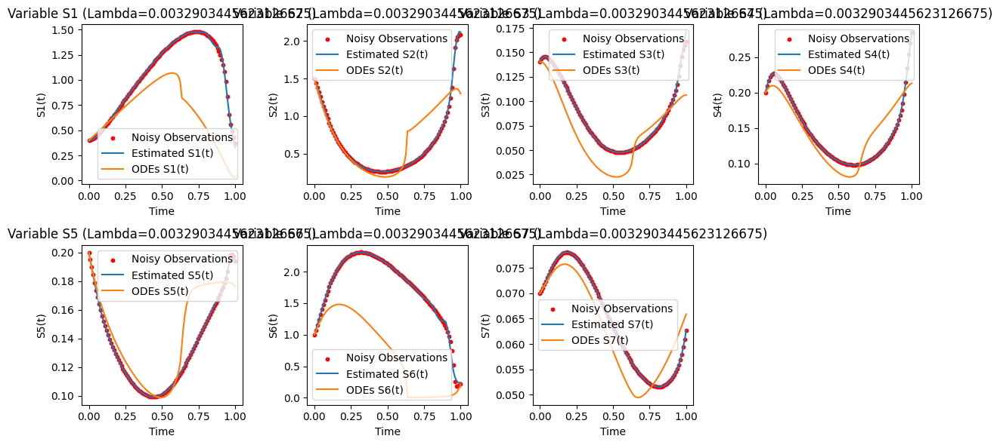

Lambda: 0.004893900918477494; [1.42672397e+00 7.48981886e+02 9.45922883e+00 1.11101845e+01
 7.87540274e+01 3.86252245e+00 8.83638959e+00 1.91750559e+00
 1.21173748e+01 1.70951541e+01 1.46161462e-01 1.13590819e-01
 5.69234005e-01 4.31845124e+00]


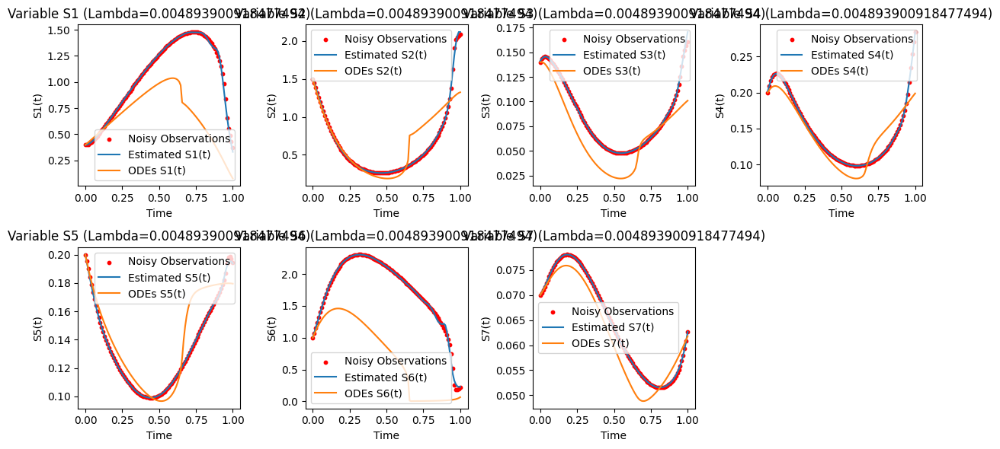

Lambda: 0.007278953843983154; [1.30158872e+00 7.48690542e+02 9.08795617e+00 1.05998946e+01
 7.76894481e+01 3.87652343e+00 8.23820176e+00 1.91252379e+00
 1.13300242e+01 1.70951541e+01 1.39255563e-01 1.21368009e-01
 5.70775406e-01 4.34732634e+00]


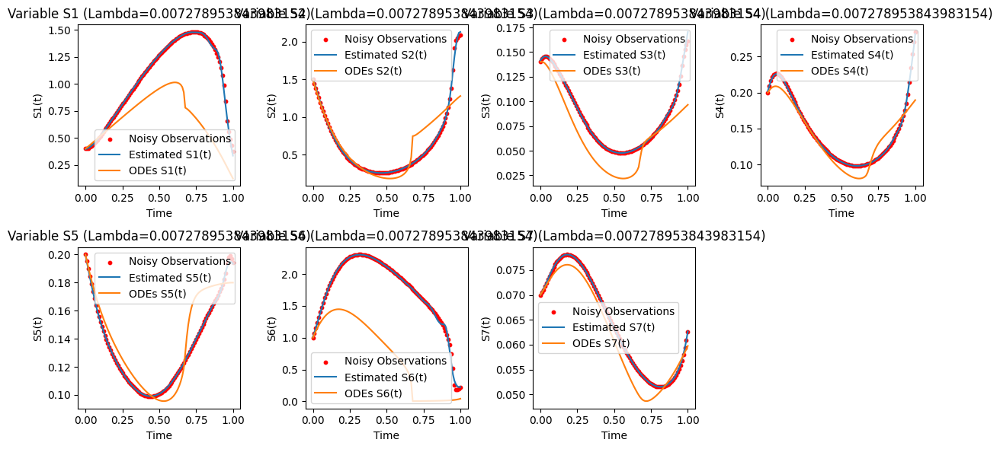

Lambda: 0.010826367338740546; [1.22092032e+00 7.48479779e+02 8.83864214e+00 1.02591416e+01
 7.68435100e+01 3.86125366e+00 7.82097731e+00 1.90883119e+00
 1.07559604e+01 1.70951541e+01 1.36097475e-01 1.27849834e-01
 5.71027532e-01 4.36336663e+00]


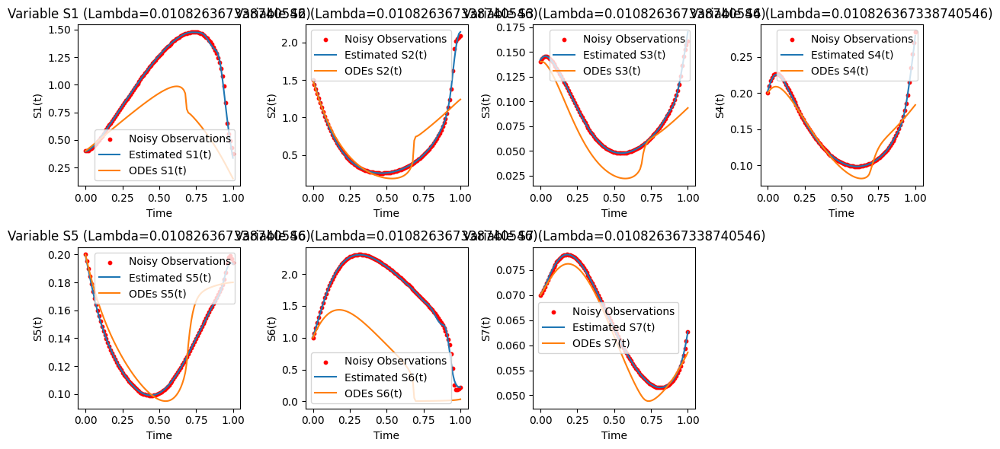

Lambda: 0.01610262027560939; [1.14960398e+00 7.48275737e+02 8.61077962e+00 9.95622897e+00
 7.59884122e+01 3.82633947e+00 7.43319554e+00 1.90523846e+00
 1.02078699e+01 1.70951541e+01 1.34963900e-01 1.34799592e-01
 5.70724419e-01 4.37471557e+00]


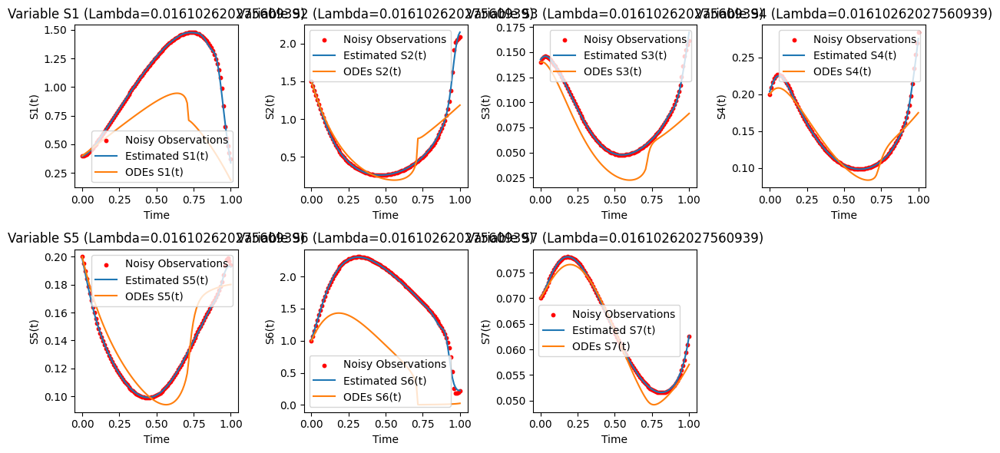

Lambda: 0.02395026619987486; [1.04477915e+00 7.47933144e+02 8.24385001e+00 9.49757178e+00
 7.45266148e+01 3.72710200e+00 6.82555516e+00 1.89922510e+00
 9.32601434e+00 1.70951541e+01 1.34587391e-01 1.47546417e-01
 5.71064785e-01 4.38892948e+00]


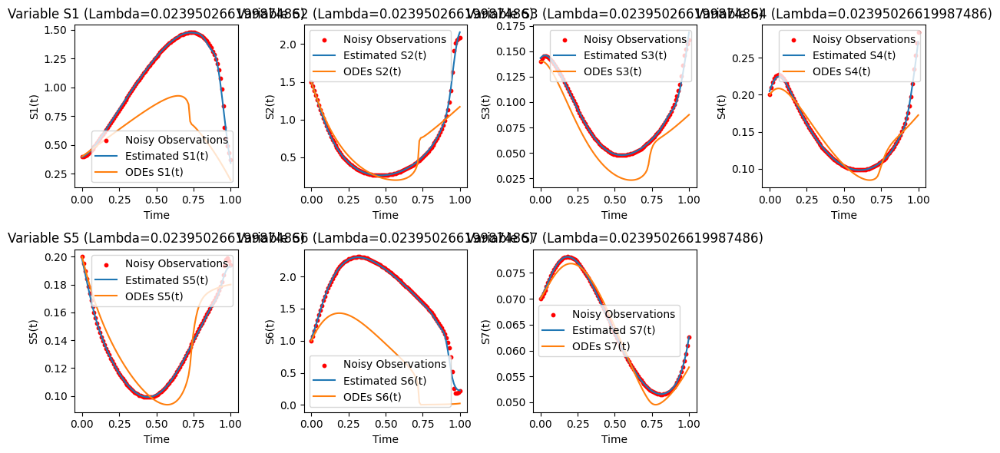

Lambda: 0.03562247890262444; [1.00097659e+00 7.47767513e+02 8.07310228e+00 9.30295485e+00
 7.38224063e+01 3.66199023e+00 6.54895594e+00 1.89638343e+00
 8.92586970e+00 1.70951541e+01 1.35718784e-01 1.54437563e-01
 5.70839783e-01 4.38993747e+00]


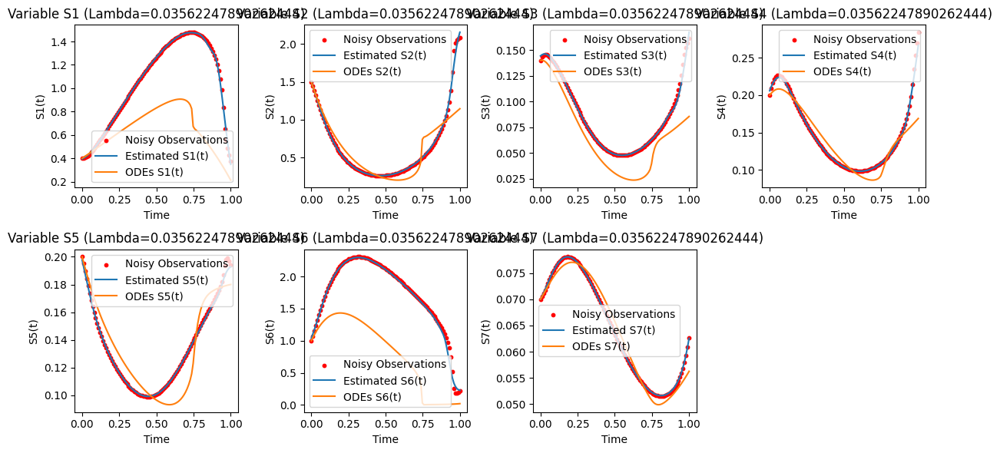

Lambda: 0.0529831690628371; [9.50046813e-01 7.47546214e+02 7.85143918e+00 9.07225117e+00
 7.29172290e+01 3.55514447e+00 6.20127554e+00 1.89288319e+00
 8.42770614e+00 1.70951541e+01 1.37373283e-01 1.63950545e-01
 5.70953285e-01 4.38708331e+00]


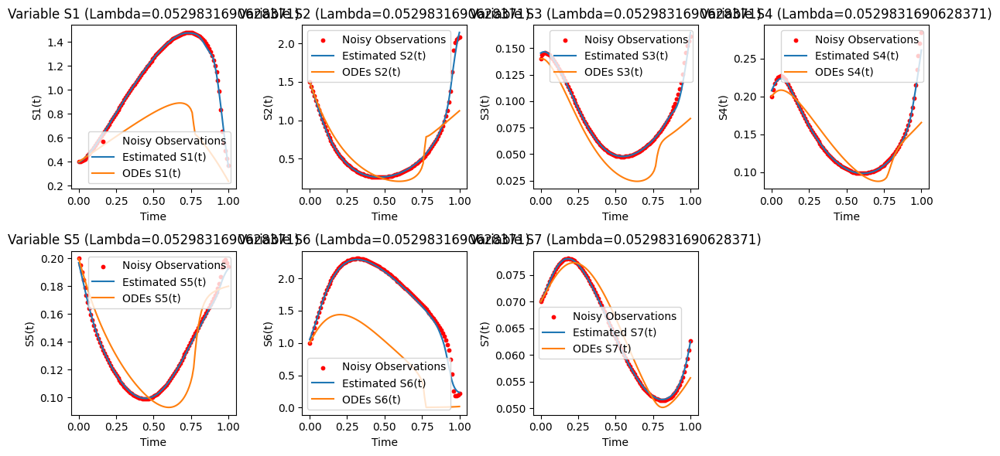

Lambda: 0.07880462815669913; [9.07239186e-01 7.47324157e+02 7.62388089e+00 8.86463965e+00
 7.20290622e+01 3.42790597e+00 5.86439344e+00 1.88965289e+00
 7.95611674e+00 1.70951541e+01 1.39633867e-01 1.74151316e-01
 5.71742788e-01 4.37895395e+00]


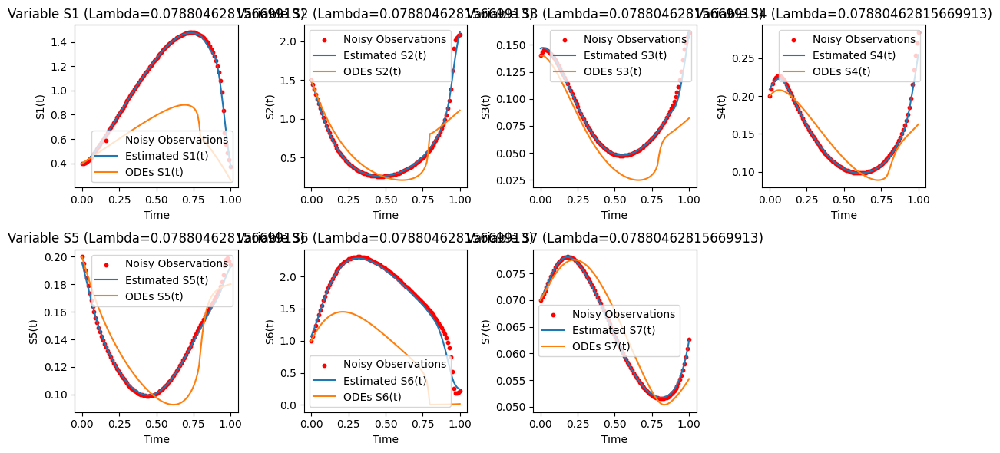

Lambda: 0.11721022975334805; [8.79055993e-01 7.47133551e+02 7.41800182e+00 8.70552457e+00
 7.12992000e+01 3.29652229e+00 5.58213739e+00 1.88721726e+00
 7.57634294e+00 1.70951541e+01 1.42411727e-01 1.83484219e-01
 5.73332507e-01 4.36784695e+00]


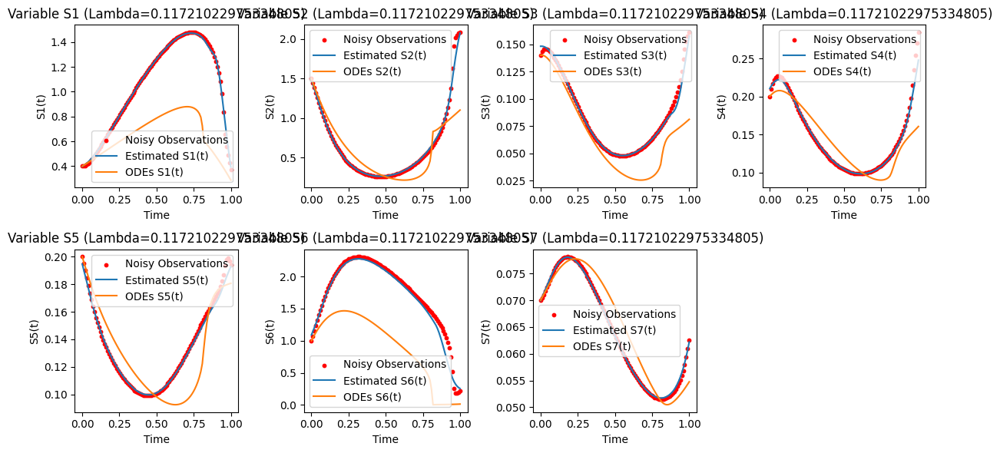

Lambda: 0.1743328822199989; [8.64678808e-01 7.46977959e+02 7.23235440e+00 8.59268419e+00
 7.07474271e+01 3.15944478e+00 5.35277518e+00 1.88563253e+00
 7.28361207e+00 1.70951541e+01 1.45760735e-01 1.91550625e-01
 5.76123438e-01 4.35598297e+00]


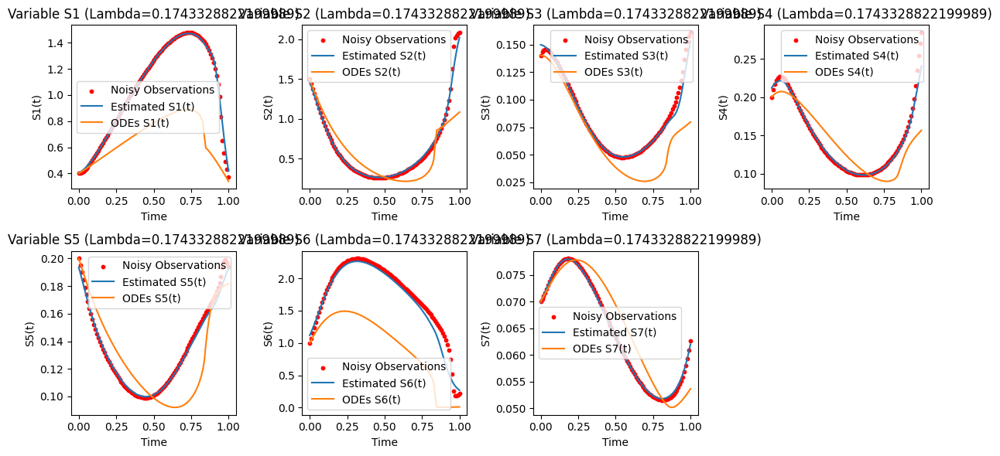

Lambda: 0.2592943797404667; [8.61849139e-01 7.46822624e+02 7.01624556e+00 8.49539955e+00
 7.02727977e+01 2.98277886e+00 5.12412244e+00 1.88478382e+00
 7.00648572e+00 1.70951541e+01 1.49463882e-01 1.99775918e-01
 5.81557548e-01 4.34083036e+00]


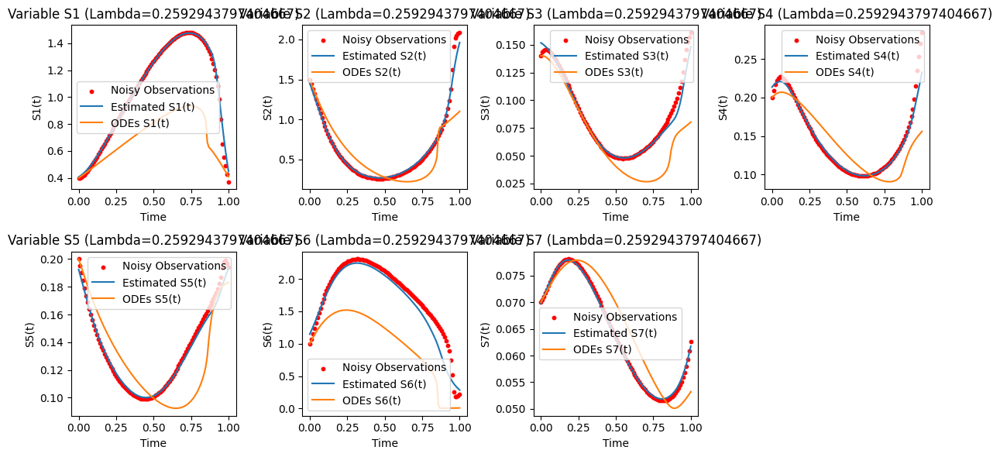

Lambda: 0.38566204211634725; [9.18323174e-01 7.46720649e+02 6.84743661e+00 8.44270622e+00
 7.00219969e+01 2.83024993e+00 4.96836918e+00 1.88694168e+00
 6.83263183e+00 1.70951541e+01 1.53481458e-01 2.05621393e-01
 5.87292812e-01 4.32776465e+00]


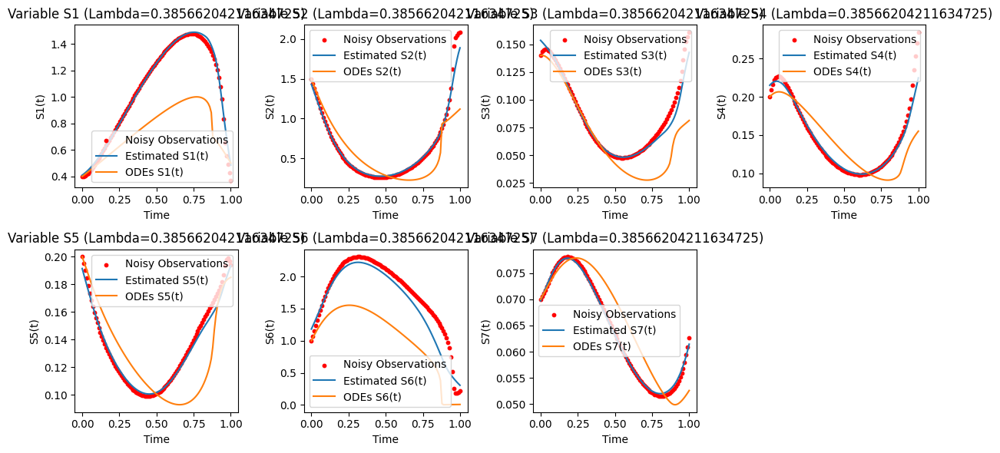

Lambda: 0.5736152510448681; [1.00228797e+00 7.46641295e+02 6.68819795e+00 8.40813203e+00
 6.98931453e+01 2.66947781e+00 4.84120742e+00 1.89652105e+00
 6.70100933e+00 1.70951541e+01 1.57765762e-01 2.10881380e-01
 5.94239354e-01 4.31592149e+00]


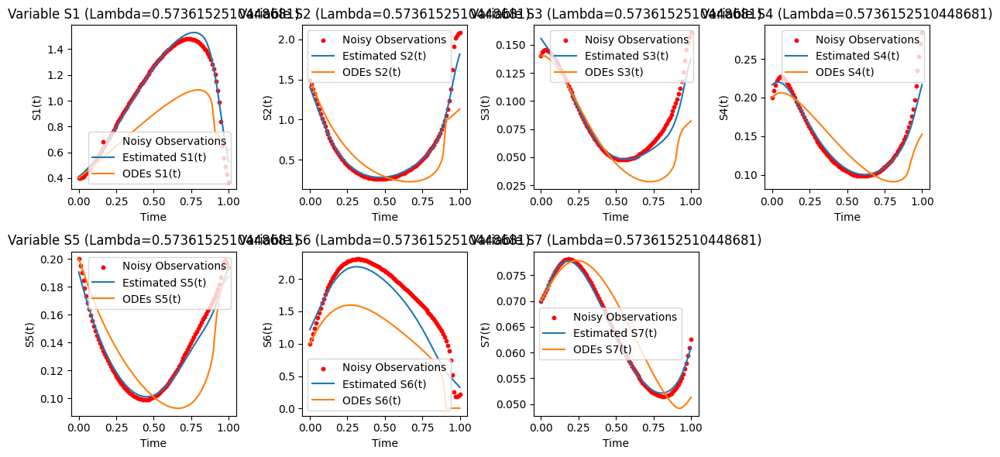

Lambda: 0.8531678524172814; [1.09958791e+00 7.46578002e+02 6.53901359e+00 8.41460623e+00
 7.00347461e+01 2.49358991e+00 4.74678657e+00 1.91403170e+00
 6.60527645e+00 1.70951541e+01 1.62360643e-01 2.15626606e-01
 6.03516783e-01 4.30309388e+00]


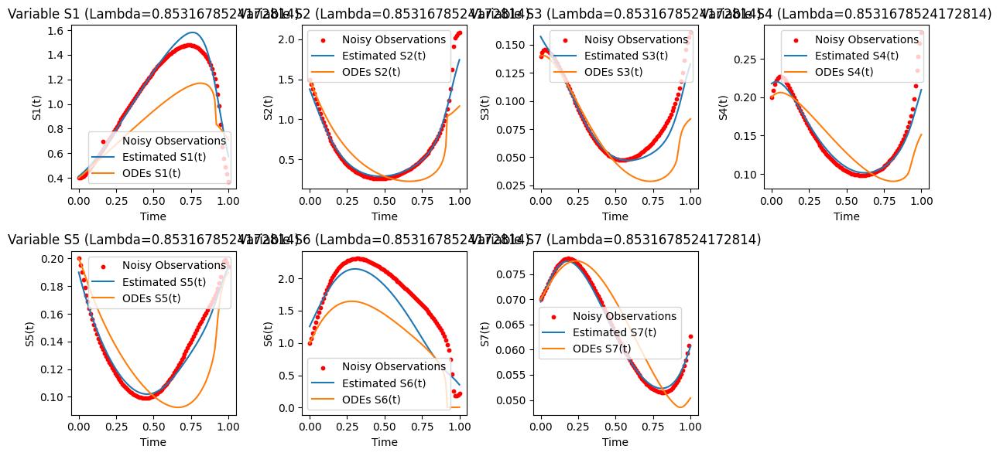

Lambda: 1.2689610031679235; [1.20795971e+00 7.46542669e+02 6.45377513e+00 8.55253283e+00
 7.14445504e+01 2.35586527e+00 4.70823664e+00 1.93228868e+00
 6.56168430e+00 1.70951541e+01 1.67352039e-01 2.18368850e-01
 6.16360099e-01 4.29070881e+00]


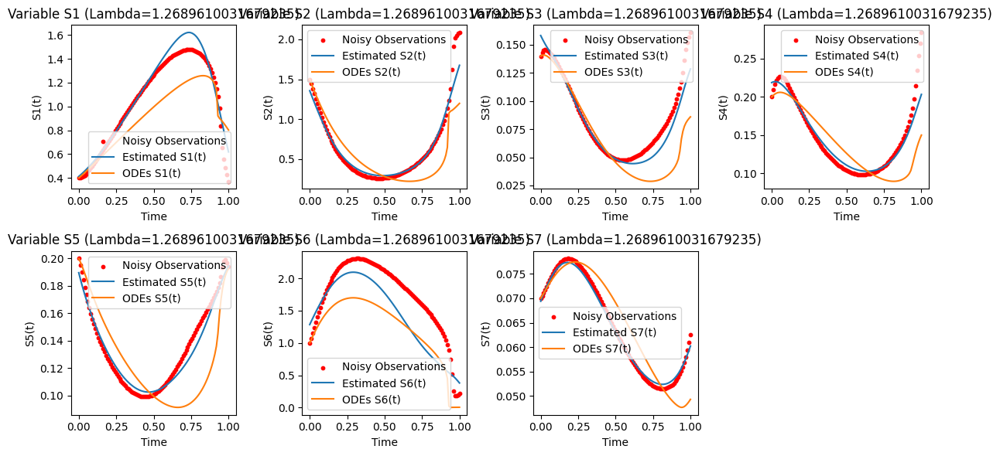

Lambda: 1.8873918221350976; [1.31939859e+00 7.46520326e+02 6.40293248e+00 8.79450661e+00
 7.35407526e+01 2.23560107e+00 4.70054053e+00 1.95050086e+00
 6.54321401e+00 1.70951541e+01 1.72264254e-01 2.19878618e-01
 6.31974175e-01 4.26955447e+00]


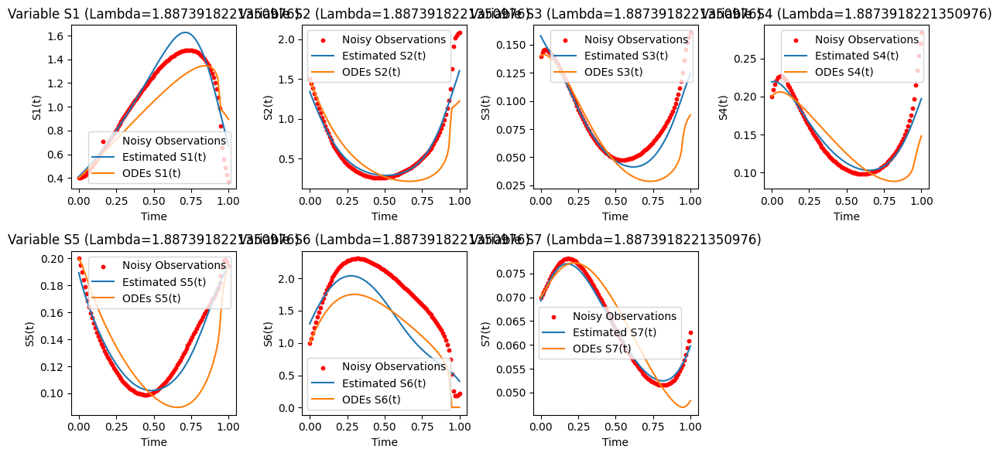

Lambda: 2.8072162039411785; [1.42490429e+00 7.46504584e+02 6.36983097e+00 9.08469470e+00
 7.57971025e+01 2.13043301e+00 4.74868755e+00 1.96740159e+00
 6.54046774e+00 1.70951541e+01 1.76653266e-01 2.20586980e-01
 6.48051887e-01 4.24364131e+00]


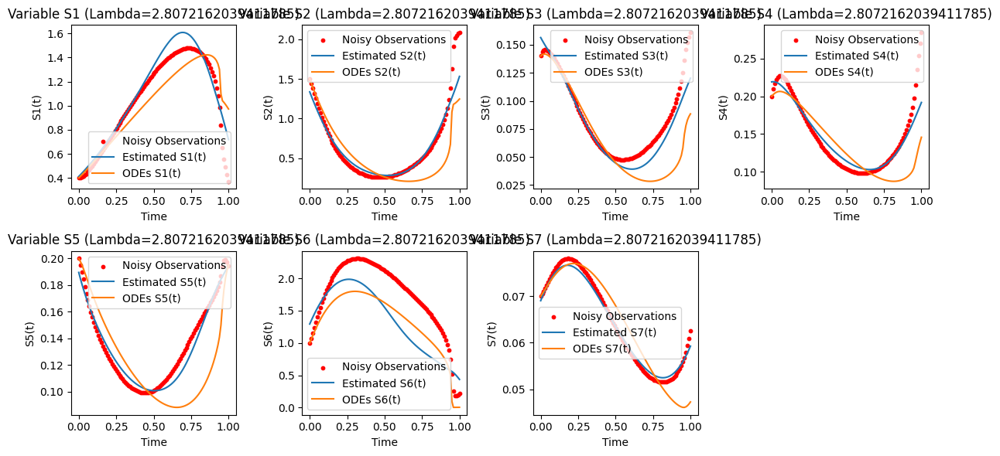

Lambda: 4.175318936560405; [1.51765474e+00 7.46493758e+02 6.34715851e+00 9.37773711e+00
 7.78383517e+01 2.04677486e+00 4.83945690e+00 1.98569903e+00
 6.58988932e+00 1.70951541e+01 1.80335732e-01 2.19809662e-01
 6.63259836e-01 4.21803419e+00]


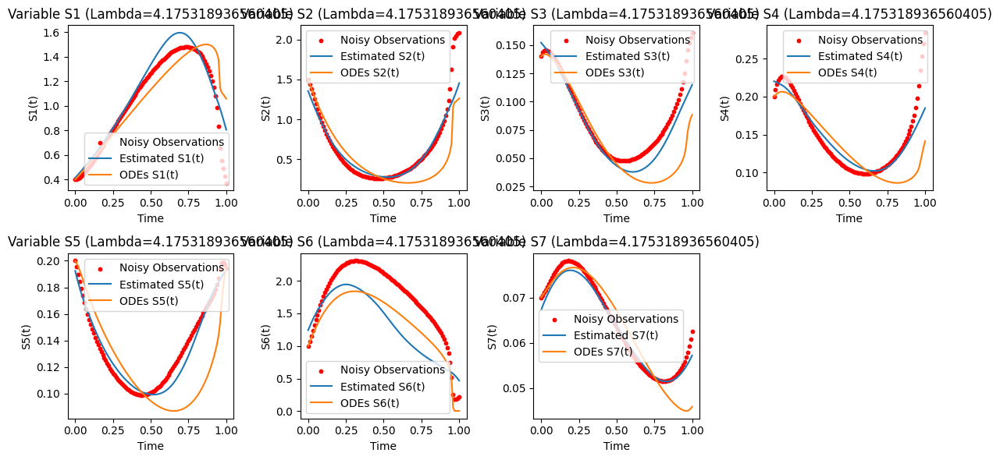

Lambda: 6.2101694189156165; [1.60781391e+00 7.46485886e+02 6.33150125e+00 9.68830799e+00
 7.95589779e+01 1.97251882e+00 4.92388392e+00 2.01113793e+00
 6.64268330e+00 1.70951541e+01 1.83221080e-01 2.17667931e-01
 6.75638270e-01 4.17939711e+00]


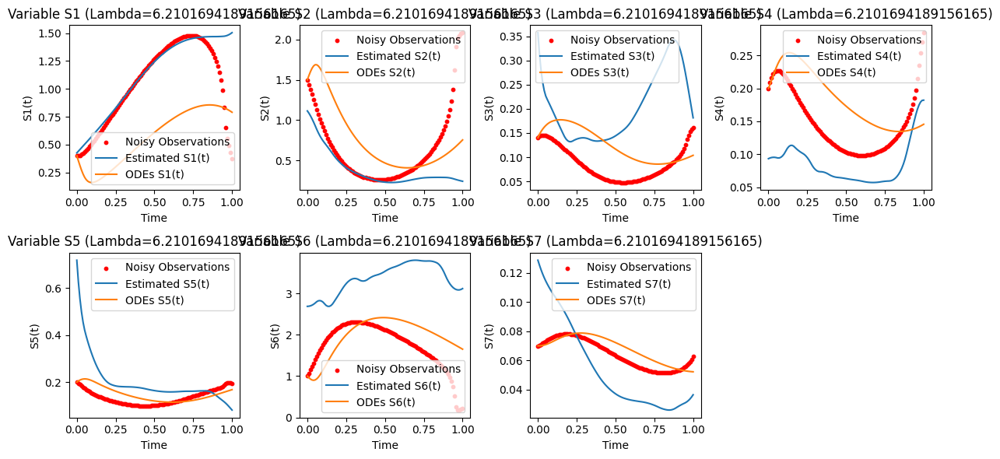

Lambda: 9.236708571873866; [1.83043156e+00 7.46482509e+02 6.29958983e+00 1.06735012e+01
 8.42759913e+01 1.27162651e+00 5.15725302e+00 2.53034912e+00
 6.11203780e+00 1.70951541e+01 3.82236428e-01 2.18791230e-01
 7.82627120e-01 4.15362643e+00]


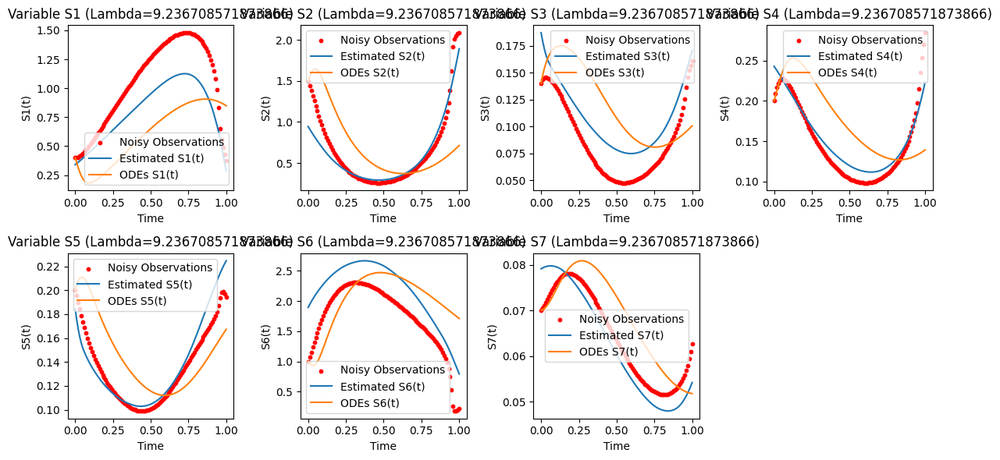

Lambda: 13.738237958832638; [1.86374075e+00 7.46476081e+02 6.51659809e+00 1.10988406e+01
 8.66193286e+01 1.19371127e+00 5.87249791e+00 2.51989809e+00
 6.89227010e+00 1.70951541e+01 3.82979960e-01 2.08053940e-01
 7.91343699e-01 4.18147016e+00]


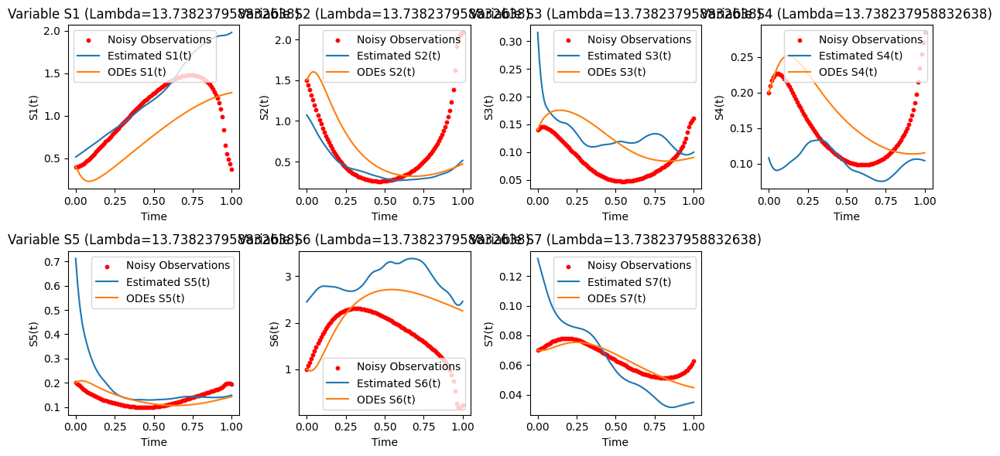

Lambda: 20.43359717856944; [2.01099356e+00 7.46465936e+02 6.71891212e+00 1.11310576e+01
 8.71465838e+01 8.60164467e-01 5.93897243e+00 2.33694313e+00
 6.39587406e+00 1.70951541e+01 3.76693381e-01 1.80721980e-01
 7.73027503e-01 4.16369574e+00]


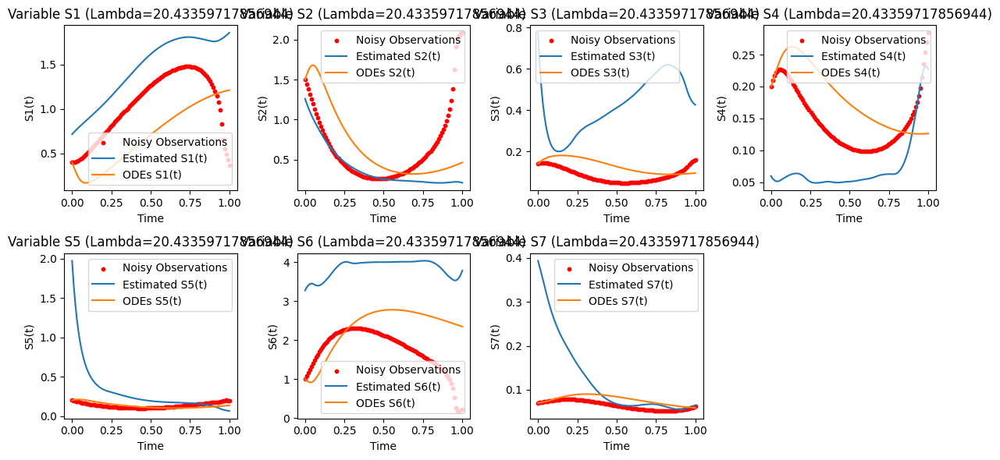

Lambda: 30.39195382313201; [1.99904499e+00 7.46465882e+02 6.92093781e+00 1.11676035e+01
 8.71112797e+01 8.39250613e-01 6.02445611e+00 2.26055161e+00
 6.39837470e+00 1.70951541e+01 3.89809954e-01 2.41355872e-01
 7.58967403e-01 4.16292592e+00]


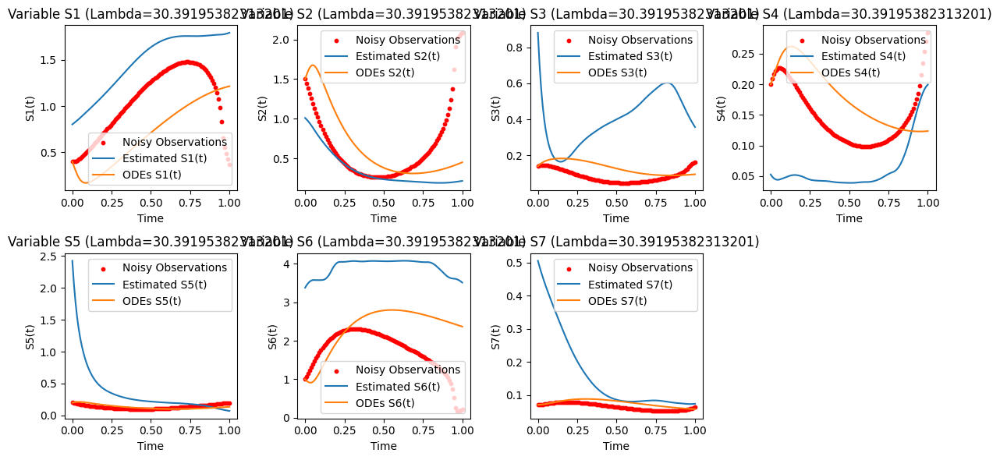

Lambda: 45.2035365636025; [1.98635476e+00 7.46465788e+02 7.11503819e+00 1.11305003e+01
 8.71520843e+01 8.25998339e-01 6.01766317e+00 2.19465113e+00
 6.39471516e+00 1.70951541e+01 3.90487585e-01 2.26030685e-01
 7.53455632e-01 4.16447275e+00]


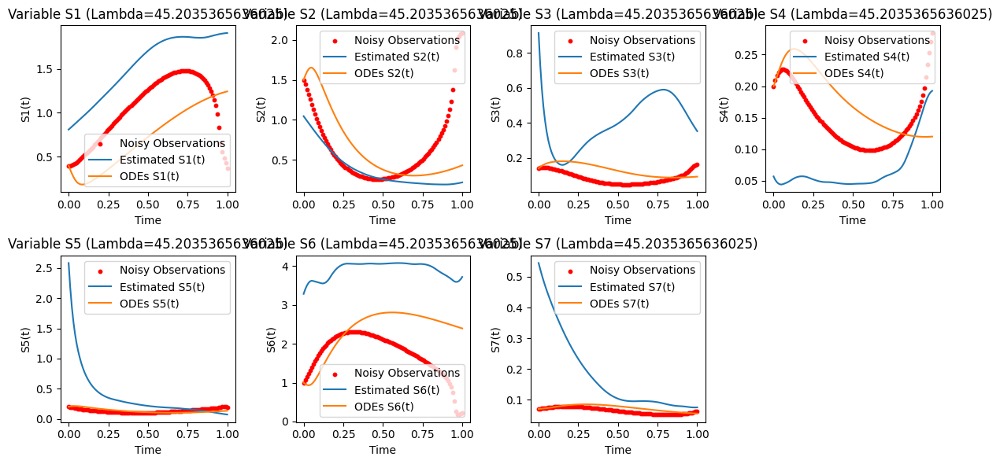

Lambda: 67.23357536499334; [1.97592280e+00 7.46464762e+02 7.10279762e+00 1.11702080e+01
 8.71154622e+01 8.04600426e-01 5.98599164e+00 2.11833304e+00
 6.36819818e+00 1.70951541e+01 3.86886794e-01 2.08575645e-01
 7.50793220e-01 4.16456298e+00]


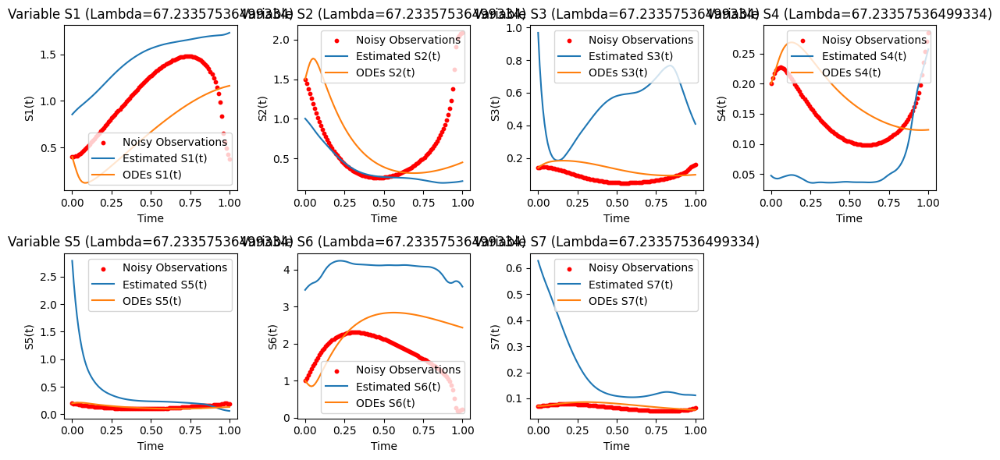

Lambda: 100.0; [1.97165084e+00 7.46464434e+02 7.09936366e+00 1.12326821e+01
 8.71277694e+01 8.00889590e-01 6.01612755e+00 2.09750813e+00
 6.35793818e+00 1.70951541e+01 4.01916800e-01 2.02481491e-01
 7.47326216e-01 4.16475669e+00]


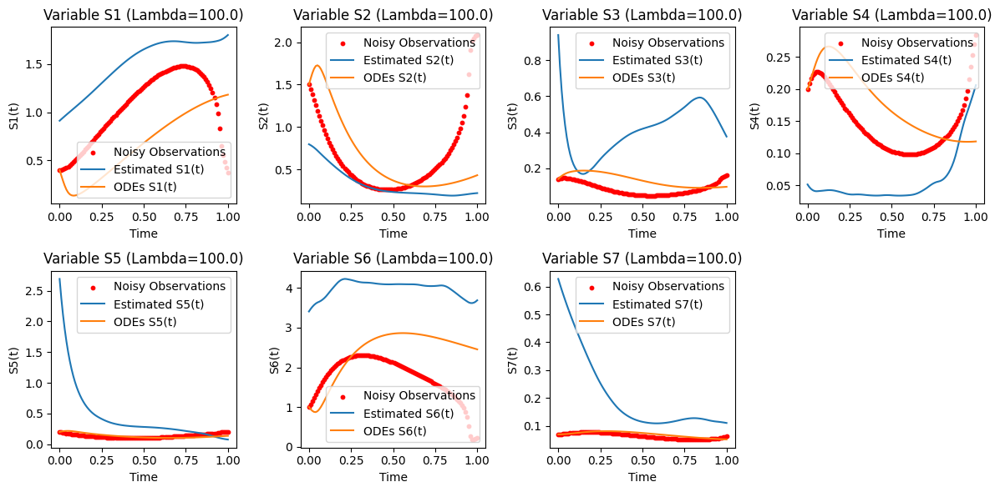

Lambda: 100.0; [1.95784427e+00 7.46463859e+02 7.15172975e+00 1.12560150e+01
 8.71420131e+01 7.85464305e-01 5.99728586e+00 2.02337311e+00
 6.33687483e+00 1.70951541e+01 3.99992343e-01 1.80600605e-01
 7.63228433e-01 4.16592607e+00]


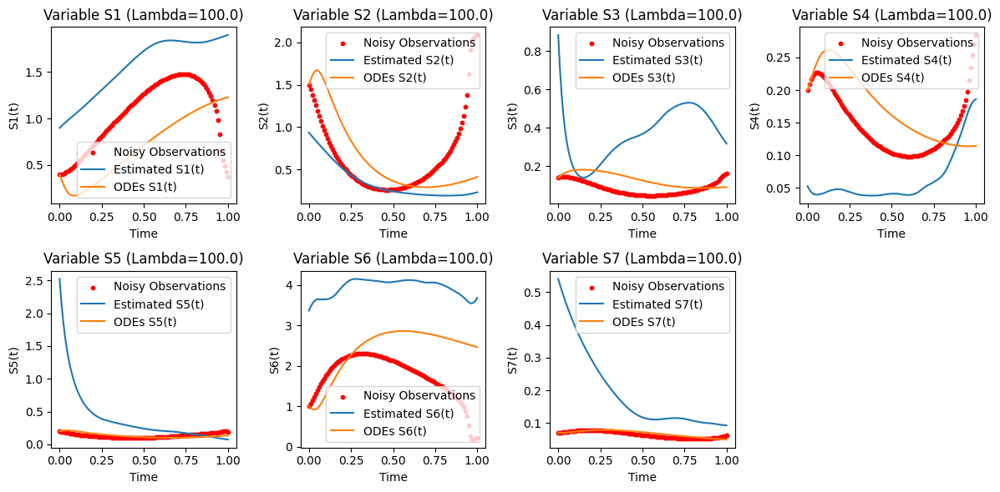

Lambda: 67.23357536499334; [1.94844183e+00 7.46461597e+02 7.14425977e+00 1.13296080e+01
 8.72267330e+01 7.70102583e-01 5.98011589e+00 1.96506104e+00
 6.30782301e+00 1.70951541e+01 3.92029526e-01 1.67491367e-01
 7.61834685e-01 4.16708620e+00]


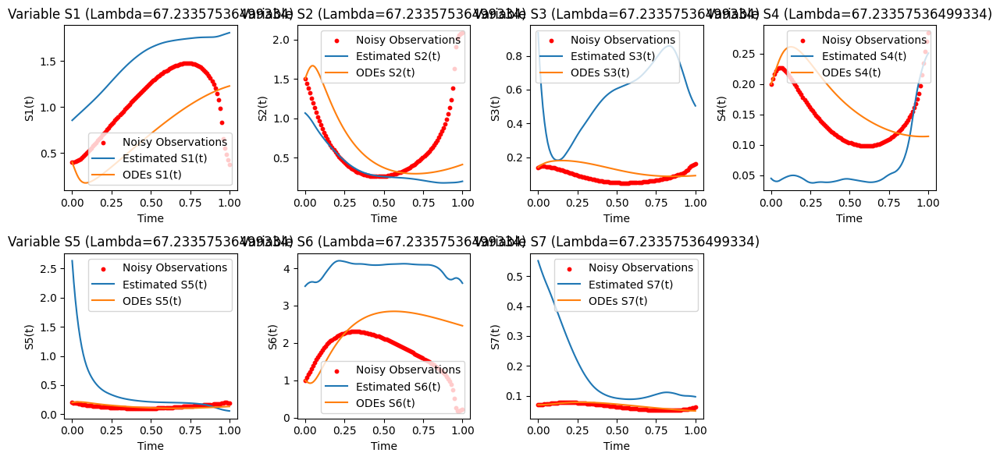

Lambda: 45.2035365636025; [1.94232102e+00 7.46461175e+02 7.13472462e+00 1.13177402e+01
 8.72970127e+01 7.64412200e-01 6.07920333e+00 1.94090224e+00
 6.33700911e+00 1.70951541e+01 3.90547041e-01 1.63624591e-01
 7.50845678e-01 4.16695901e+00]


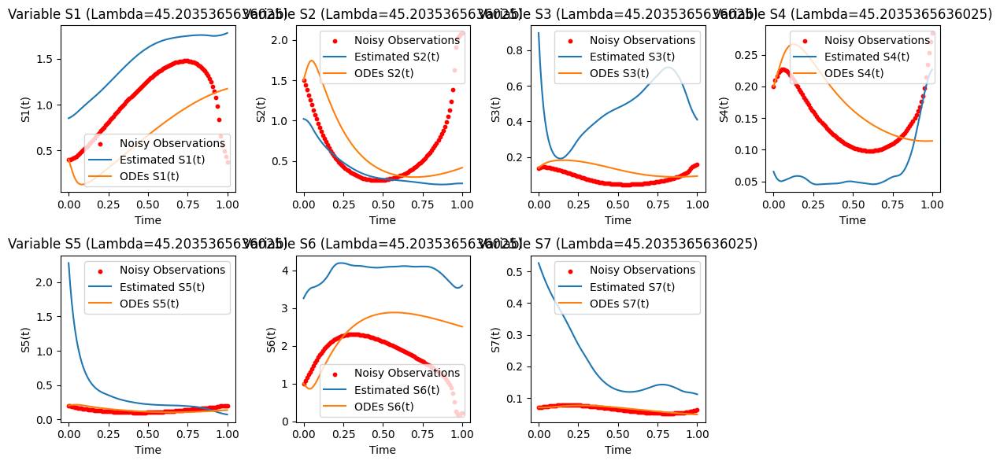

Lambda: 30.39195382313201; [1.93028532e+00 7.46459021e+02 7.14197412e+00 1.12915719e+01
 8.72327548e+01 7.51786895e-01 6.01374848e+00 1.88085033e+00
 6.30736884e+00 1.70951541e+01 4.01354860e-01 1.46423575e-01
 7.49583109e-01 4.16764526e+00]


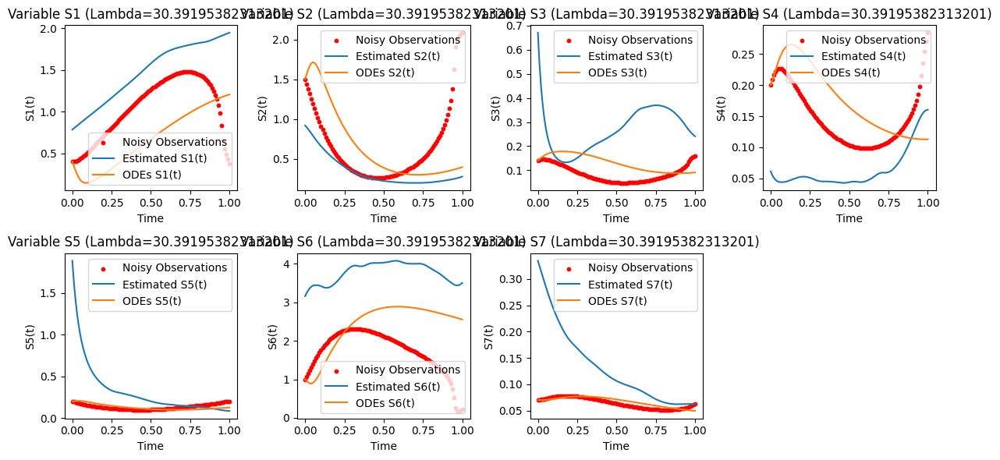

Lambda: 20.43359717856944; [1.91530075e+00 7.46455940e+02 7.06405481e+00 1.12991034e+01
 8.74269314e+01 7.13943869e-01 6.22603999e+00 1.78875160e+00
 6.29124519e+00 1.70951541e+01 3.95506921e-01 1.44090679e-01
 7.35652435e-01 4.16822374e+00]


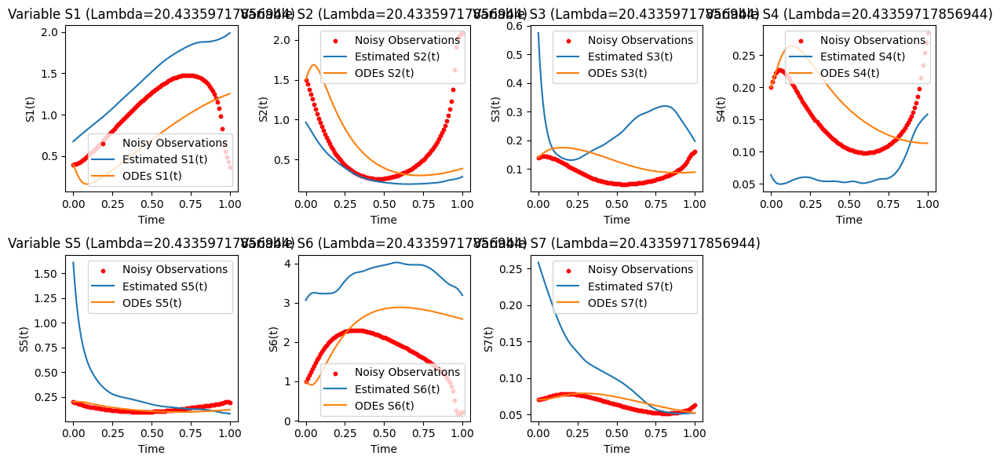

Lambda: 13.738237958832638; [1.94422958e+00 7.46454460e+02 6.75198589e+00 1.12819028e+01
 8.77716042e+01 6.81339831e-01 6.56246004e+00 1.71471672e+00
 6.46843296e+00 1.70951541e+01 3.91015574e-01 1.43397933e-01
 7.47815569e-01 4.16797579e+00]


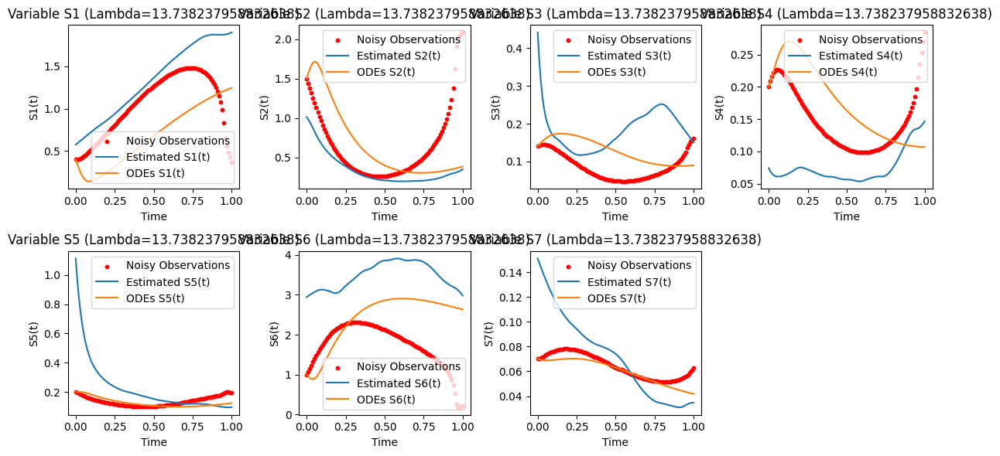

Lambda: 9.236708571873866; [1.94894266e+00 7.46453540e+02 6.56744867e+00 1.13303248e+01
 8.75608194e+01 6.44090259e-01 6.94871918e+00 1.79752930e+00
 6.37558942e+00 1.70951541e+01 3.95061761e-01 1.07815407e-01
 7.53643919e-01 4.16667771e+00]


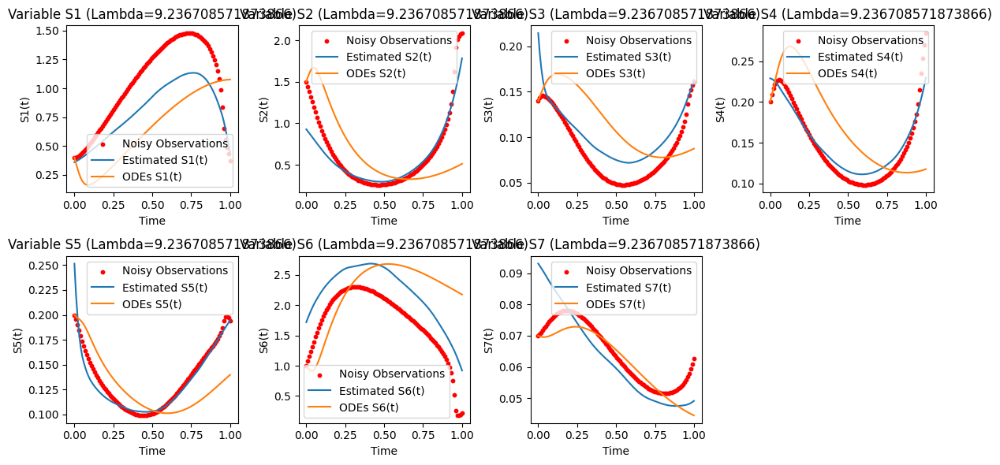

Lambda: 6.2101694189156165; [1.92785759e+00 7.46448094e+02 6.62357967e+00 1.16447692e+01
 8.80439354e+01 8.48827200e-01 7.83650371e+00 1.79412347e+00
 7.45315792e+00 1.70951541e+01 3.93347308e-01 1.04343135e-01
 7.70968321e-01 4.19990038e+00]


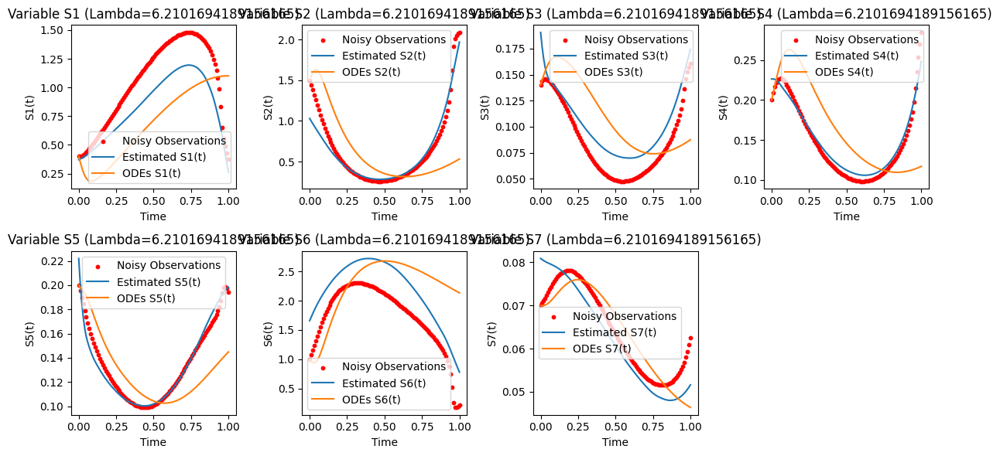

Lambda: 4.175318936560405; [1.99159047e+00 7.46444129e+02 6.77948930e+00 1.20254075e+01
 8.97387418e+01 8.44886309e-01 8.63685790e+00 1.78327955e+00
 8.63503517e+00 1.70951541e+01 3.93323356e-01 1.04058258e-01
 7.85346480e-01 4.24261244e+00]


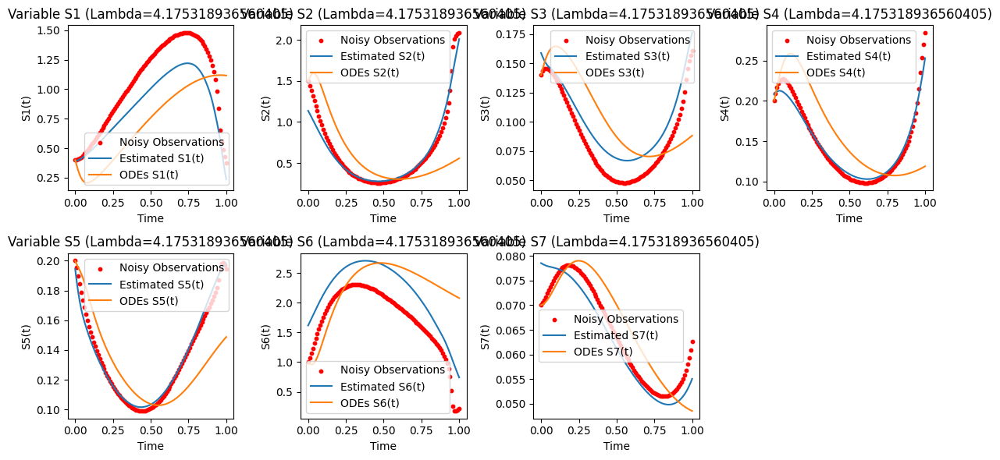

Lambda: 2.8072162039411785; [2.05454074e+00 7.46439377e+02 6.94076909e+00 1.24317841e+01
 9.17372325e+01 8.51202996e-01 9.50260441e+00 1.77528652e+00
 9.82875140e+00 1.70951541e+01 3.92947076e-01 1.04515440e-01
 8.00763143e-01 4.28699894e+00]


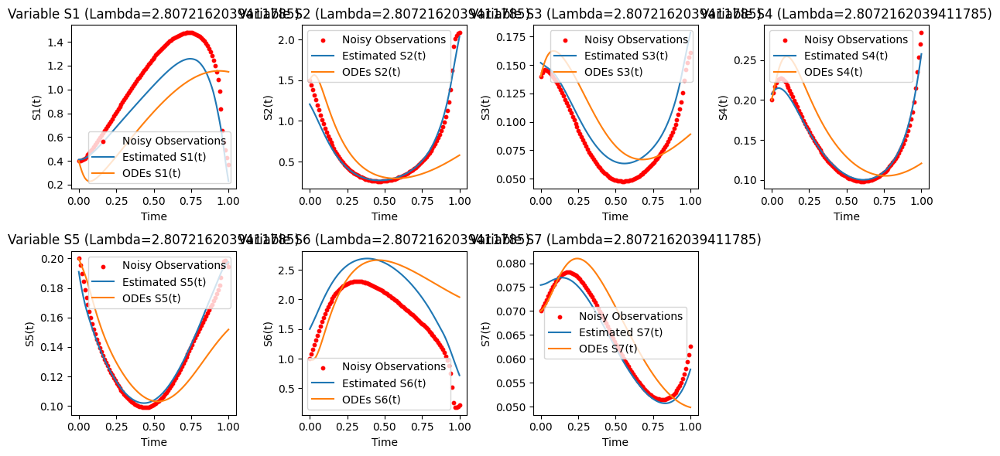

Lambda: 1.8873918221350976; [2.13552374e+00 7.46435778e+02 7.10462117e+00 1.28343779e+01
 9.39854598e+01 8.51559257e-01 1.04213016e+01 1.77128214e+00
 1.10561673e+01 1.70951541e+01 3.92116836e-01 1.02569871e-01
 8.17296601e-01 4.33830778e+00]


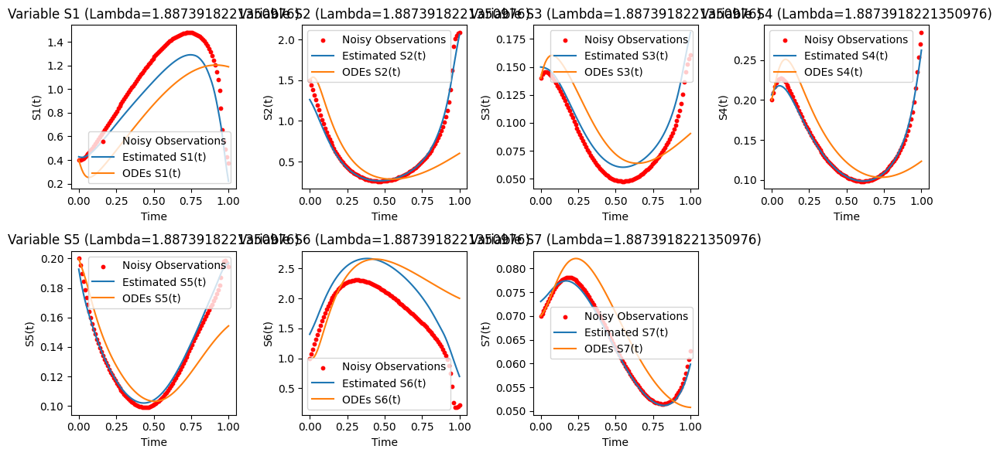

Lambda: 1.2689610031679235; [2.22711003e+00 7.46435249e+02 7.24762086e+00 1.31590400e+01
 9.61824227e+01 8.55118997e-01 1.12859915e+01 1.77344424e+00
 1.21671686e+01 1.70951541e+01 3.90346234e-01 1.00073552e-01
 8.33233410e-01 4.39594653e+00]


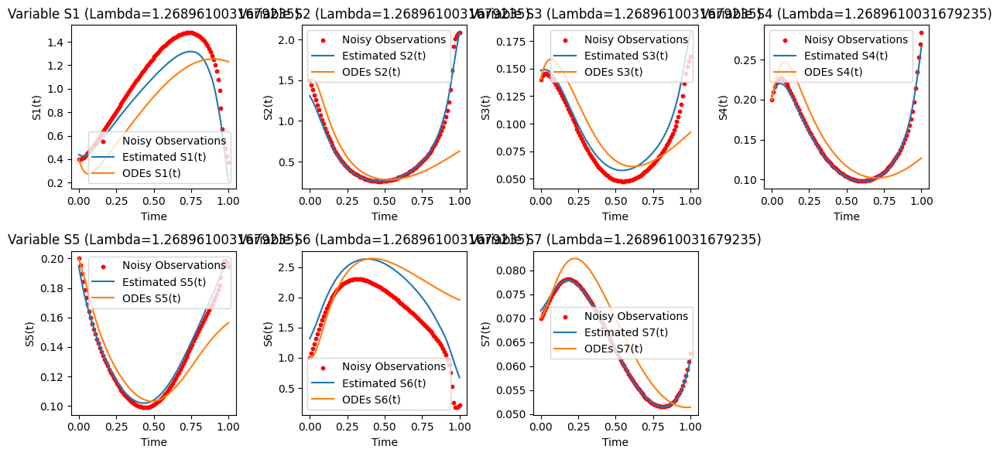

Lambda: 0.8531678524172814; [2.32254146e+00 7.46436781e+02 7.36701657e+00 1.33922593e+01
 9.82237848e+01 8.65575156e-01 1.20620014e+01 1.78380623e+00
 1.31098128e+01 1.70951541e+01 3.87633184e-01 9.74479478e-02
 8.47628409e-01 4.45843894e+00]


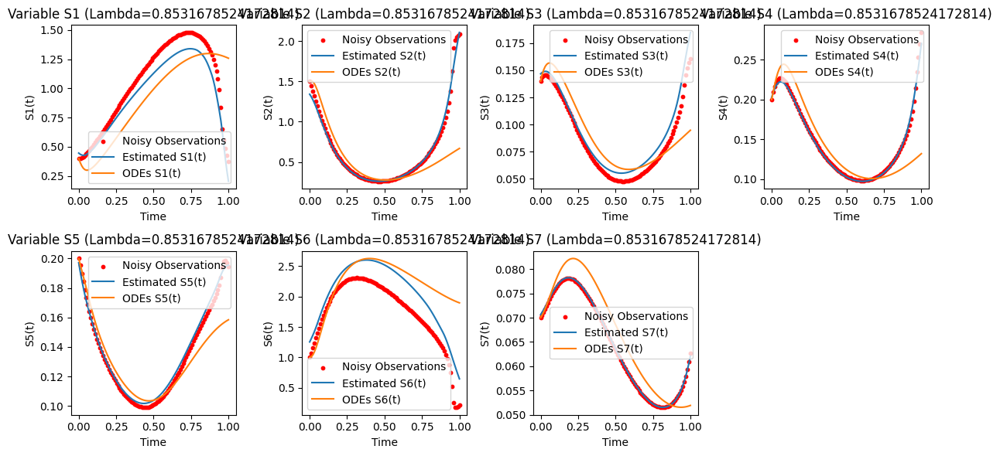

Lambda: 0.5736152510448681; [2.42205413e+00 7.46440720e+02 7.46706483e+00 1.35805568e+01
 1.00227372e+02 8.89404516e-01 1.27787551e+01 1.79871806e+00
 1.39342111e+01 1.70951541e+01 3.83934446e-01 9.43124398e-02
 8.61299726e-01 4.52206237e+00]


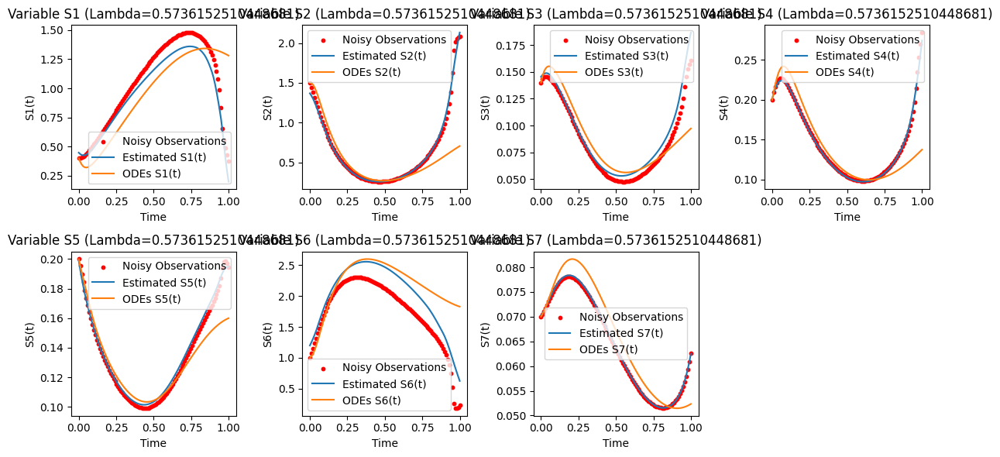

Lambda: 0.38566204211634725; [2.50461866e+00 7.46444530e+02 7.52315582e+00 1.36741147e+01
 1.01849859e+02 9.17366003e-01 1.33183535e+01 1.81040443e+00
 1.44905734e+01 1.70951541e+01 3.78880258e-01 9.17994671e-02
 8.72801273e-01 4.58142190e+00]


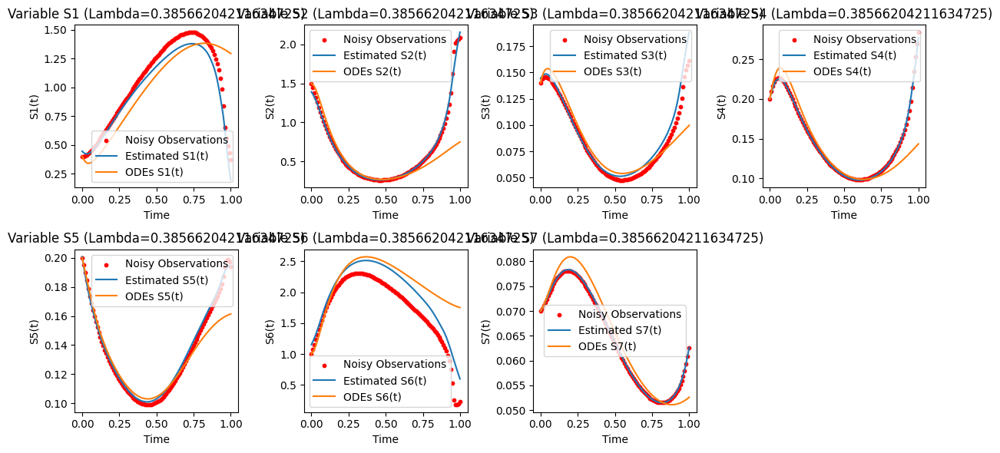

Lambda: 0.2592943797404667; [2.56739097e+00 7.46447789e+02 7.54829498e+00 1.37334124e+01
 1.03137951e+02 9.49875942e-01 1.36863168e+01 1.82056622e+00
 1.48339937e+01 1.70951541e+01 3.72472665e-01 8.98508199e-02
 8.81652802e-01 4.62706307e+00]


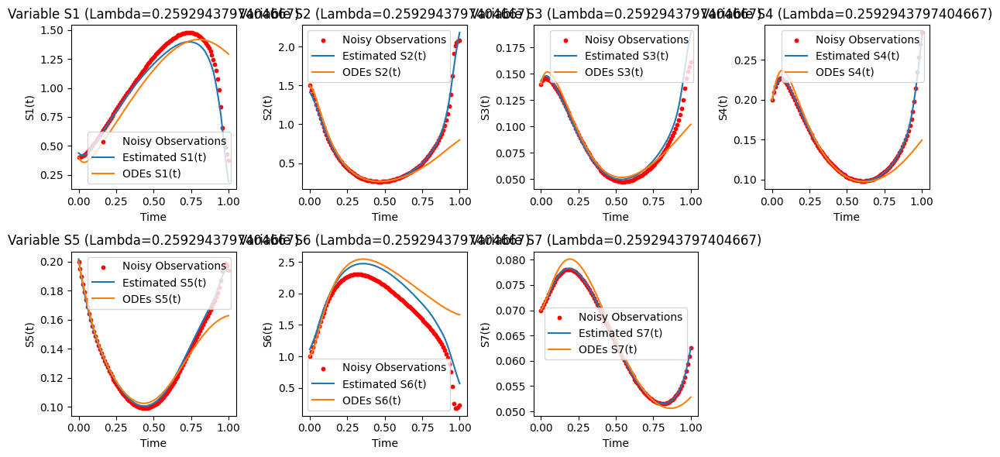

Lambda: 0.1743328822199989; [2.60556318e+00 7.46448797e+02 7.54846433e+00 1.38181638e+01
 1.04128944e+02 9.87804872e-01 1.38688822e+01 1.82647340e+00
 1.49924583e+01 1.70951541e+01 3.64644037e-01 8.85395534e-02
 8.87538496e-01 4.64612032e+00]


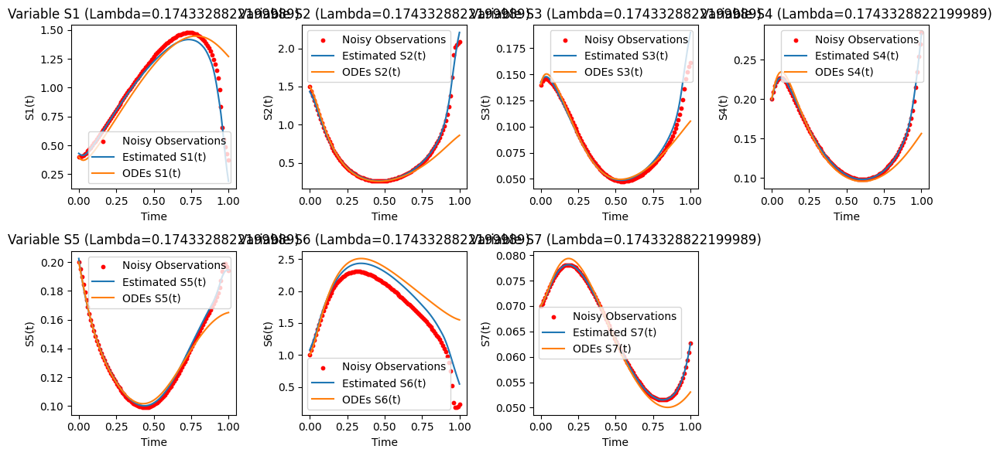

Lambda: 0.11721022975334805; [2.61925490e+00 7.46443223e+02 7.53766114e+00 1.40046236e+01
 1.04861509e+02 1.03334435e+00 1.38822356e+01 1.82899267e+00
 1.50093636e+01 1.70951541e+01 3.55467347e-01 8.79559310e-02
 8.89878502e-01 4.62350577e+00]


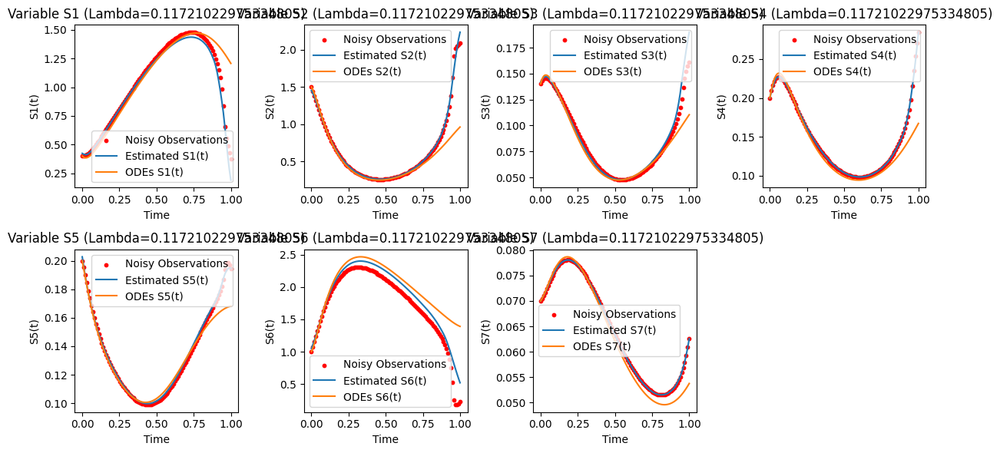

Lambda: 0.07880462815669913; [2.61866401e+00 7.46428032e+02 7.51711041e+00 1.43632120e+01
 1.05236553e+02 1.08887882e+00 1.38165955e+01 1.82935504e+00
 1.49910644e+01 1.70951541e+01 3.45086642e-01 8.78205943e-02
 8.90123626e-01 4.55044224e+00]


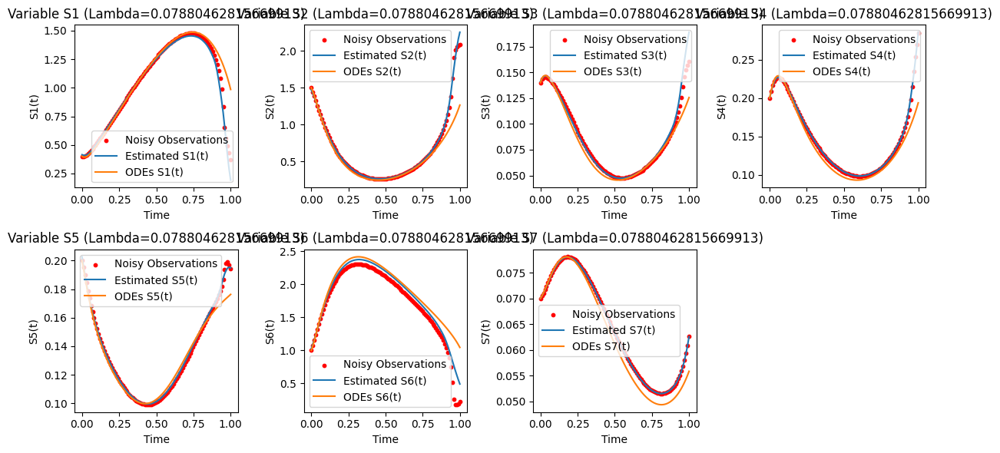

Lambda: 0.0529831690628371; [2.61152962e+00 7.46362319e+02 7.48093637e+00 1.49134975e+01
 1.05390262e+02 1.16495971e+00 1.36740594e+01 1.82900266e+00
 1.49429387e+01 1.70951541e+01 3.33611132e-01 8.80524554e-02
 8.89871866e-01 4.43065451e+00]


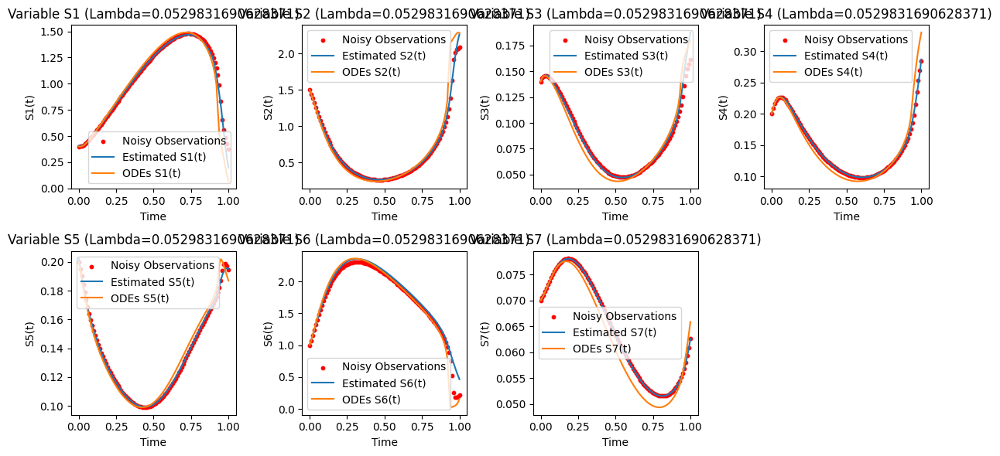

Lambda: 0.03562247890262444; [2.59843025e+00 7.46233249e+02 7.43668767e+00 1.55667742e+01
 1.05383044e+02 1.26718510e+00 1.34731236e+01 1.82857387e+00
 1.48701172e+01 1.70951541e+01 3.21071399e-01 8.85464674e-02
 8.89248393e-01 4.29050752e+00]


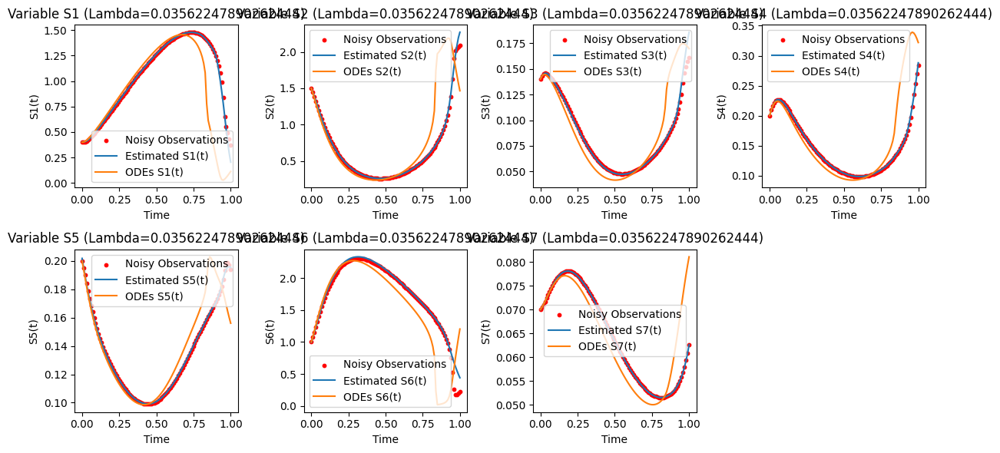

Lambda: 0.02395026619987486; [2.56698450e+00 7.45948066e+02 7.35507987e+00 1.61834817e+01
 1.05325209e+02 1.44265844e+00 1.31271281e+01 1.82776157e+00
 1.47189685e+01 1.70951541e+01 3.07122285e-01 8.95246133e-02
 8.90371313e-01 4.15634696e+00]


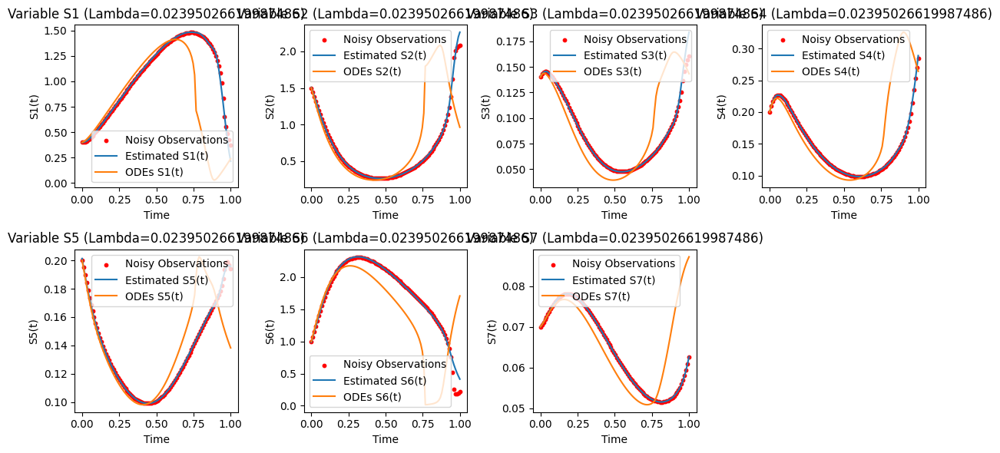

Lambda: 0.01610262027560939; [2.51876463e+00 7.45602697e+02 7.26790121e+00 1.65697201e+01
 1.05151402e+02 1.67038739e+00 1.27394804e+01 1.82687047e+00
 1.45321793e+01 1.70951541e+01 2.91411211e-01 9.07262280e-02
 8.90905763e-01 4.06133974e+00]


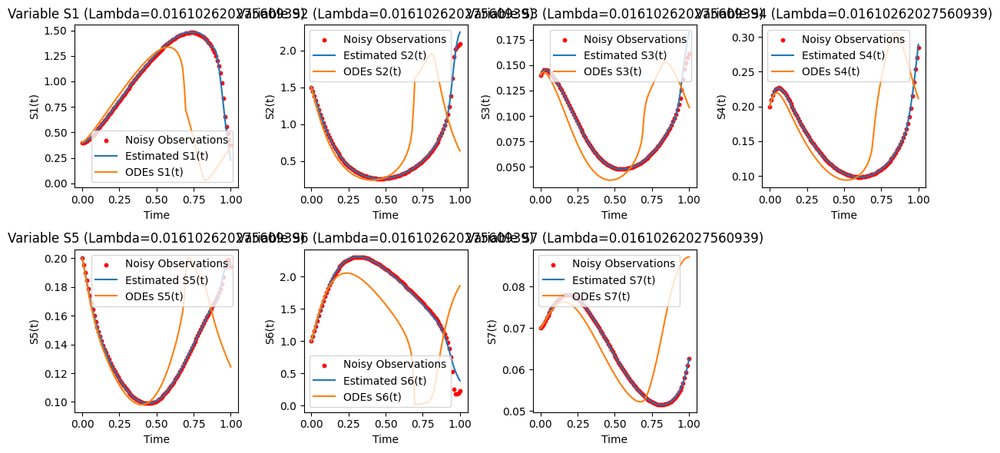

Lambda: 0.010826367338740546; [2.42922319e+00 7.45108774e+02 7.14588148e+00 1.66329656e+01
 1.04821213e+02 2.01178812e+00 1.22078118e+01 1.82575035e+00
 1.42471030e+01 1.70951541e+01 2.73143448e-01 9.25449273e-02
 8.91411895e-01 4.00864661e+00]


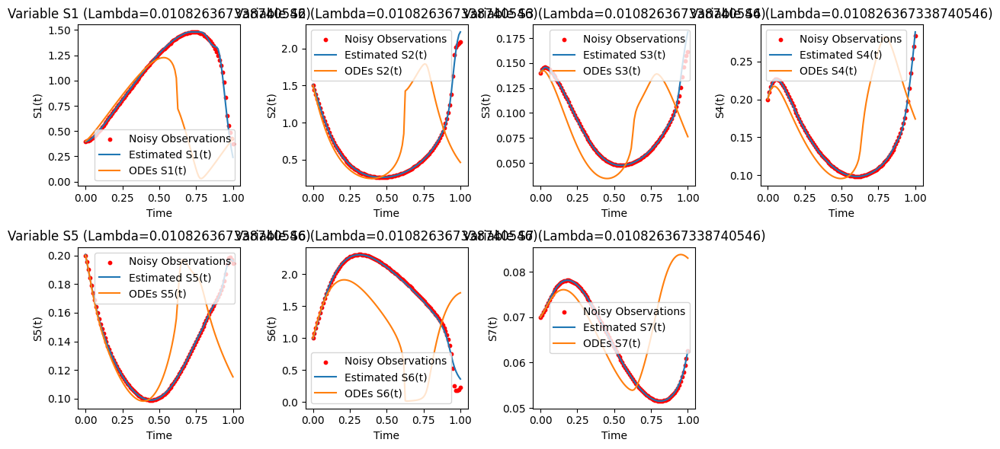

Lambda: 0.007278953843983154; [2.25433662e+00 7.44376426e+02 6.94531121e+00 1.63773794e+01
 1.04050725e+02 2.49176377e+00 1.13955643e+01 1.82414205e+00
 1.37107785e+01 1.70951541e+01 2.51623564e-01 9.61186502e-02
 8.92444400e-01 3.98260381e+00]


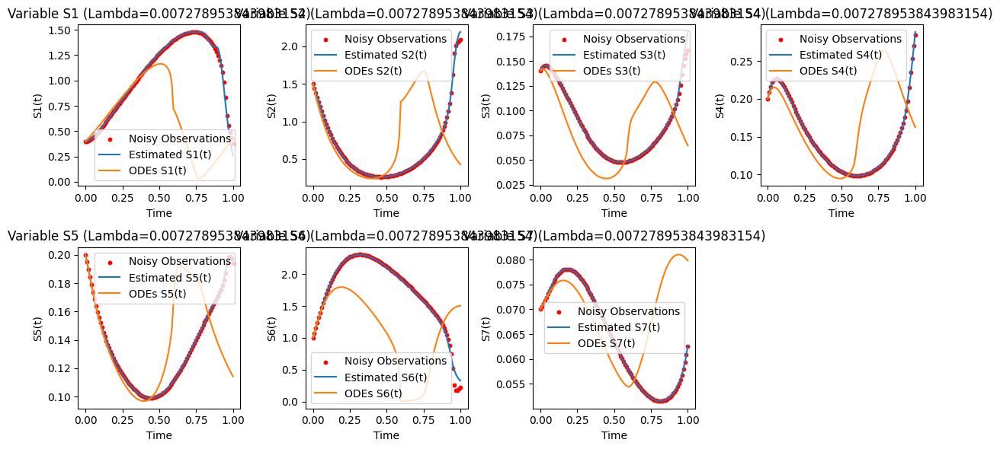

Lambda: 0.004893900918477494; [2.07554187e+00 7.43772408e+02 6.76262244e+00 1.59371305e+01
 1.03065851e+02 2.94264854e+00 1.06608639e+01 1.82281235e+00
 1.31463412e+01 1.70951541e+01 2.27630825e-01 1.00179981e-01
 8.90408883e-01 3.98201379e+00]


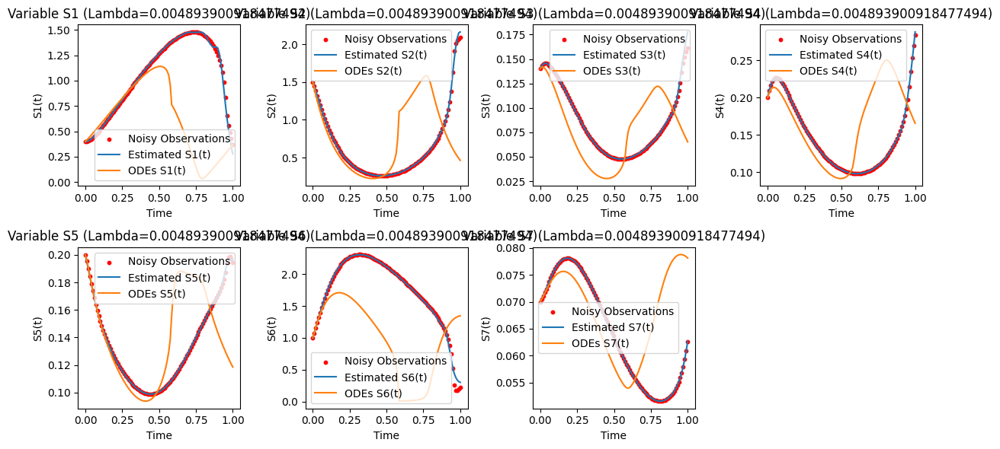

Lambda: 0.0032903445623126675; [1.92010149e+00 7.43333648e+02 6.61471273e+00 1.54315312e+01
 1.02010874e+02 3.33742863e+00 1.00533434e+01 1.82180816e+00
 1.26279280e+01 1.70951541e+01 2.02743670e-01 1.04222467e-01
 8.84881012e-01 3.99116017e+00]


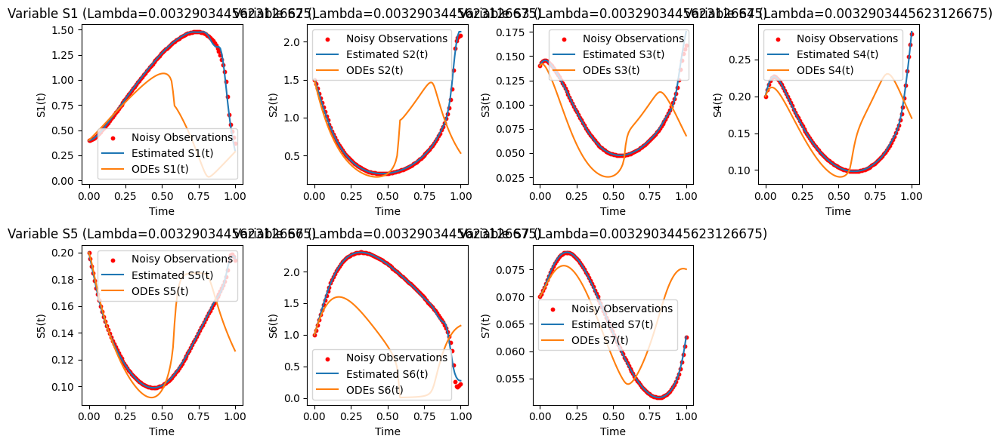

Lambda: 0.00221221629107045; [1.65581010e+00 7.42630510e+02 6.37663318e+00 1.43436405e+01
 9.94678901e+01 3.80221367e+00 8.97183444e+00 1.81991561e+00
 1.15422751e+01 1.70951541e+01 1.77842454e-01 1.13875817e-01
 8.71398413e-01 4.03659313e+00]


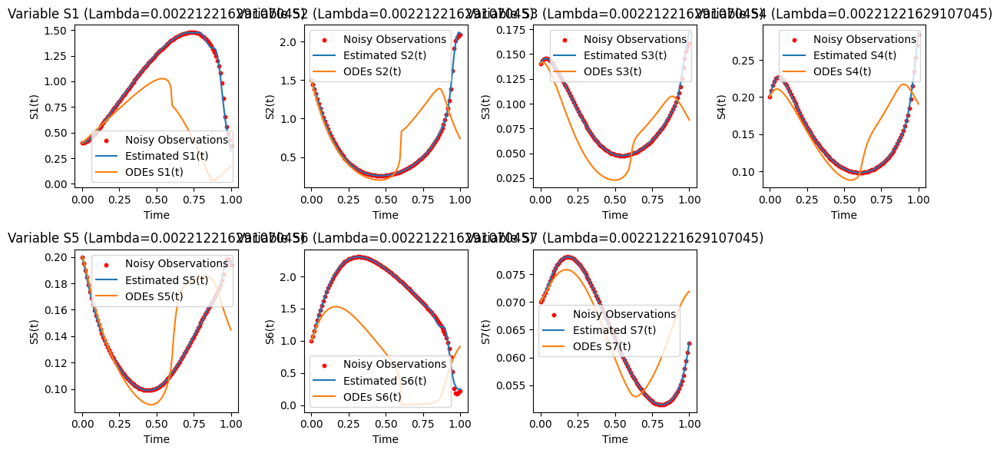

Lambda: 0.0014873521072935117; [1.43541447e+00 7.41951967e+02 6.17399657e+00 1.31915916e+01
 9.62582317e+01 4.03862860e+00 7.94046203e+00 1.81774802e+00
 1.03441488e+01 1.70951541e+01 1.56027107e-01 1.26837035e-01
 8.50871323e-01 4.09239849e+00]


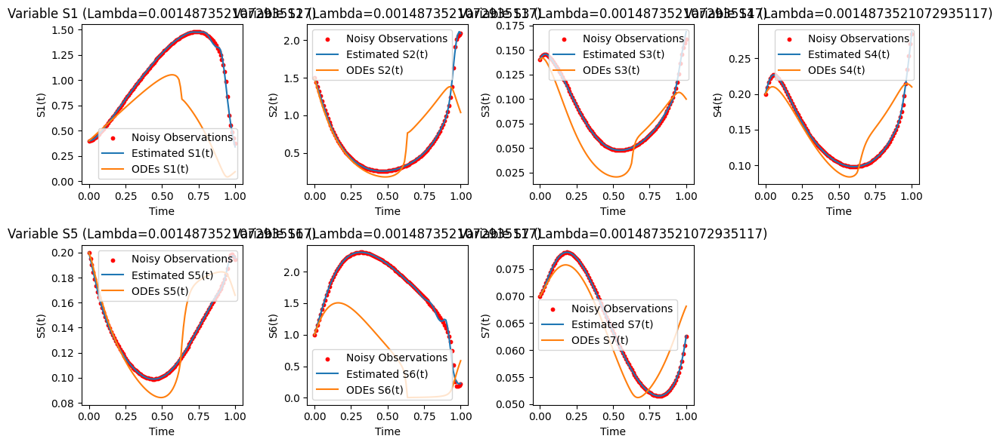

Lambda: 0.001; [1.37757873e+00 7.41728239e+02 6.12043336e+00 1.28327507e+01
 9.51465776e+01 4.12337656e+00 7.63678339e+00 1.81702718e+00
 9.97393671e+00 1.70951541e+01 1.40585108e-01 1.31401131e-01
 8.39152418e-01 4.09682396e+00]


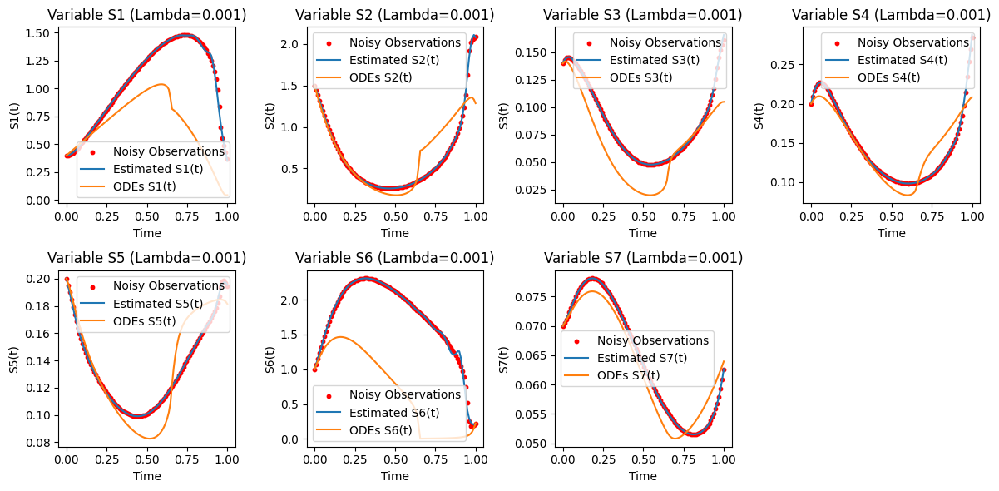

Lambda: 0.001; [1.28168850e+00 7.41361684e+02 6.04034489e+00 1.21452987e+01
 9.29029012e+01 4.23523692e+00 7.08738844e+00 1.81555494e+00
 9.28666062e+00 1.70951541e+01 1.29994923e-01 1.40908853e-01
 8.19994816e-01 4.13087197e+00]


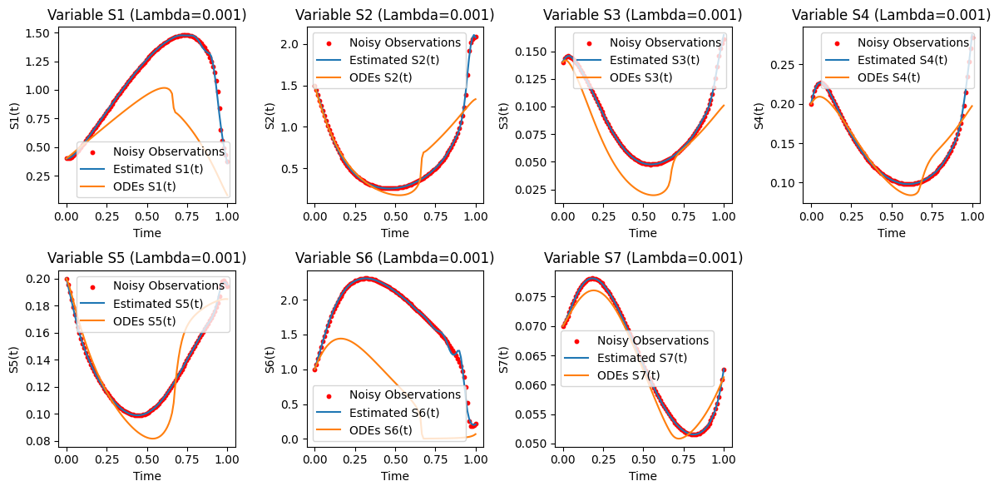

Lambda: 0.0014873521072935117; [1.20115904e+00 7.41028344e+02 5.97578466e+00 1.15345876e+01
 9.06912932e+01 4.24832039e+00 6.59979894e+00 1.81397322e+00
 8.65239177e+00 1.70951541e+01 1.25097028e-01 1.51047380e-01
 8.02072786e-01 4.16505662e+00]


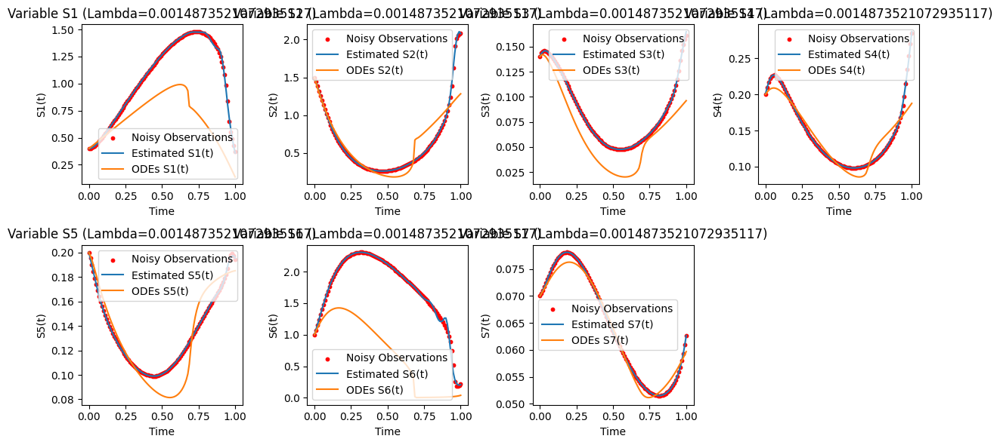

Lambda: 0.00221221629107045; [1.12468669e+00 7.40687734e+02 5.91223113e+00 1.09464447e+01
 8.83545435e+01 4.20609292e+00 6.12749457e+00 1.81210594e+00
 8.01731784e+00 1.70951541e+01 1.23190117e-01 1.62846277e-01
 7.84444807e-01 4.20039232e+00]


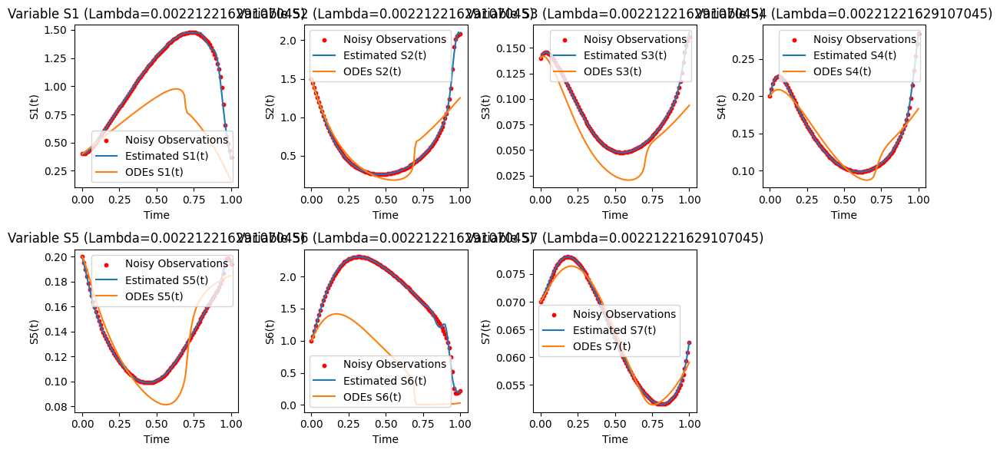

Lambda: 0.0032903445623126675; [1.08309807e+00 7.40491351e+02 5.87525633e+00 1.06278585e+01
 8.69971136e+01 4.16249896e+00 5.86963134e+00 1.81091397e+00
 7.66330371e+00 1.70951541e+01 1.22842976e-01 1.70310451e-01
 7.74724897e-01 4.21981492e+00]


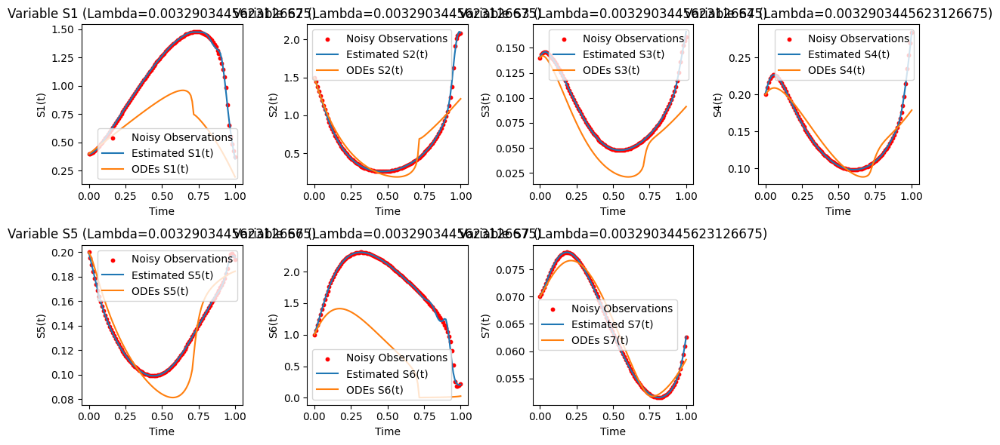

Lambda: 0.004893900918477494; [1.04077779e+00 7.40285243e+02 5.83396533e+00 1.03098838e+01
 8.55717469e+01 4.10207636e+00 5.60941852e+00 1.80957455e+00
 7.30216447e+00 1.70951541e+01 1.22945876e-01 1.78696493e-01
 7.65012696e-01 4.23909616e+00]


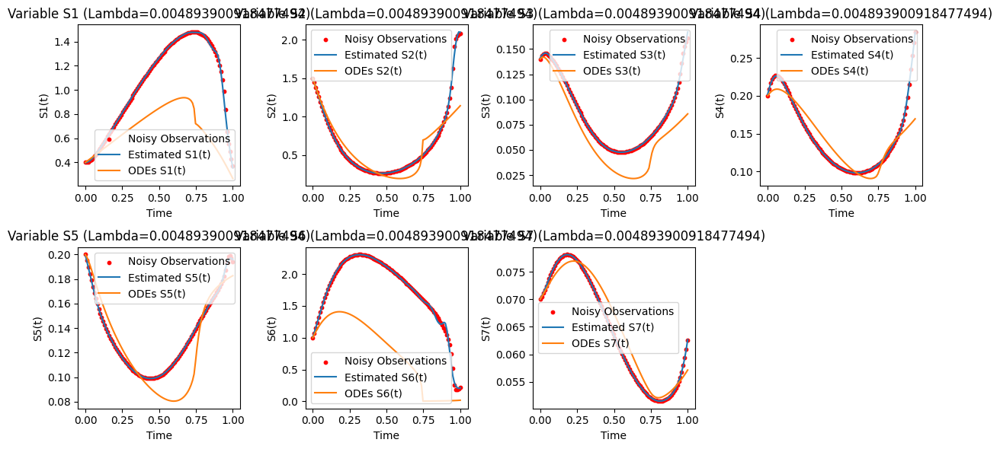

Lambda: 0.007278953843983154; [9.60346896e-01 7.39864365e+02 5.73968322e+00 9.70016341e+00
 8.26987748e+01 3.95343729e+00 5.11654394e+00 1.80658827e+00
 6.60828406e+00 1.70951541e+01 1.22752765e-01 1.97235690e-01
 7.46786536e-01 4.27568138e+00]


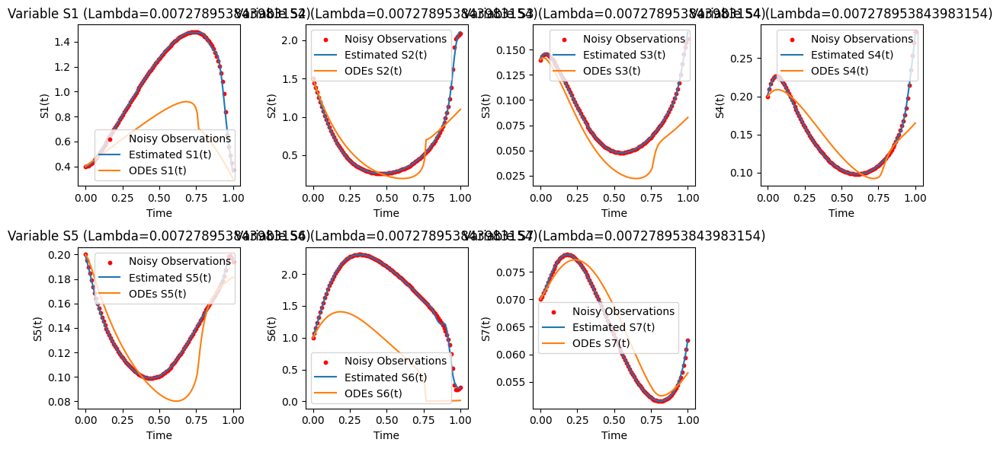

Lambda: 0.010826367338740546; [9.13783762e-01 7.39597448e+02 5.67206277e+00 9.34479411e+00
 8.09170733e+01 3.84804598e+00 4.82924742e+00 1.80451642e+00
 6.20178173e+00 1.70951541e+01 1.23379413e-01 2.10105262e-01
 7.36740795e-01 4.29696658e+00]


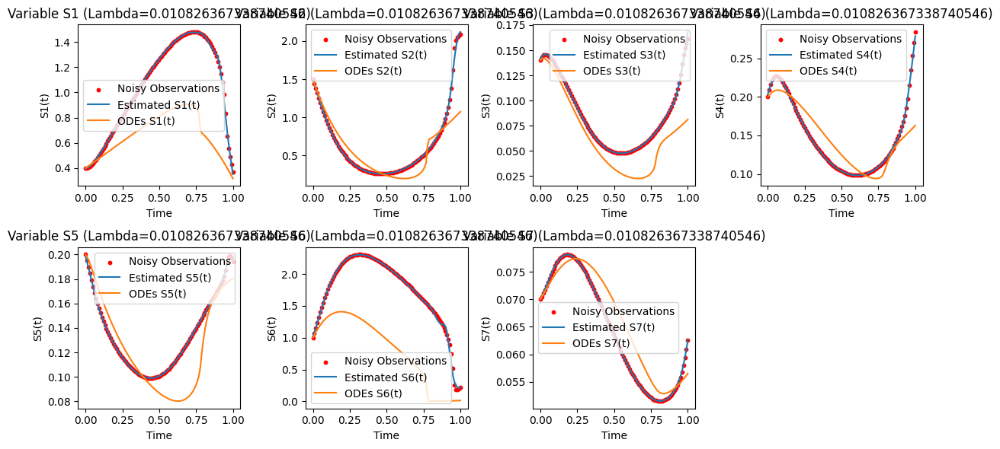

Lambda: 0.01610262027560939; [8.81001051e-01 7.39399198e+02 5.61711516e+00 9.10183184e+00
 7.96245212e+01 3.76157046e+00 4.62613588e+00 1.80292598e+00
 5.91785777e+00 1.70951541e+01 1.24616943e-01 2.20306853e-01
 7.30048881e-01 4.31085607e+00]


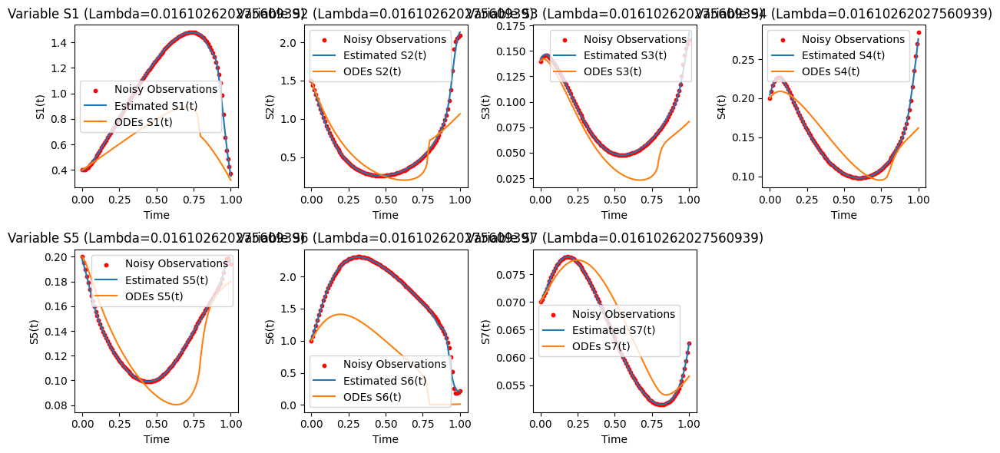

Lambda: 0.02395026619987486; [8.57832705e-01 7.39250693e+02 5.57224410e+00 8.93810113e+00
 7.86961524e+01 3.68981166e+00 4.48031812e+00 1.80176727e+00
 5.71950381e+00 1.70951541e+01 1.26374926e-01 2.28263395e-01
 7.25640008e-01 4.31860702e+00]


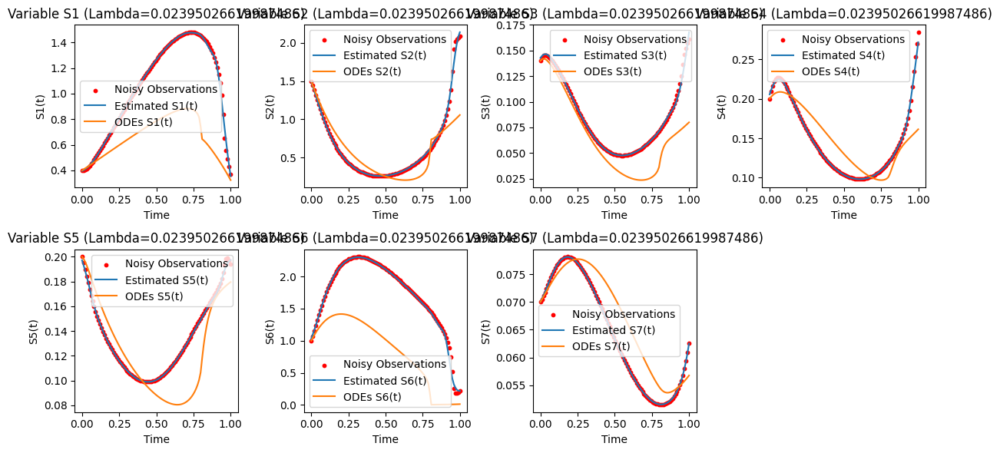

Lambda: 0.03562247890262444; [8.35387906e-01 7.39096366e+02 5.52048778e+00 8.78903188e+00
 7.77743709e+01 3.60703729e+00 4.33295620e+00 1.80068725e+00
 5.52721285e+00 1.70951541e+01 1.28500772e-01 2.36683678e-01
 7.21729683e-01 4.32232194e+00]


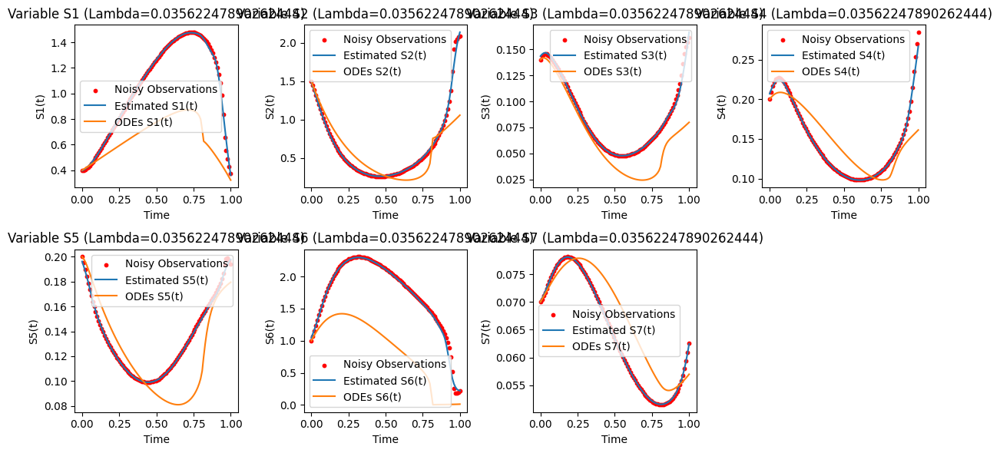

Lambda: 0.0529831690628371; [8.18377130e-01 7.38966067e+02 5.47191005e+00 8.67717600e+00
 7.70298086e+01 3.52852721e+00 4.20988576e+00 1.79991430e+00
 5.37613756e+00 1.70951541e+01 1.31045465e-01 2.43996384e-01
 7.18843428e-01 4.32209220e+00]


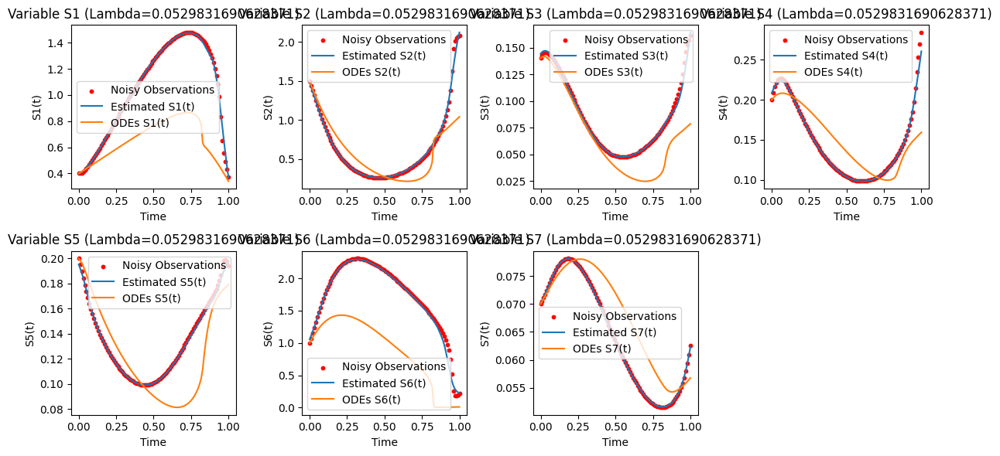

Lambda: 0.07880462815669913; [7.98690259e-01 7.38788641e+02 5.39523310e+00 8.53416928e+00
 7.60394211e+01 3.40831777e+00 4.03930025e+00 1.79924243e+00
 5.18106814e+00 1.70951541e+01 1.33824162e-01 2.54005256e-01
 7.16061320e-01 4.31865160e+00]


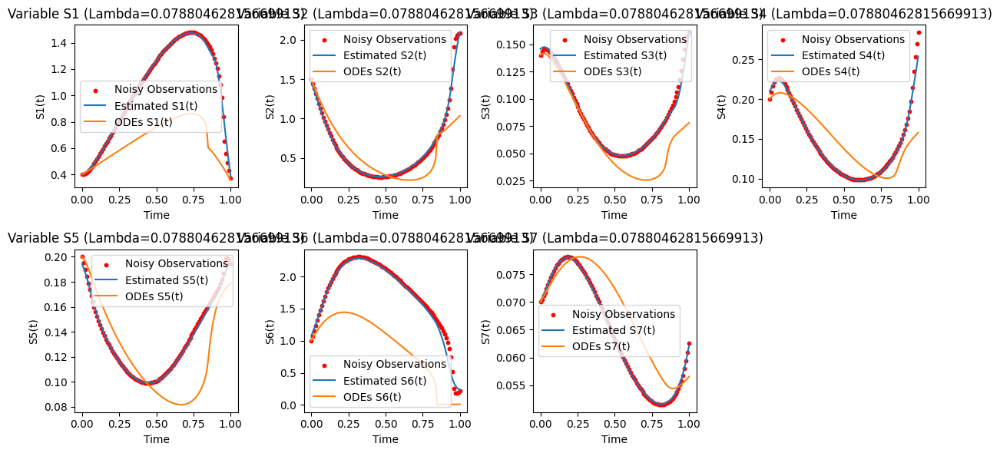

Lambda: 0.11721022975334805; [7.86267165e-01 7.38629706e+02 5.31431200e+00 8.41597997e+00
 7.51838843e+01 3.28686077e+00 3.88363850e+00 1.79918421e+00
 5.01824680e+00 1.70951541e+01 1.37022801e-01 2.63229364e-01
 7.14861086e-01 4.31303690e+00]


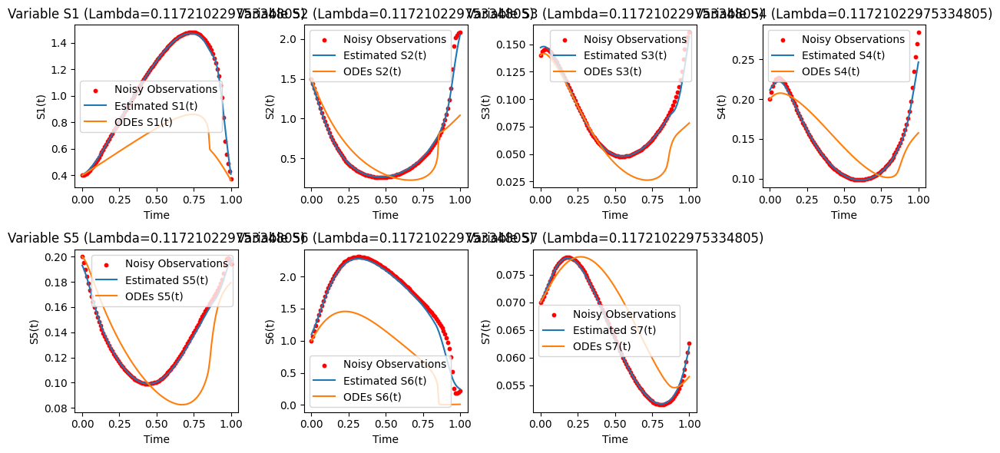

Lambda: 0.1743328822199989; [7.83238396e-01 7.38526218e+02 5.25053019e+00 8.35001479e+00
 7.46594449e+01 3.18613797e+00 3.77792296e+00 1.80163538e+00
 4.92125033e+00 1.70951541e+01 1.40694914e-01 2.69700307e-01
 7.15278800e-01 4.30670557e+00]


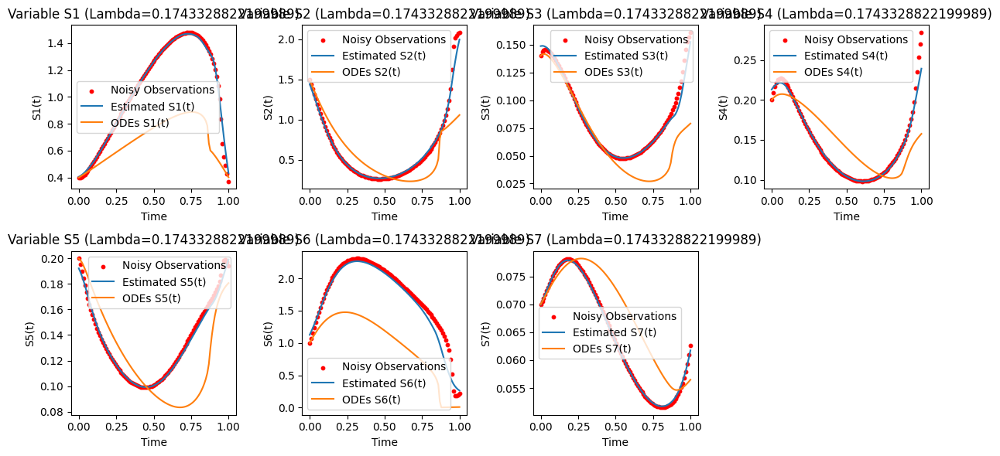

Lambda: 0.2592943797404667; [8.21249291e-01 7.38432599e+02 5.17553856e+00 8.30155437e+00
 7.42366945e+01 3.05960451e+00 3.67641860e+00 1.80827661e+00
 4.84291748e+00 1.70951541e+01 1.44674565e-01 2.75828337e-01
 7.18122418e-01 4.29924614e+00]


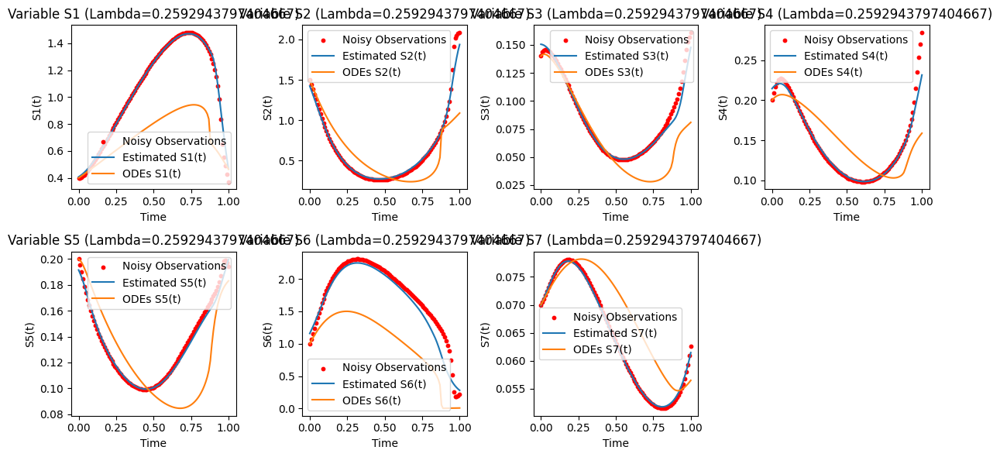

Lambda: 0.38566204211634725; [8.99023312e-01 7.38363340e+02 5.10430803e+00 8.27417858e+00
 7.39760990e+01 2.92997205e+00 3.59515124e+00 1.81855229e+00
 4.79370627e+00 1.70951541e+01 1.48880077e-01 2.80665570e-01
 7.22600448e-01 4.29238862e+00]


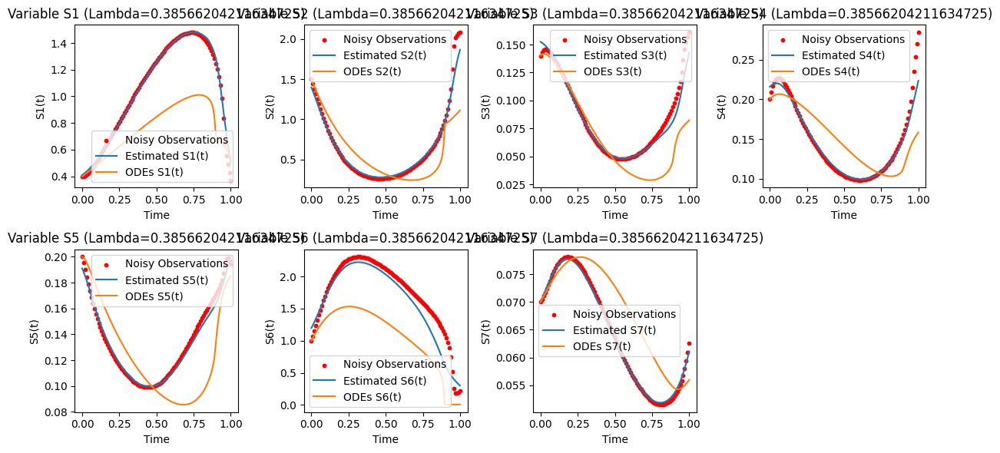

Lambda: 0.5736152510448681; [9.87224130e-01 7.38303871e+02 5.02423072e+00 8.25451711e+00
 7.38076553e+01 2.77904130e+00 3.51752561e+00 1.83536842e+00
 4.75994601e+00 1.70951541e+01 1.53280575e-01 2.85175307e-01
 7.29389440e-01 4.28622025e+00]


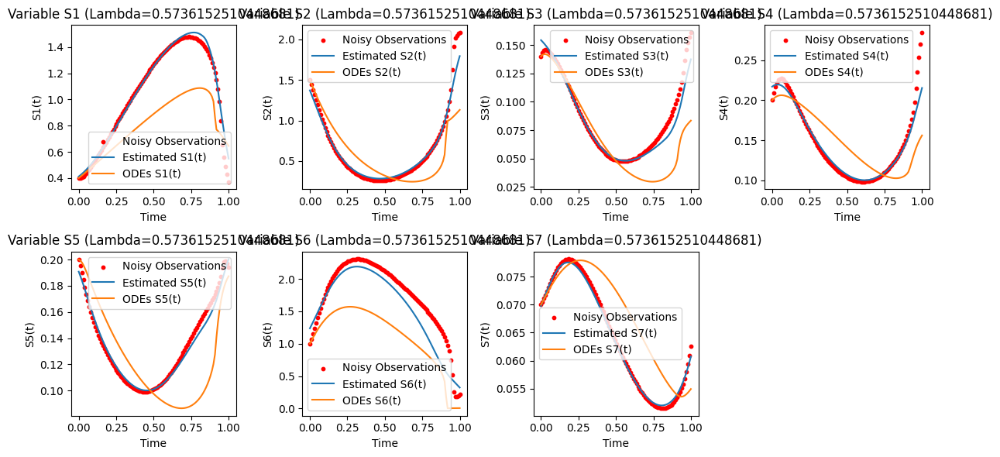

Lambda: 0.8531678524172814; [1.08181636e+00 7.38257472e+02 4.94671095e+00 8.25166473e+00
 7.37609861e+01 2.62061022e+00 3.45515338e+00 1.85838736e+00
 4.74510883e+00 1.70951541e+01 1.57847800e-01 2.88933760e-01
 7.37853720e-01 4.28007110e+00]


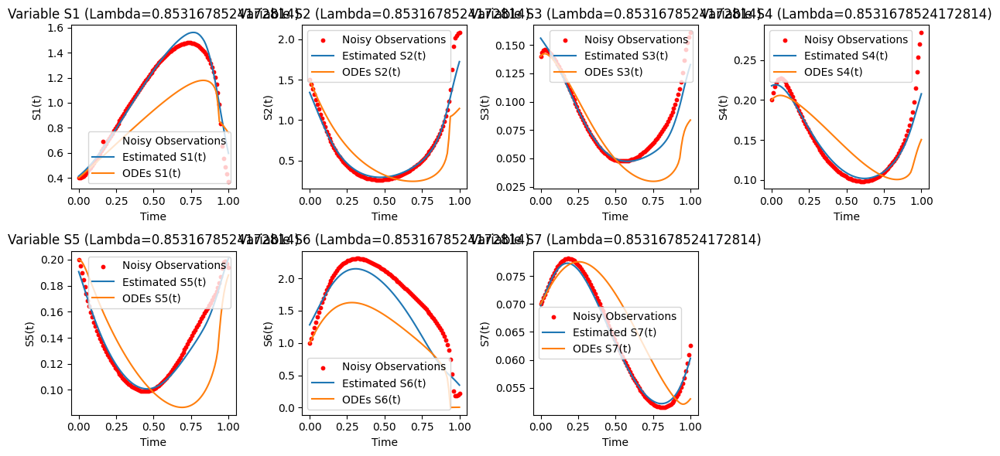

Lambda: 1.2689610031679235; [1.18620005e+00 7.38219515e+02 4.87786237e+00 8.36980922e+00
 7.47282896e+01 2.45074349e+00 3.41121684e+00 1.89273378e+00
 4.77557679e+00 1.70951541e+01 1.62787536e-01 2.90890301e-01
 7.53519170e-01 4.26796383e+00]


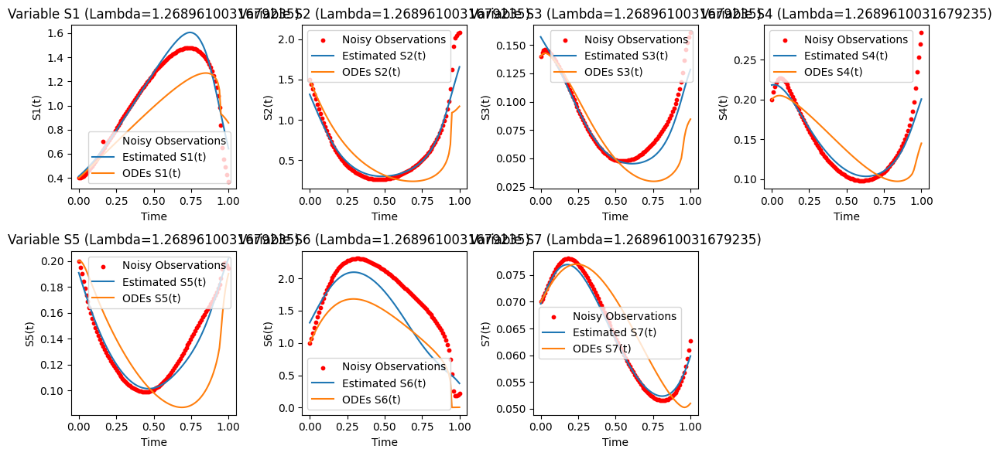

Lambda: 1.8873918221350976; [1.29503306e+00 7.38196736e+02 4.83929948e+00 8.61679080e+00
 7.65766840e+01 2.31790076e+00 3.39715252e+00 1.94042541e+00
 4.90519655e+00 1.70951541e+01 1.67756065e-01 2.88635527e-01
 7.73912926e-01 4.24929089e+00]


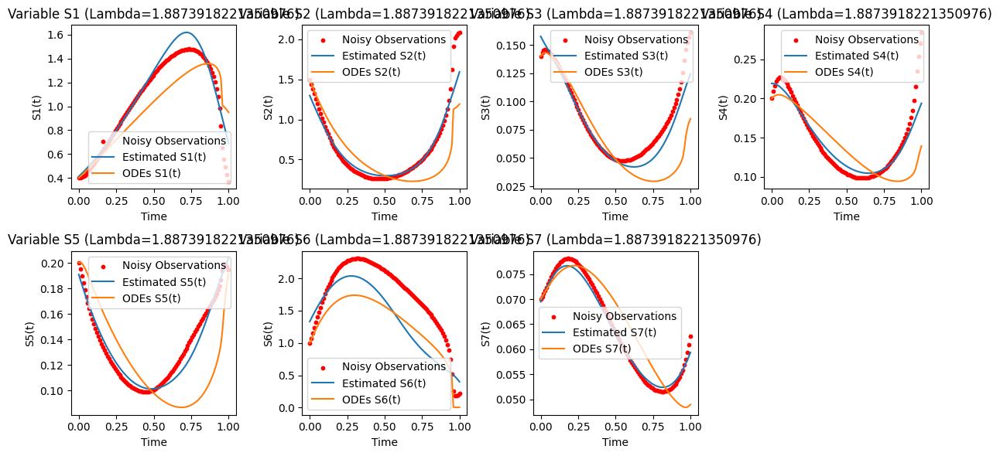

Lambda: 2.8072162039411785; [1.40034810e+00 7.38180229e+02 4.81568484e+00 8.92870070e+00
 7.87825840e+01 2.20369002e+00 3.42246353e+00 1.98887342e+00
 5.06818228e+00 1.70951541e+01 1.72313263e-01 2.85286247e-01
 7.96359470e-01 4.22610997e+00]


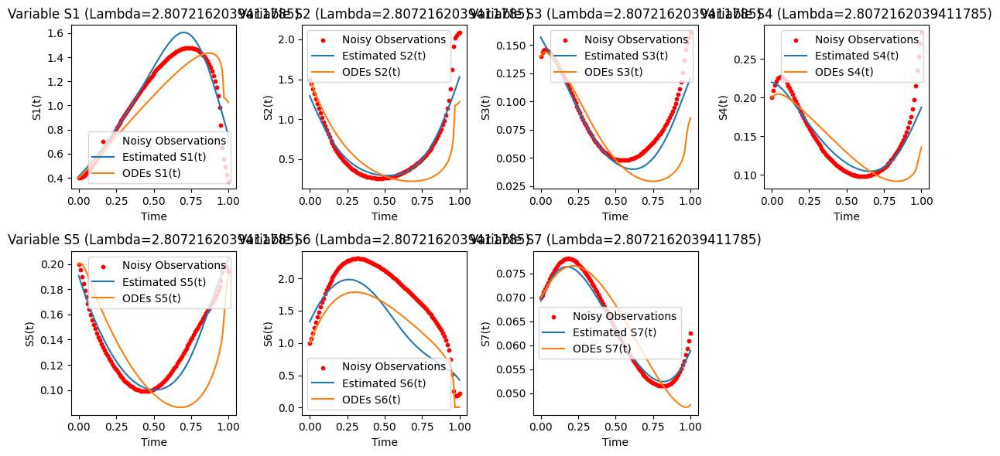

Lambda: 4.175318936560405; [1.49366723e+00 7.38169374e+02 4.80185598e+00 9.24351254e+00
 8.07547458e+01 2.11836331e+00 3.53128938e+00 2.03422295e+00
 5.25715585e+00 1.70951541e+01 1.76152974e-01 2.81219729e-01
 8.17668652e-01 4.20312667e+00]


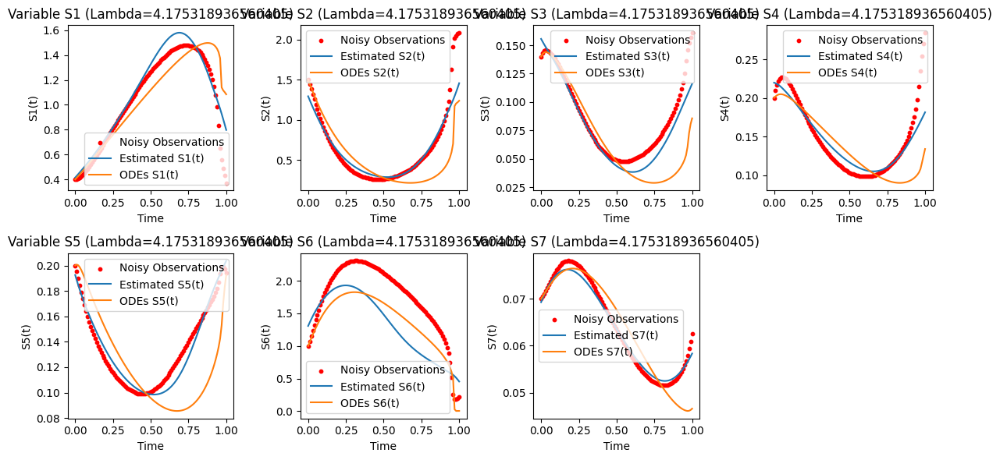

Lambda: 6.2101694189156165; [1.57385233e+00 7.38161686e+02 4.78960147e+00 9.52655562e+00
 8.24974854e+01 2.05491970e+00 3.63720317e+00 2.06991788e+00
 5.40660812e+00 1.70951541e+01 1.79277527e-01 2.77625047e-01
 8.36545714e-01 4.18192163e+00]


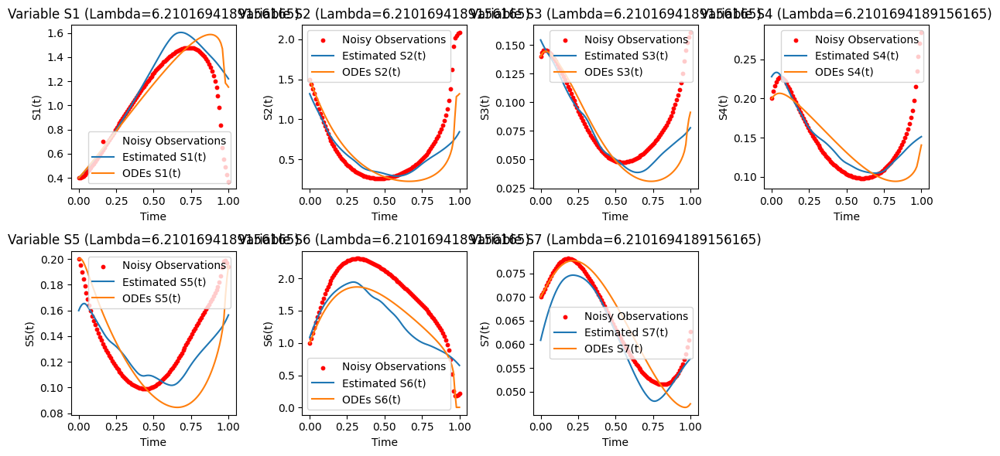

Lambda: 9.236708571873866; [1.71351414e+00 7.38154688e+02 4.76606012e+00 9.44822376e+00
 8.23855598e+01 1.94460390e+00 3.92045055e+00 2.33765756e+00
 5.32362632e+00 1.70951541e+01 1.87810855e-01 3.17244029e-01
 8.46622181e-01 4.22208400e+00]


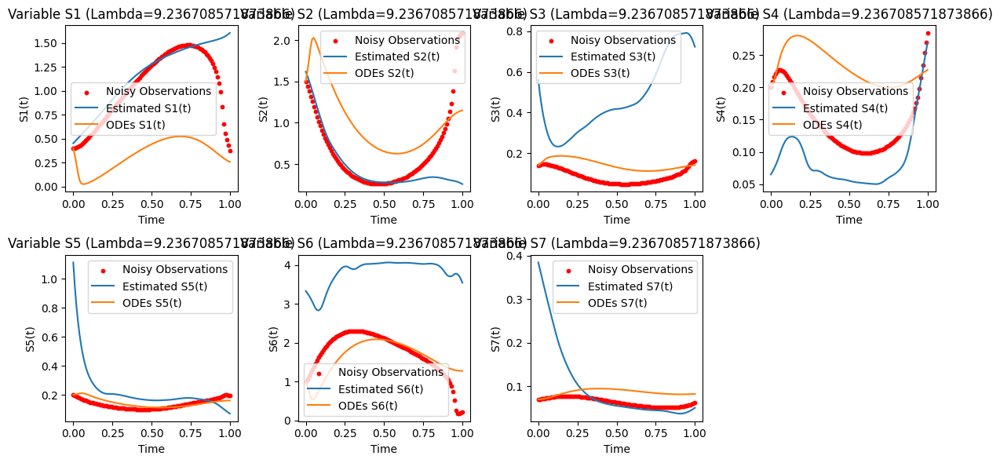

Lambda: 13.738237958832638; [1.88847423e+00 7.38155924e+02 5.86518332e+00 9.42981869e+00
 8.32137290e+01 1.74704320e+00 5.25779209e+00 2.57718321e+00
 5.19569055e+00 1.70951541e+01 4.16757946e-01 3.11116421e-01
 7.57601131e-01 4.22751052e+00]


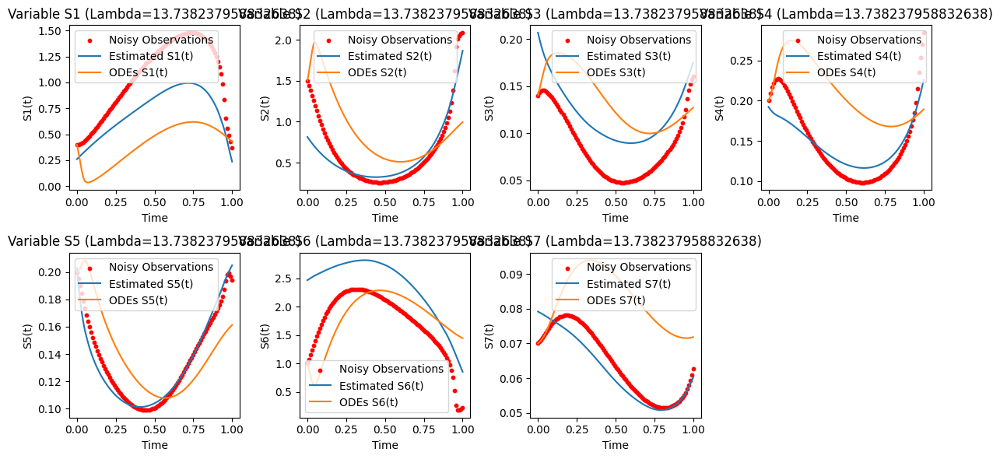

Lambda: 20.43359717856944; [1.85280156e+00 7.38141899e+02 6.05130256e+00 9.85436917e+00
 8.58499115e+01 1.44923578e+00 5.92840935e+00 2.67277963e+00
 6.23314980e+00 1.70951541e+01 4.17220859e-01 2.79343351e-01
 7.71934164e-01 4.26191443e+00]


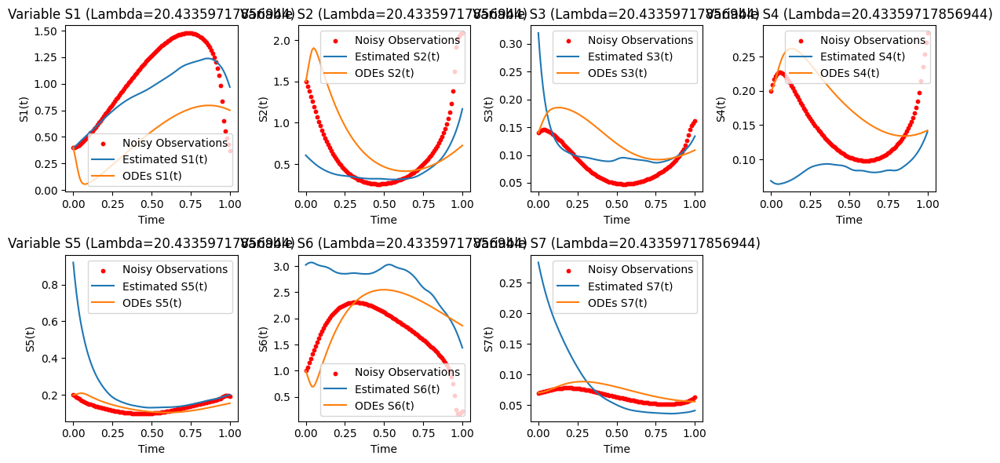

Lambda: 30.39195382313201; [1.86720205e+00 7.38136921e+02 5.89552346e+00 1.02969813e+01
 9.23952308e+01 1.14349721e+00 5.84023021e+00 3.09780156e+00
 6.76440915e+00 1.70951541e+01 4.15435892e-01 2.85050499e-01
 8.23854889e-01 4.30503323e+00]


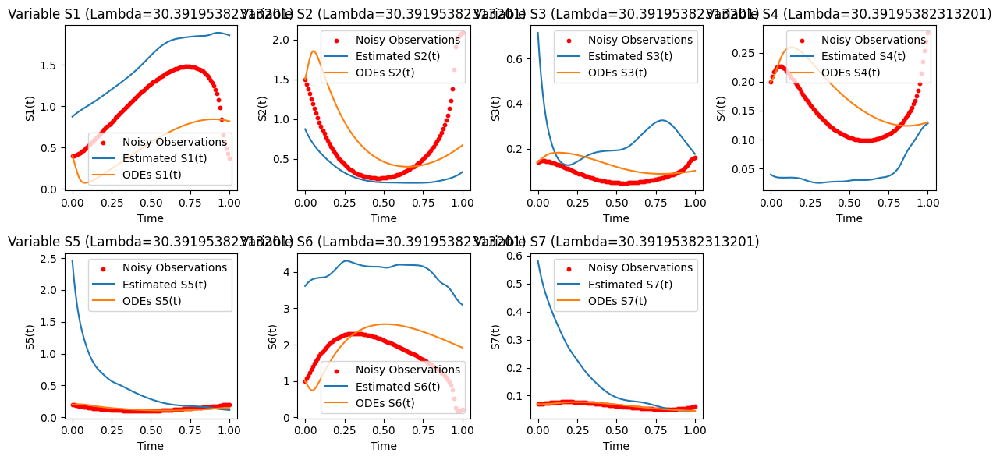

Lambda: 45.2035365636025; [1.85080991e+00 7.38134795e+02 5.83256356e+00 1.02676415e+01
 9.22664218e+01 1.08330291e+00 6.03958559e+00 2.85971854e+00
 6.76463864e+00 1.70951541e+01 4.07907547e-01 2.07546782e-01
 8.16121968e-01 4.30466251e+00]


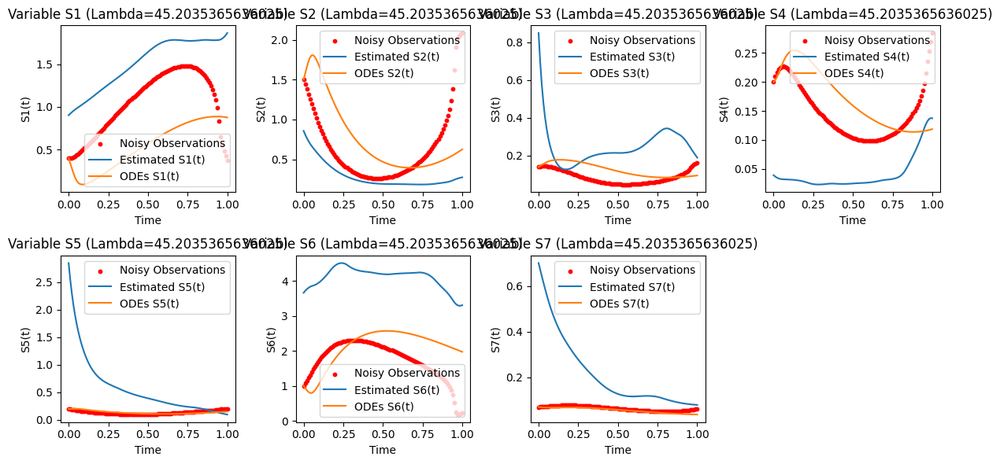

Lambda: 67.23357536499334; [1.83571692e+00 7.38132730e+02 5.79261748e+00 1.02726130e+01
 9.22260123e+01 1.03592718e+00 6.05362118e+00 2.64780613e+00
 6.76960726e+00 1.70951541e+01 4.00612187e-01 1.49727505e-01
 8.07999549e-01 4.30293731e+00]


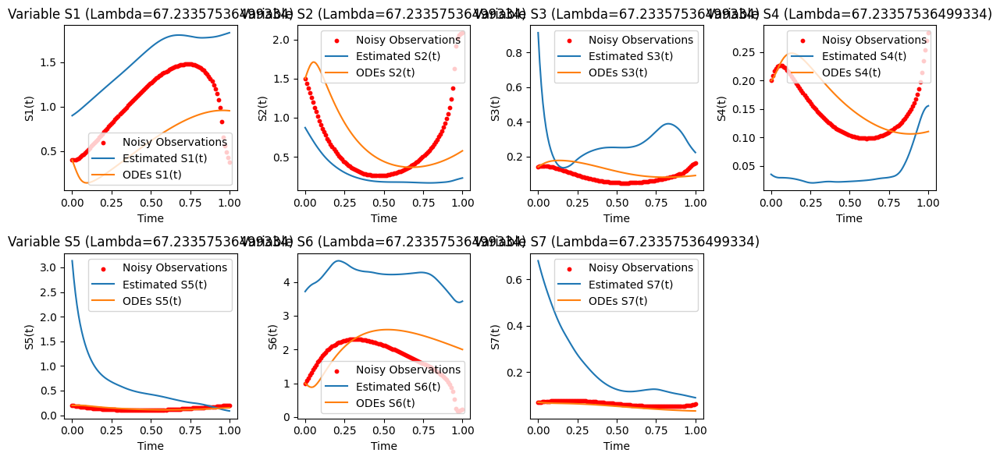

Lambda: 100.0; [1.82527974e+00 7.38129275e+02 5.92385071e+00 1.02962062e+01
 9.22318582e+01 1.00790709e+00 6.05522829e+00 2.53862731e+00
 6.76405292e+00 1.70951541e+01 3.89636703e-01 1.23626809e-01
 8.08212763e-01 4.30303128e+00]


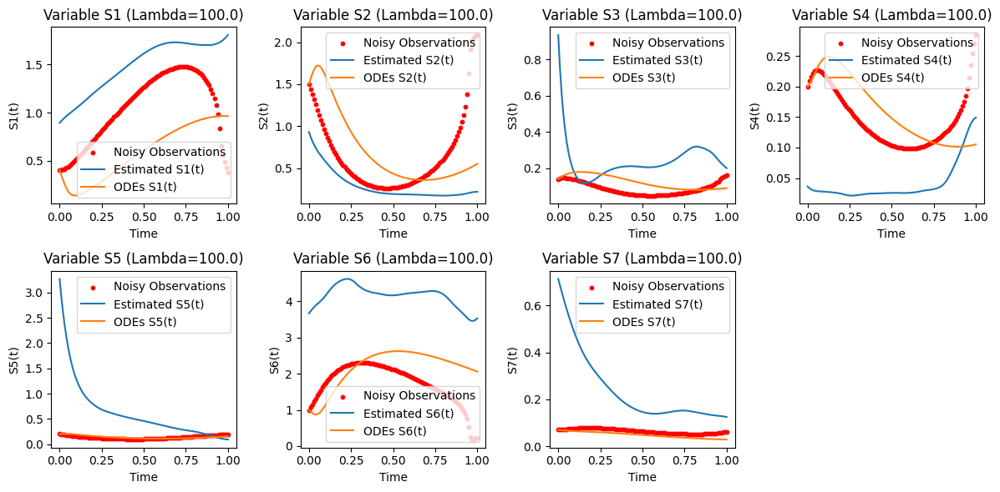

Lambda: 100.0; [1.81017507e+00 7.38129282e+02 5.91507443e+00 1.03114530e+01
 9.22299460e+01 9.69815253e-01 6.05928929e+00 2.38982731e+00
 6.75478452e+00 1.70951541e+01 3.92181717e-01 9.51263237e-02
 8.12473062e-01 4.30360160e+00]


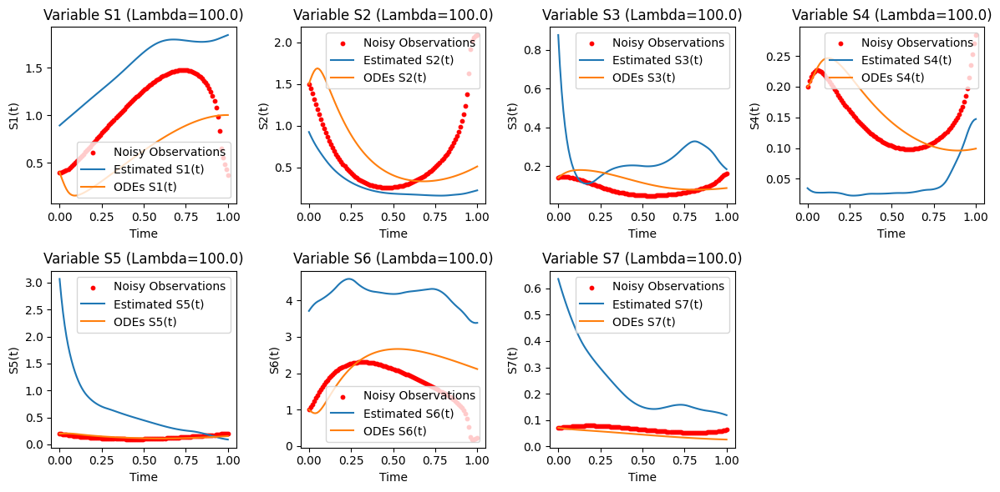

Lambda: 67.23357536499334; [1.79715950e+00 7.38128577e+02 5.93492997e+00 1.03849309e+01
 9.22217519e+01 9.33931952e-01 6.01803406e+00 2.26252608e+00
 6.74747939e+00 1.70951541e+01 3.89703851e-01 7.47320022e-02
 8.31688212e-01 4.30446366e+00]


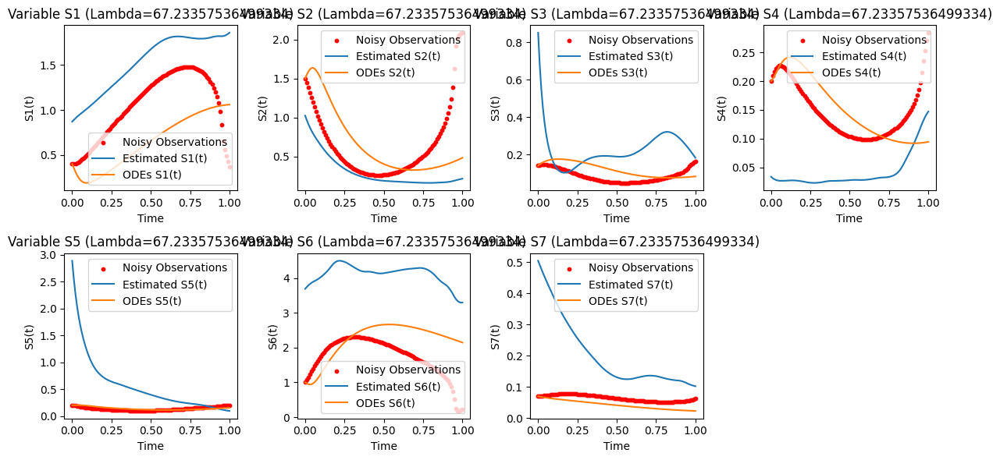

Lambda: 45.2035365636025; [1.78588267e+00 7.38126293e+02 5.97034604e+00 1.04265200e+01
 9.21443704e+01 9.03722849e-01 5.99094346e+00 2.15550792e+00
 6.72127337e+00 1.70951541e+01 3.81705655e-01 6.11731531e-02
 8.20959490e-01 4.30384556e+00]


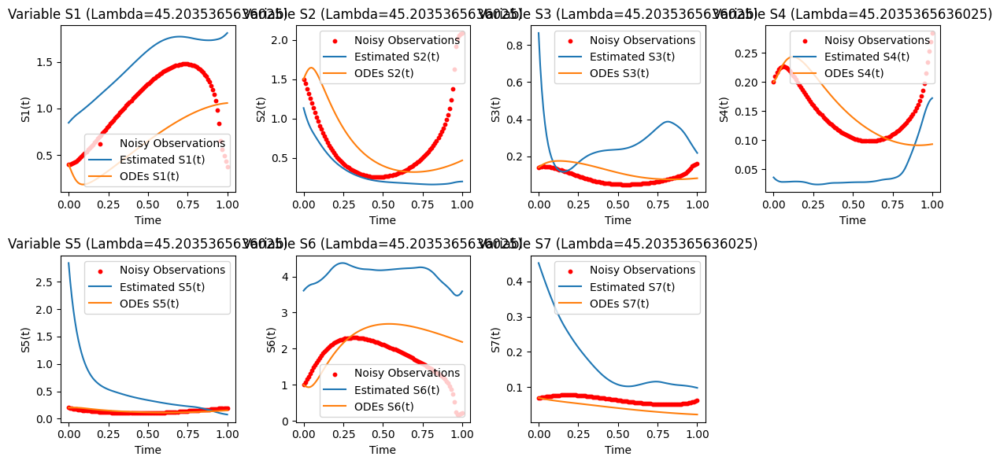

Lambda: 30.39195382313201; [1.77674920e+00 7.38126260e+02 5.92533169e+00 1.04808677e+01
 9.23578845e+01 8.81783210e-01 6.02776308e+00 2.08606606e+00
 6.69308785e+00 1.70951541e+01 3.83941174e-01 5.58912316e-02
 8.25682527e-01 4.30600420e+00]


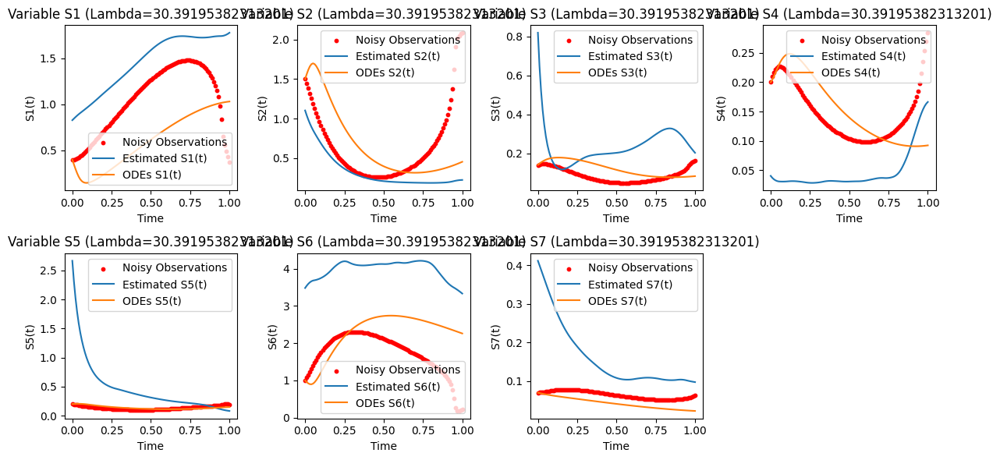

Lambda: 20.43359717856944; [1.76220599e+00 7.38126315e+02 5.97152407e+00 1.05472312e+01
 9.23529817e+01 8.50100649e-01 6.03520917e+00 1.97468855e+00
 6.66367230e+00 1.70951541e+01 3.92673769e-01 4.93148039e-02
 8.25628217e-01 4.30527759e+00]


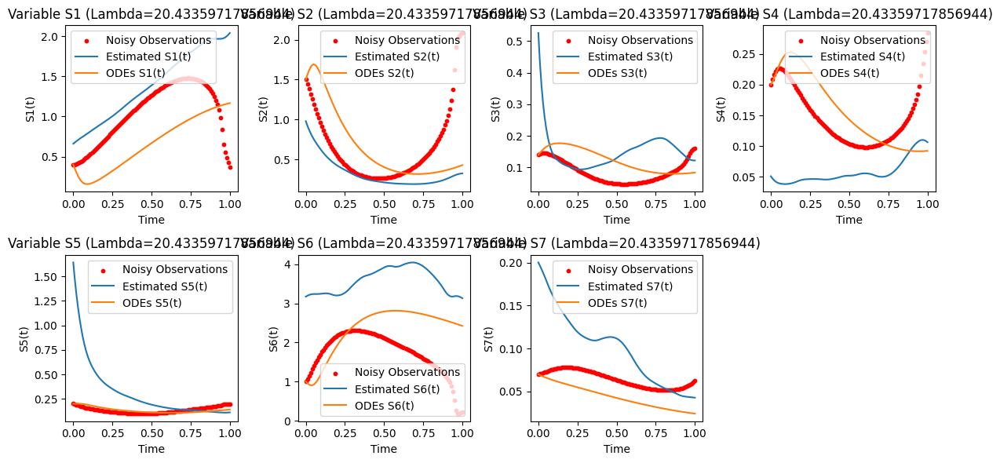

Lambda: 13.738237958832638; [1.88545484e+00 7.38125046e+02 5.72846681e+00 1.05958626e+01
 9.22501354e+01 7.51319380e-01 6.44201325e+00 1.75488639e+00
 6.63996912e+00 1.70951541e+01 3.91781630e-01 4.10099362e-02
 8.46730355e-01 4.30486432e+00]


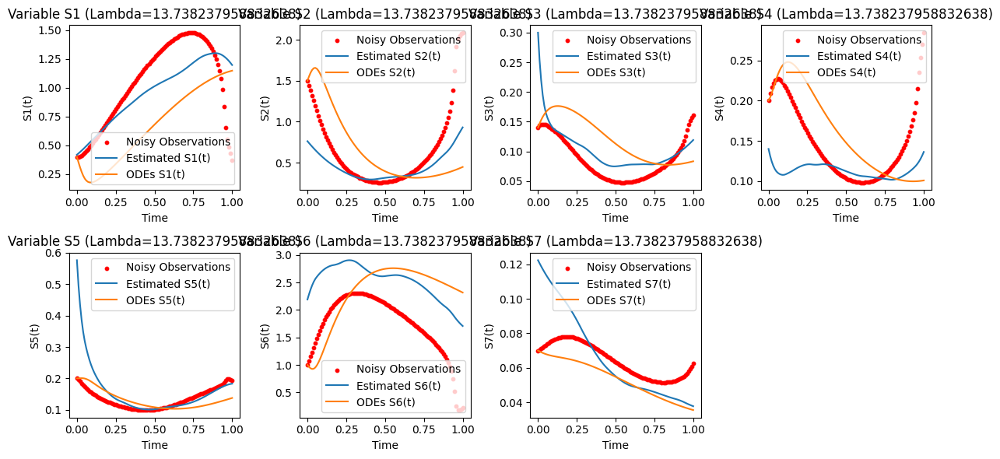

Lambda: 9.236708571873866; [1.86887884e+00 7.38120613e+02 5.63412306e+00 1.04148920e+01
 9.39477266e+01 8.15525587e-01 6.33450836e+00 1.68938019e+00
 6.75123596e+00 1.70951541e+01 3.87138319e-01 7.79857189e-02
 8.66475219e-01 4.36255046e+00]


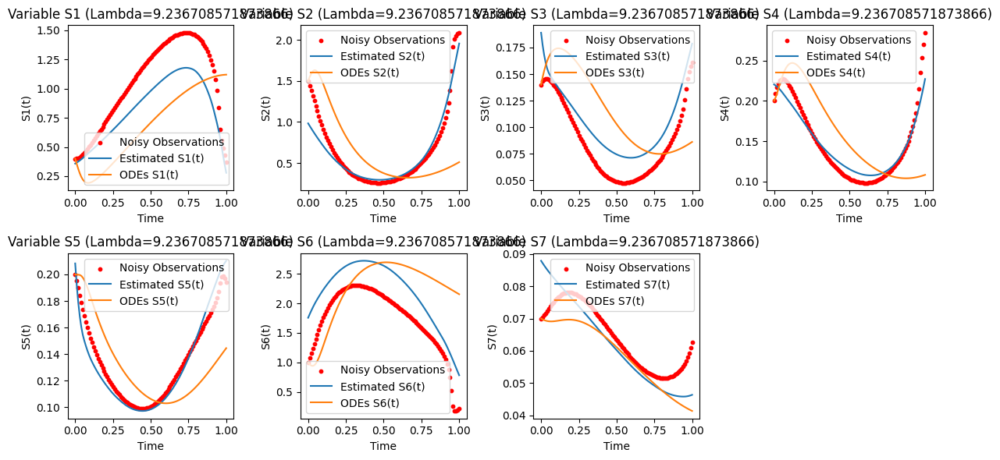

Lambda: 6.2101694189156165; [1.92511682e+00 7.38116113e+02 5.72936507e+00 1.07059313e+01
 9.54740493e+01 8.85906784e-01 6.94466462e+00 1.66610095e+00
 7.57736942e+00 1.70951541e+01 3.87304758e-01 9.11996694e-02
 8.80685808e-01 4.39174244e+00]


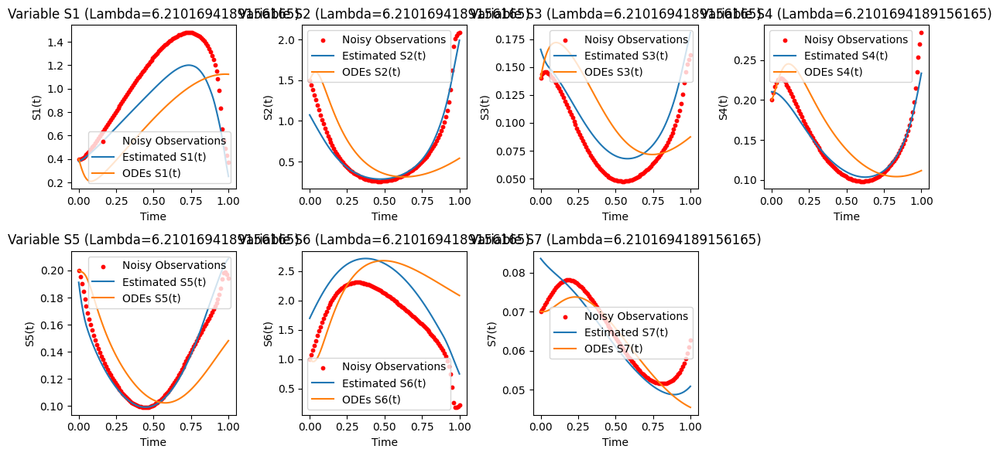

Lambda: 4.175318936560405; [1.97642358e+00 7.38111869e+02 5.85971423e+00 1.10440019e+01
 9.72536598e+01 9.00245410e-01 7.71009289e+00 1.65176112e+00
 8.58698491e+00 1.70951541e+01 3.87460349e-01 9.84163070e-02
 8.95416569e-01 4.42908734e+00]


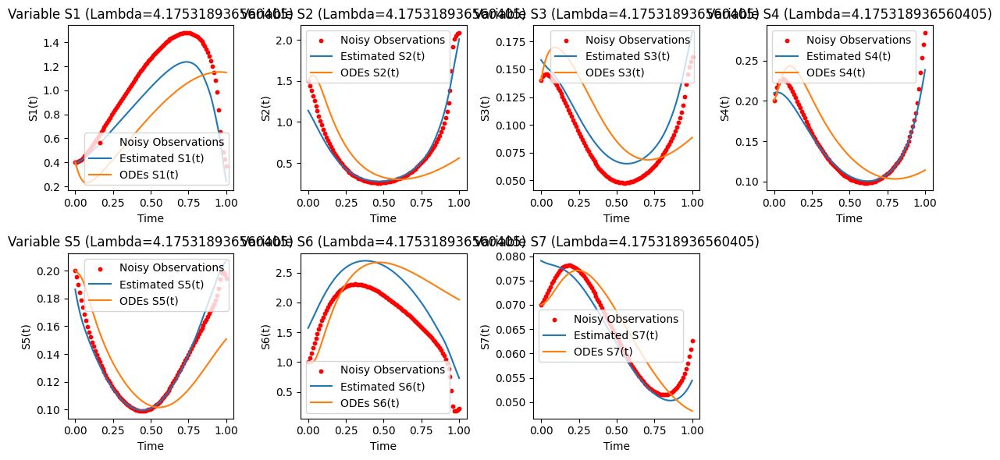

Lambda: 2.8072162039411785; [2.04380657e+00 7.38106946e+02 6.00477639e+00 1.13897535e+01
 9.92715100e+01 8.97524838e-01 8.55179550e+00 1.64489097e+00
 9.67079846e+00 1.70951541e+01 3.87261273e-01 1.01513632e-01
 9.10865427e-01 4.47442468e+00]


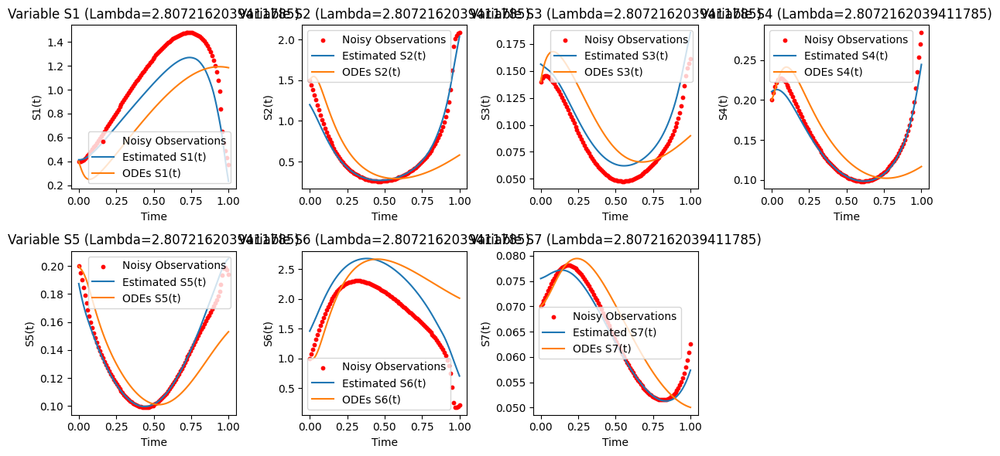

Lambda: 1.8873918221350976; [2.12418416e+00 7.38104462e+02 6.14691553e+00 1.17059664e+01
 1.01337691e+02 8.94962643e-01 9.41575818e+00 1.64503149e+00
 1.07368126e+01 1.70951541e+01 3.86476006e-01 1.01869310e-01
 9.26427838e-01 4.52690020e+00]


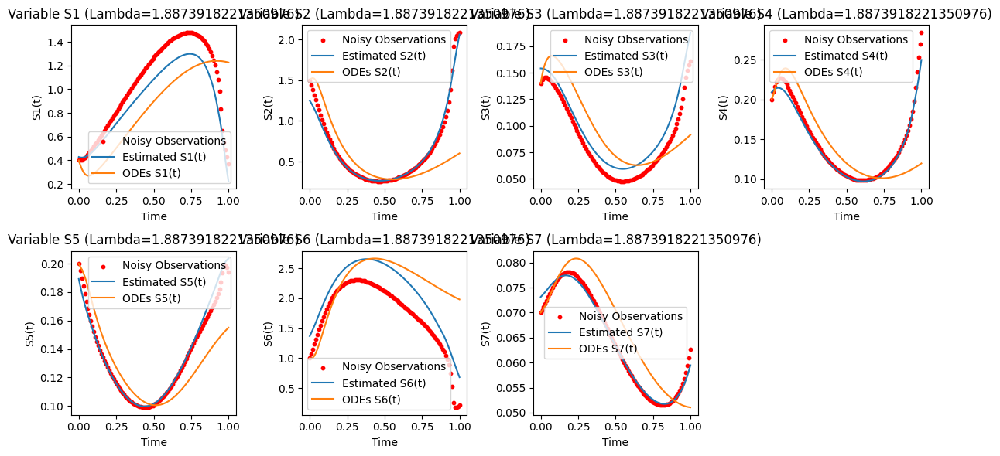

Lambda: 1.2689610031679235; [2.21344627e+00 7.38103189e+02 6.27696683e+00 1.19704270e+01
 1.03329084e+02 8.95620639e-01 1.02643043e+01 1.66093126e+00
 1.17232765e+01 1.70951541e+01 3.84921386e-01 1.00940285e-01
 9.41669027e-01 4.58605518e+00]


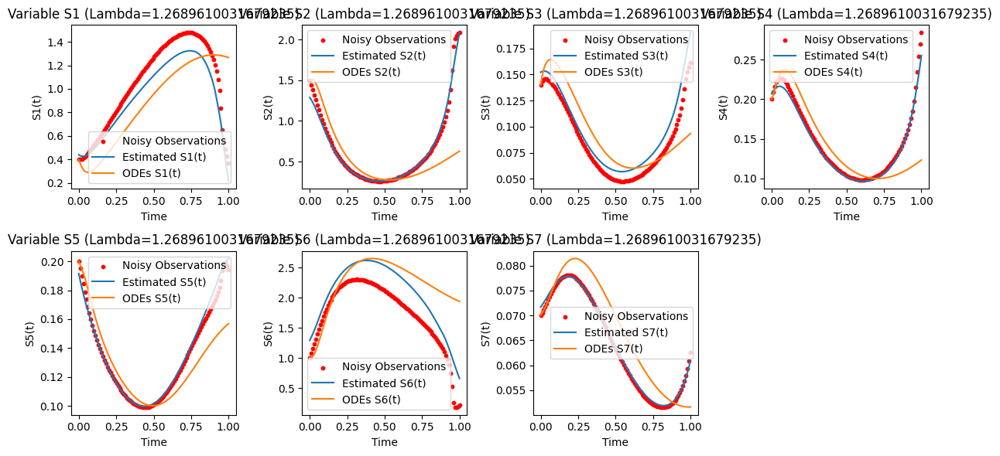

Lambda: 0.8531678524172814; [2.30761620e+00 7.38103473e+02 6.39081794e+00 1.21779607e+01
 1.05175883e+02 9.04061520e-01 1.10707245e+01 1.68652022e+00
 1.25905150e+01 1.70951541e+01 3.82500655e-01 9.92531991e-02
 9.56009384e-01 4.64999822e+00]


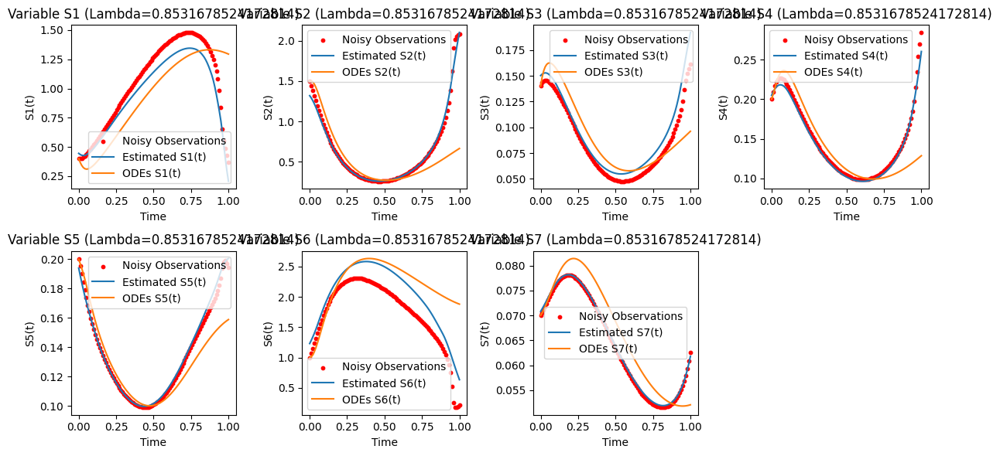

Lambda: 0.5736152510448681; [2.40294619e+00 7.38106344e+02 6.49942735e+00 1.23482609e+01
 1.06873789e+02 9.25611067e-01 1.18266143e+01 1.71638709e+00
 1.33431280e+01 1.70951541e+01 3.79003835e-01 9.69624938e-02
 9.68106928e-01 4.71478106e+00]


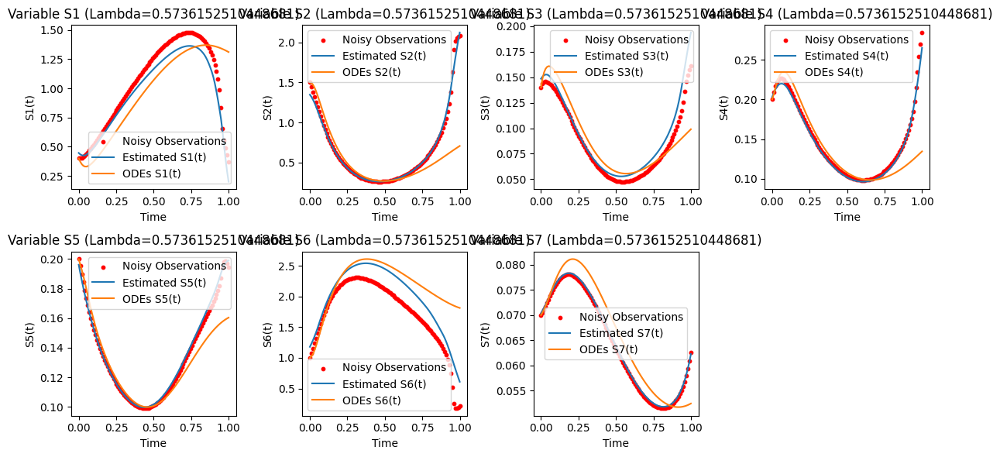

Lambda: 0.38566204211634725; [2.48315058e+00 7.38109320e+02 6.57844992e+00 1.24577532e+01
 1.08167081e+02 9.53275657e-01 1.24329484e+01 1.74120893e+00
 1.38614926e+01 1.70951541e+01 3.74314520e-01 9.49803494e-02
 9.77589636e-01 4.77344790e+00]


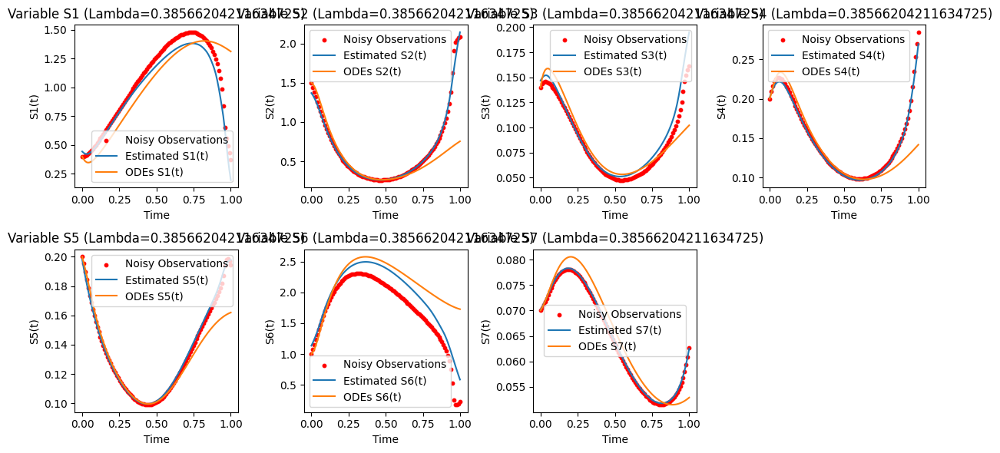

Lambda: 0.2592943797404667; [2.54838468e+00 7.38112981e+02 6.65402396e+00 1.25786103e+01
 1.09170845e+02 9.89873427e-01 1.29111687e+01 1.76546936e+00
 1.42335526e+01 1.70951541e+01 3.68384009e-01 9.31754548e-02
 9.82785253e-01 4.81473115e+00]


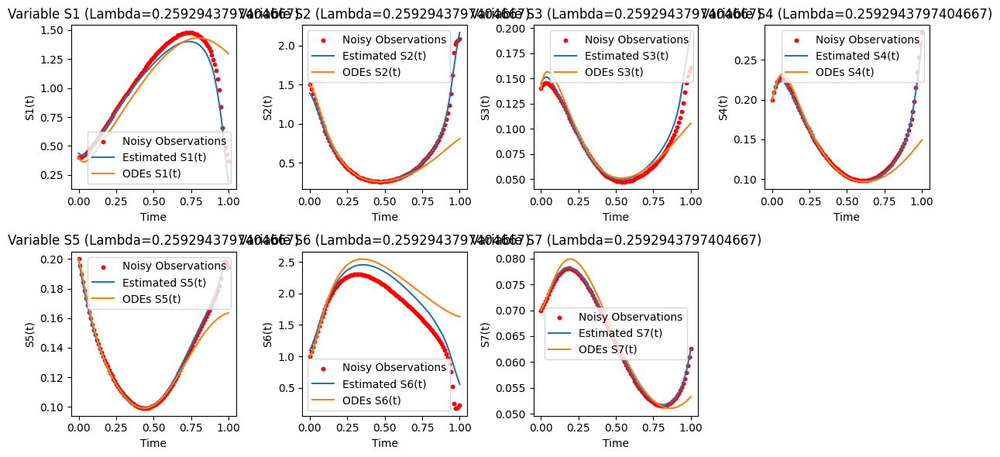

Lambda: 0.1743328822199989; [2.58895108e+00 7.38115149e+02 6.71288445e+00 1.27501500e+01
 1.09791385e+02 1.03151461e+00 1.32031571e+01 1.78329212e+00
 1.44221151e+01 1.70951541e+01 3.61073839e-01 9.19585288e-02
 9.83946432e-01 4.82244555e+00]


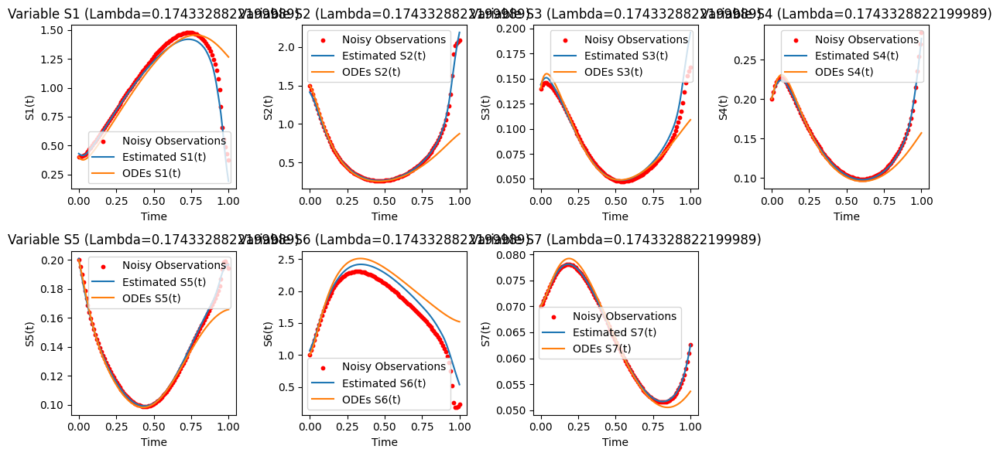

Lambda: 0.11721022975334805; [2.60160496e+00 7.38112302e+02 6.75216606e+00 1.30166888e+01
 1.09983056e+02 1.07620719e+00 1.32825060e+01 1.79376168e+00
 1.44317101e+01 1.70951541e+01 3.52364982e-01 9.15002257e-02
 9.80990290e-01 4.78314713e+00]


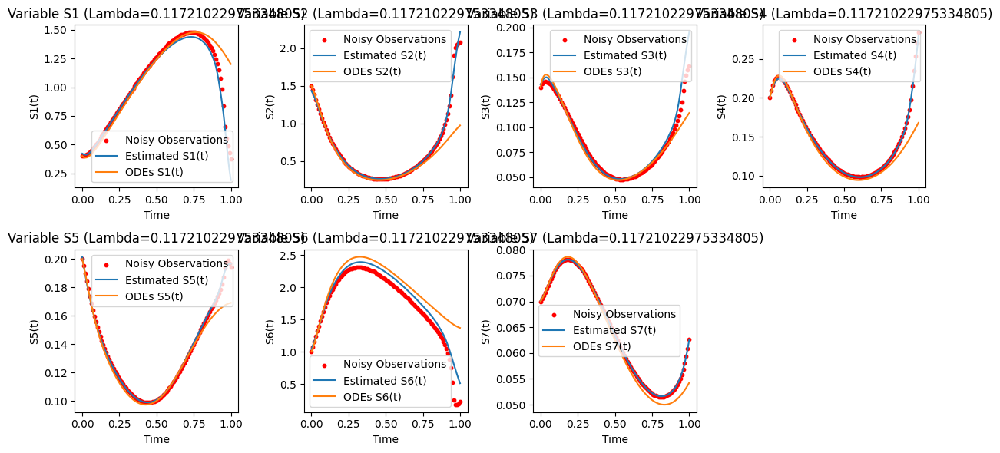

Lambda: 0.07880462815669913; [2.60281389e+00 7.38090965e+02 6.78360837e+00 1.34751940e+01
 1.09986565e+02 1.12915470e+00 1.32633344e+01 1.80149457e+00
 1.44134438e+01 1.70951541e+01 3.42509454e-01 9.13938930e-02
 9.76359696e-01 4.68996105e+00]


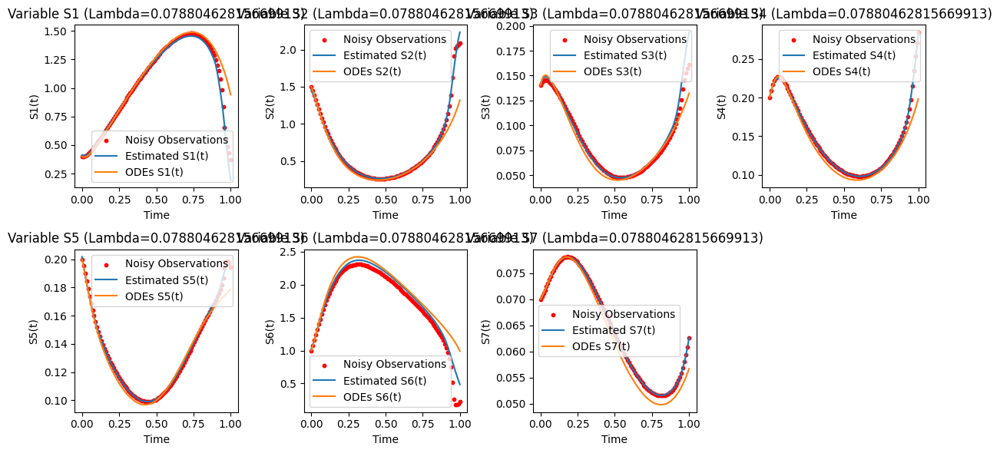

Lambda: 0.0529831690628371; [2.60008327e+00 7.38020202e+02 6.80704739e+00 1.41820701e+01
 1.09928867e+02 1.20858520e+00 1.31733627e+01 1.80787157e+00
 1.43670548e+01 1.70951541e+01 3.31635806e-01 9.16251707e-02
 9.71224859e-01 4.54164960e+00]


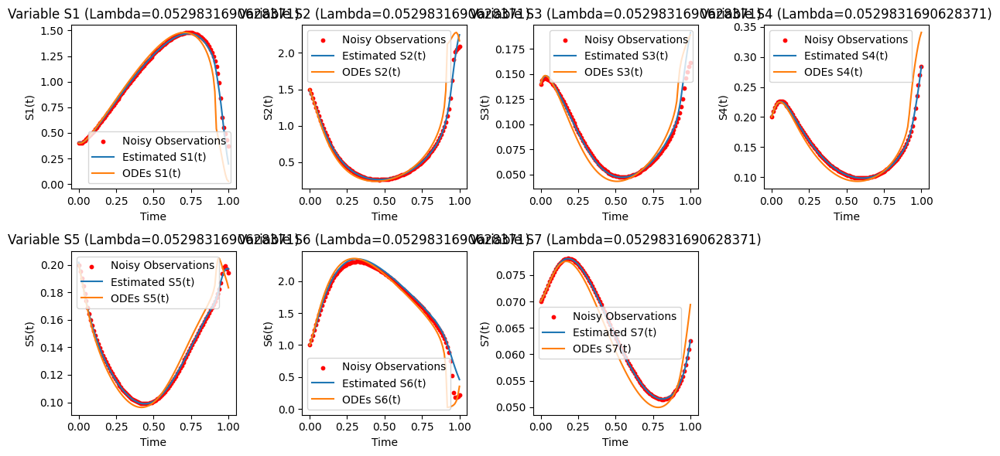

Lambda: 0.03562247890262444; [2.58783139e+00 7.37868317e+02 6.80589006e+00 1.50424285e+01
 1.09760750e+02 1.32560234e+00 1.29813479e+01 1.81166369e+00
 1.42716504e+01 1.70951541e+01 3.19644558e-01 9.21776741e-02
 9.66840026e-01 4.36679691e+00]


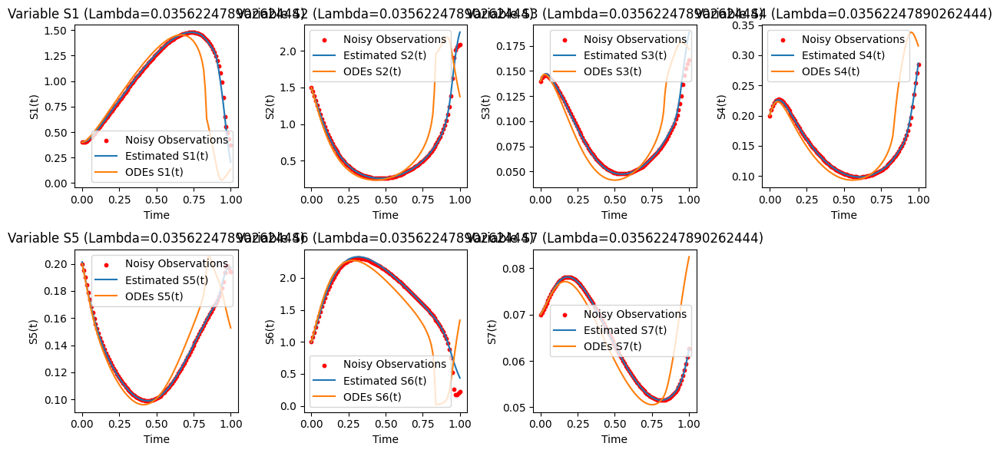

Lambda: 0.02395026619987486; [2.56334064e+00 7.37609195e+02 6.77442412e+00 1.58676682e+01
 1.09516045e+02 1.49184205e+00 1.26949822e+01 1.81201198e+00
 1.41321499e+01 1.70951541e+01 3.06312921e-01 9.29419457e-02
 9.63987408e-01 4.20631029e+00]


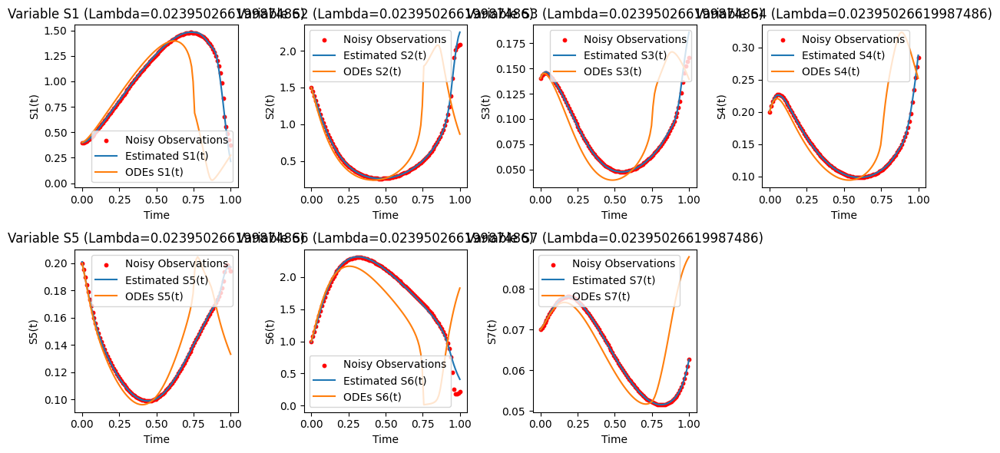

Lambda: 0.01610262027560939; [2.51291178e+00 7.37184588e+02 6.71094789e+00 1.64580603e+01
 1.09176027e+02 1.74243927e+00 1.22798874e+01 1.81176211e+00
 1.39222567e+01 1.70951541e+01 2.91028534e-01 9.42106758e-02
 9.61576476e-01 4.08567375e+00]


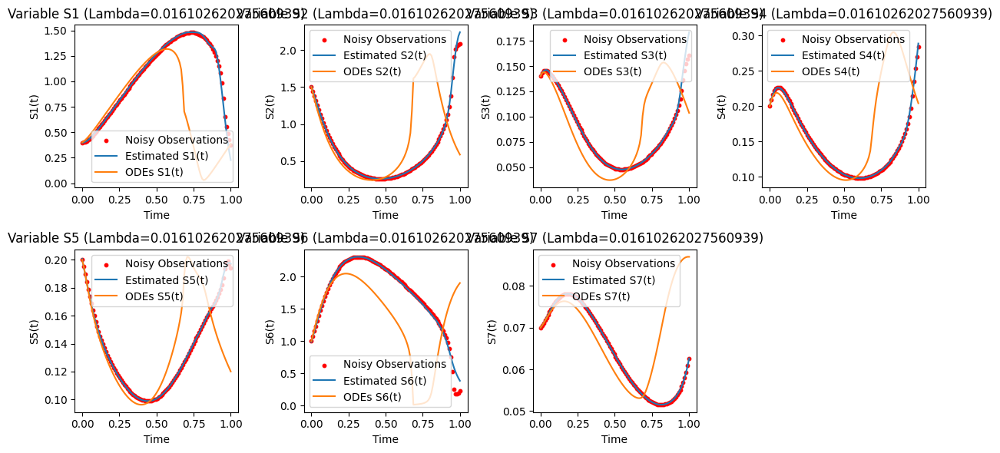

Lambda: 0.010826367338740546; [2.41543223e+00 7.36608480e+02 6.61743866e+00 1.66587272e+01
 1.08597377e+02 2.09101964e+00 1.17146257e+01 1.81111139e+00
 1.35983154e+01 1.70951541e+01 2.72996252e-01 9.63480579e-02
 9.57680360e-01 4.01501253e+00]


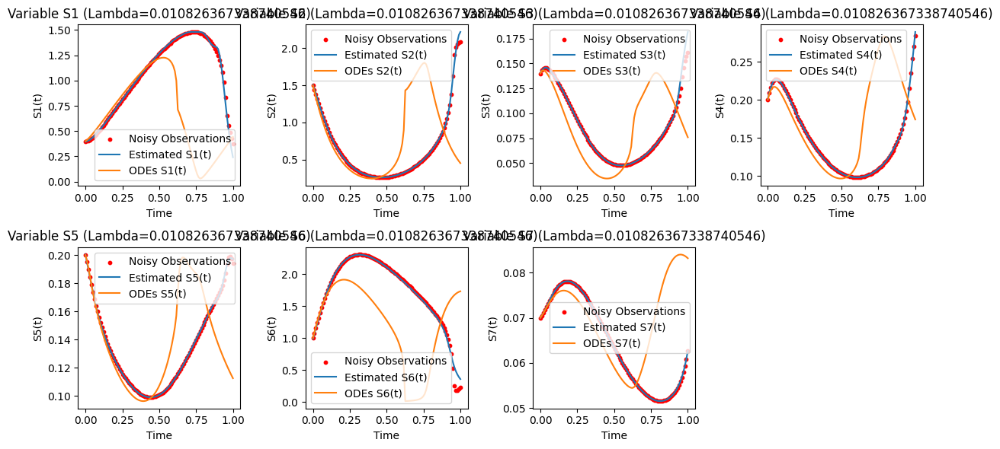

Lambda: 0.007278953843983154; [2.25364723e+00 7.35890799e+02 6.48082727e+00 1.64821380e+01
 1.07631394e+02 2.53716458e+00 1.09794469e+01 1.81022073e+00
 1.31023810e+01 1.70951541e+01 2.51746798e-01 9.99160231e-02
 9.52415964e-01 3.98205454e+00]


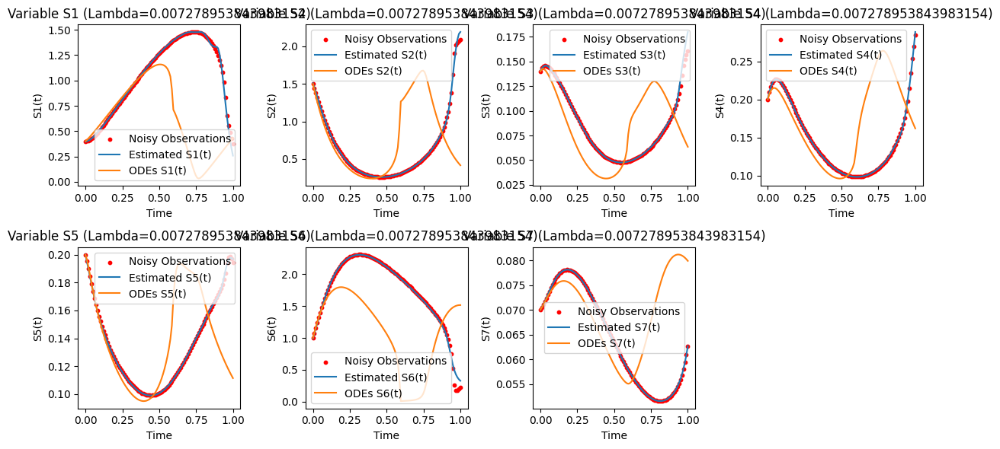

Lambda: 0.004893900918477494; [2.06551194e+00 7.35227413e+02 6.33115688e+00 1.60522270e+01
 1.06357948e+02 2.99783017e+00 1.02324975e+01 1.80935767e+00
 1.25210390e+01 1.70951541e+01 2.27788531e-01 1.04492054e-01
 9.45461657e-01 3.97508712e+00]


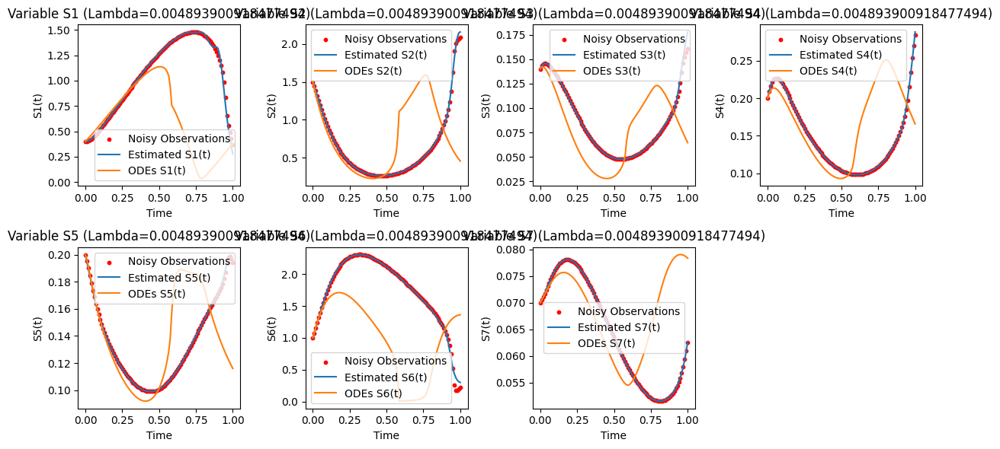

Lambda: 0.0032903445623126675; [1.91307440e+00 7.34774482e+02 6.21574835e+00 1.55664408e+01
 1.05139900e+02 3.37898135e+00 9.65675254e+00 1.80873919e+00
 1.20259176e+01 1.70951541e+01 2.03114814e-01 1.08741826e-01
 9.36671029e-01 3.98227316e+00]


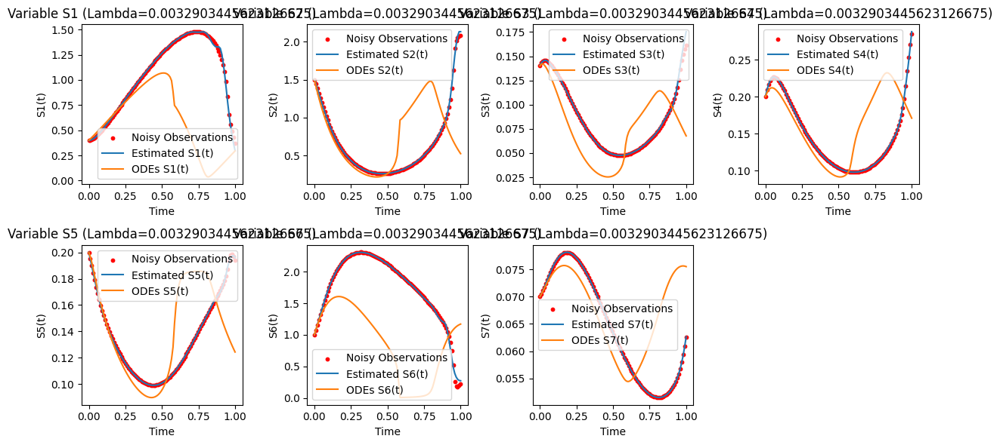

Lambda: 0.00221221629107045; [1.66452484e+00 7.34082862e+02 6.03632076e+00 1.45496513e+01
 1.02473021e+02 3.82623277e+00 8.67716886e+00 1.80759539e+00
 1.10513529e+01 1.70951541e+01 1.78436291e-01 1.18212410e-01
 9.18961300e-01 4.02166130e+00]


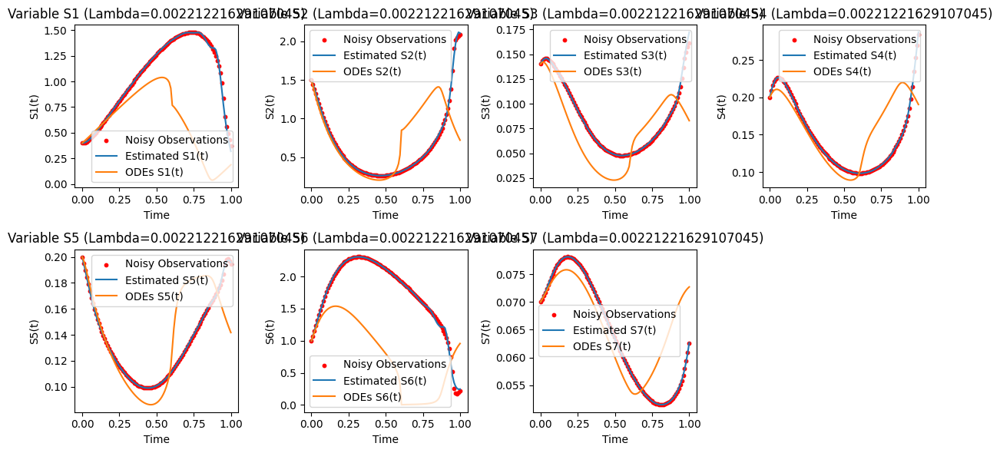

Lambda: 0.0014873521072935117; [1.46573440e+00 7.33457037e+02 5.89560725e+00 1.35150818e+01
 9.93957904e+01 4.06775520e+00 7.79124923e+00 1.80630465e+00
 1.00458478e+01 1.70951541e+01 1.56793992e-01 1.29866070e-01
 8.94236017e-01 4.06565723e+00]


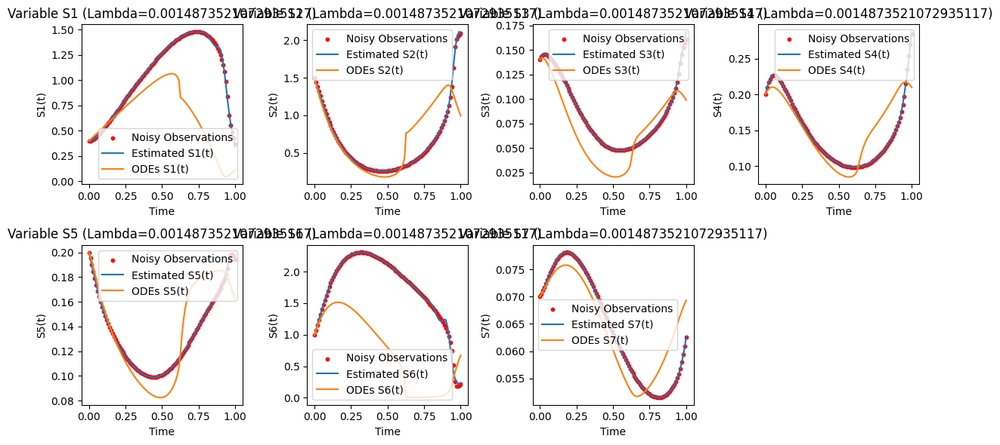

Lambda: 0.001; [1.40937265e+00 7.33238656e+02 5.85648974e+00 1.31699826e+01
 9.82795058e+01 4.15647409e+00 7.51265126e+00 1.80583057e+00
 9.71442264e+00 1.70951541e+01 1.41613921e-01 1.34178586e-01
 8.82079960e-01 4.07233063e+00]


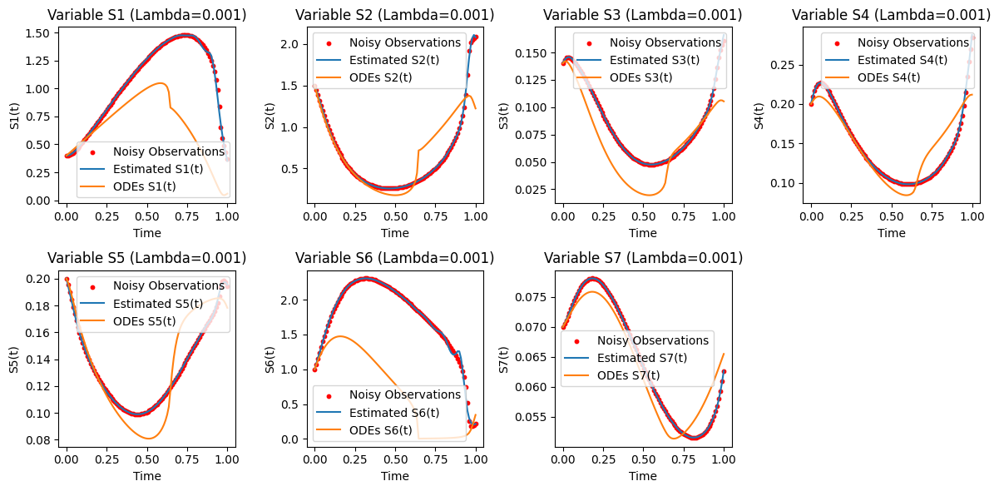

Lambda: 0.001; [1.31531047e+00 7.32882880e+02 5.80001347e+00 1.25072534e+01
 9.60323028e+01 4.27691666e+00 7.00536177e+00 1.80481433e+00
 9.09438679e+00 1.70951541e+01 1.31183795e-01 1.43135135e-01
 8.60985999e-01 4.10401216e+00]


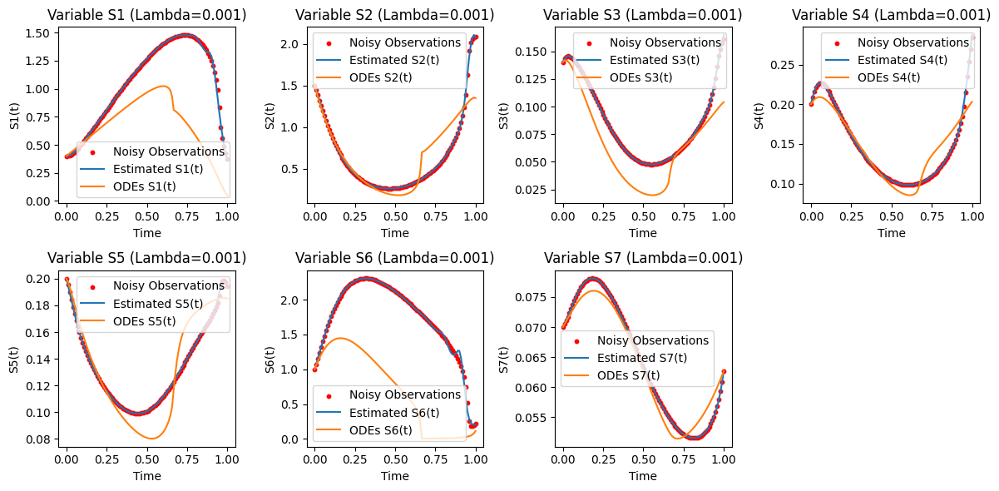

Lambda: 0.0014873521072935117; [1.22507841e+00 7.32508052e+02 5.74853985e+00 1.18333241e+01
 9.35037328e+01 4.29626797e+00 6.49052153e+00 1.80350663e+00
 8.43721323e+00 1.70951541e+01 1.26157347e-01 1.54101008e-01
 8.38909990e-01 4.14090065e+00]


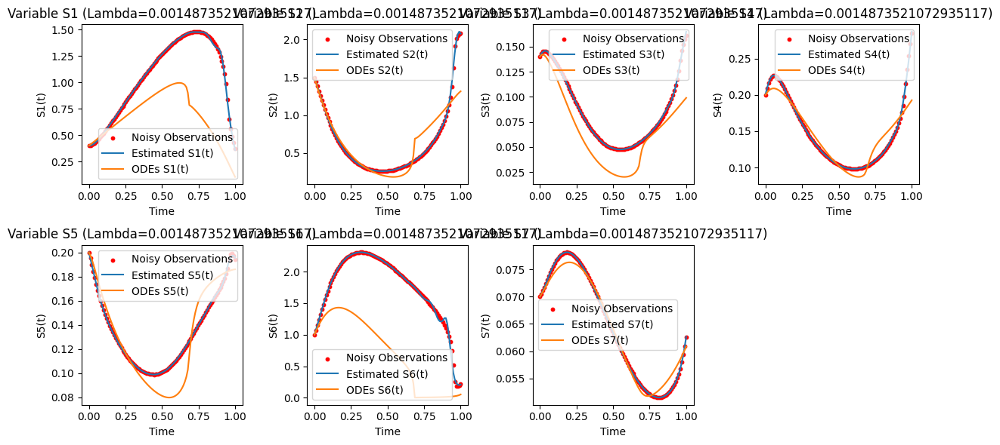

Lambda: 0.00221221629107045; [1.13995481e+00 7.32123537e+02 5.69904617e+00 1.11852052e+01
 9.08194209e+01 4.24841645e+00 5.99224639e+00 1.80188527e+00
 7.77647105e+00 1.70951541e+01 1.24129669e-01 1.67028737e-01
 8.16902168e-01 4.17834342e+00]


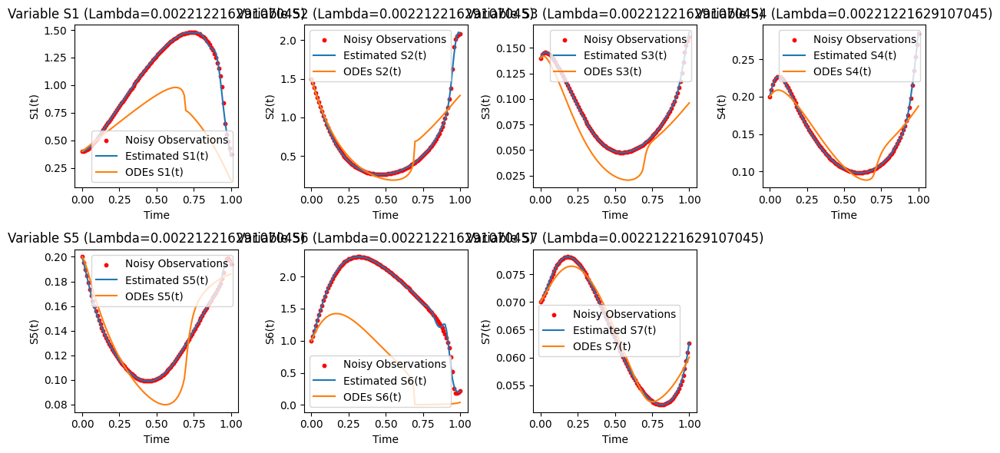

Lambda: 0.0032903445623126675; [1.09387684e+00 7.31901943e+02 5.66978061e+00 1.08336373e+01
 8.92536262e+01 4.19863854e+00 5.72027671e+00 1.80081250e+00
 7.40728126e+00 1.70951541e+01 1.23687367e-01 1.75290980e-01
 8.04706899e-01 4.19883718e+00]


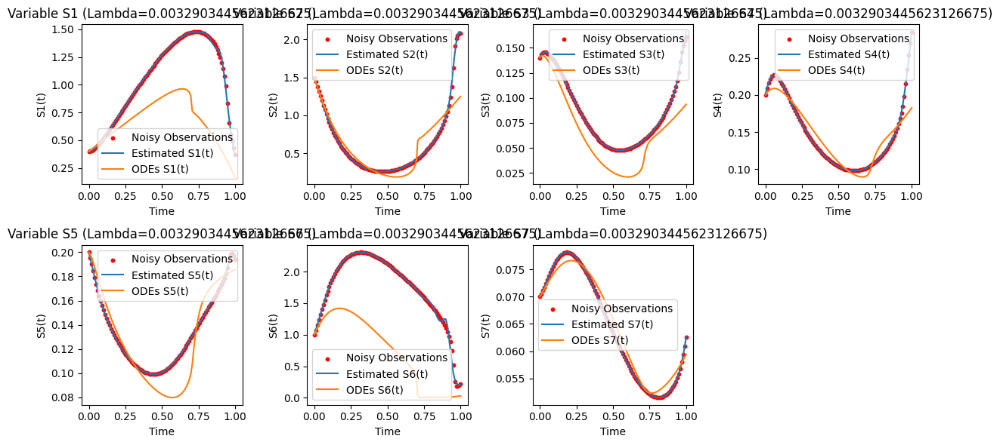

Lambda: 0.004893900918477494; [1.05086955e+00 7.31687434e+02 5.63899740e+00 1.05103800e+01
 8.77408958e+01 4.13586086e+00 5.46795794e+00 1.79968227e+00
 7.06099390e+00 1.70951541e+01 1.23790849e-01 1.83860276e-01
 7.93500612e-01 4.21782416e+00]


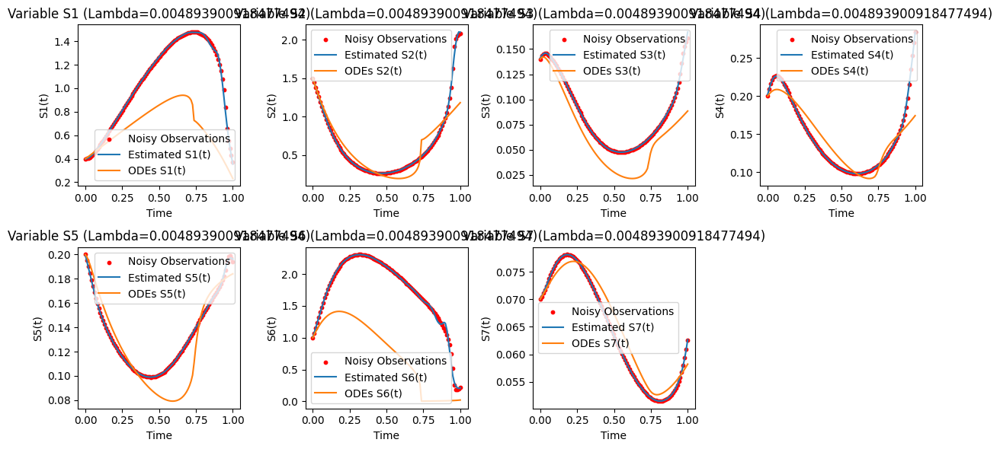

Lambda: 0.007278953843983154; [9.79910764e-01 7.31308900e+02 5.57653579e+00 9.97495597e+00
 8.51185274e+01 4.00419774e+00 5.05325049e+00 1.79750361e+00
 6.48505210e+00 1.70951541e+01 1.23757162e-01 2.00048820e-01
 7.75251989e-01 4.24846414e+00]


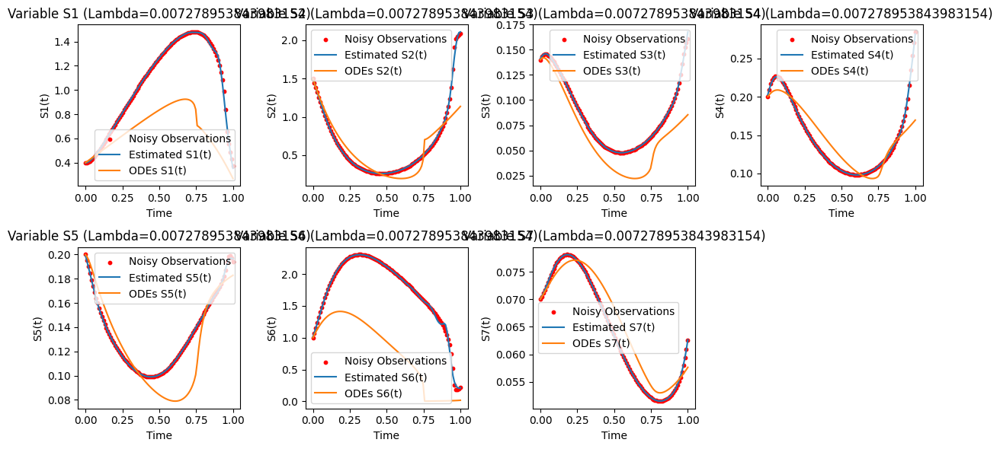

Lambda: 0.010826367338740546; [9.32289199e-01 7.31037406e+02 5.52444122e+00 9.61614878e+00
 8.32515745e+01 3.89750883e+00 4.77332074e+00 1.79576055e+00
 6.09494303e+00 1.70951541e+01 1.24398578e-01 2.12830321e-01
 7.63368390e-01 4.26871332e+00]


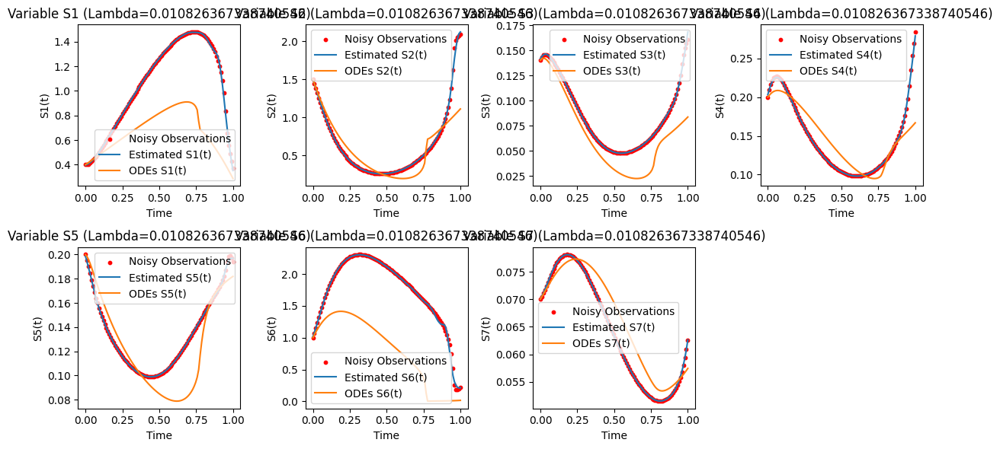

Lambda: 0.01610262027560939; [8.98608464e-01 7.30833026e+02 5.47968785e+00 9.36876332e+00
 8.18943709e+01 3.80965944e+00 4.57457360e+00 1.79440818e+00
 5.82134216e+00 1.70951541e+01 1.25634679e-01 2.22978564e-01
 7.55499381e-01 4.28215704e+00]


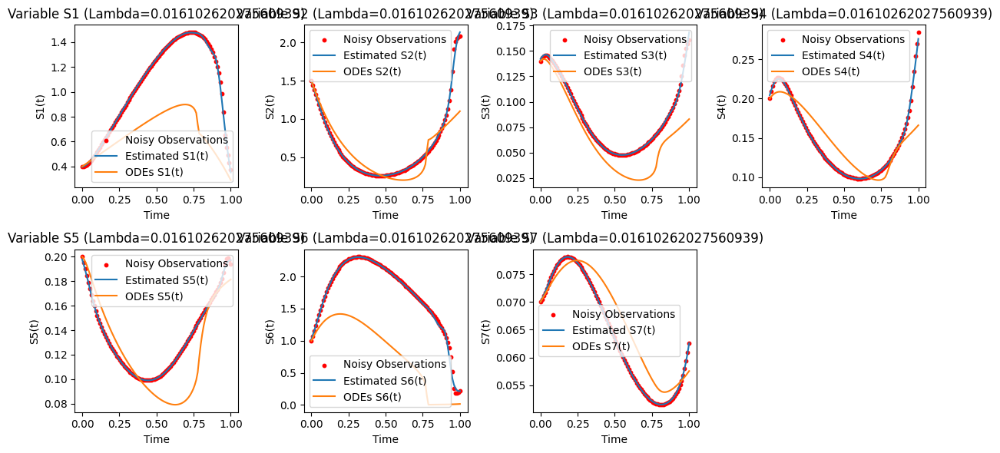

Lambda: 0.02395026619987486; [8.74569744e-01 7.30679107e+02 5.44195331e+00 9.20081574e+00
 8.09110808e+01 3.73629274e+00 4.43040469e+00 1.79341115e+00
 5.62850551e+00 1.70951541e+01 1.27424141e-01 2.30952845e-01
 7.50244437e-01 4.28976886e+00]


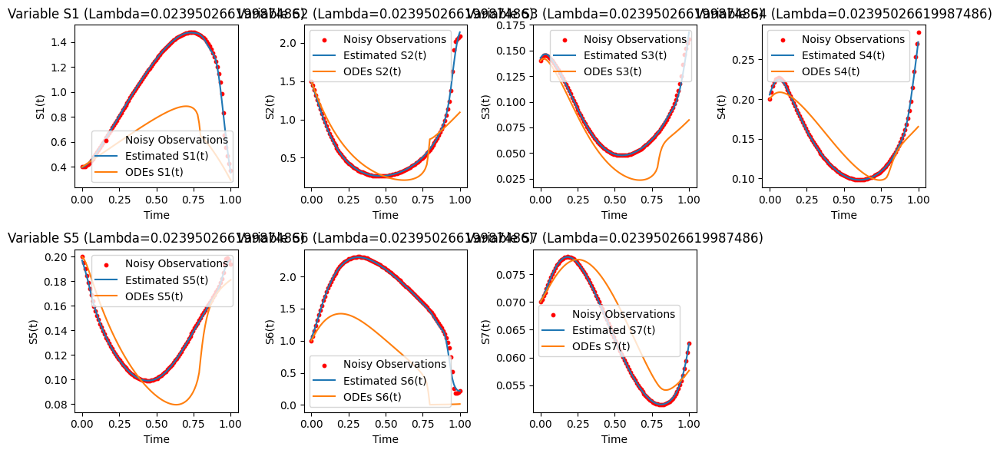

Lambda: 0.03562247890262444; [8.51605535e-01 7.30521708e+02 5.39796981e+00 9.05053949e+00
 7.99515885e+01 3.65292080e+00 4.28690273e+00 1.79250301e+00
 5.44475209e+00 1.70951541e+01 1.29551394e-01 2.39250740e-01
 7.45629877e-01 4.29335311e+00]


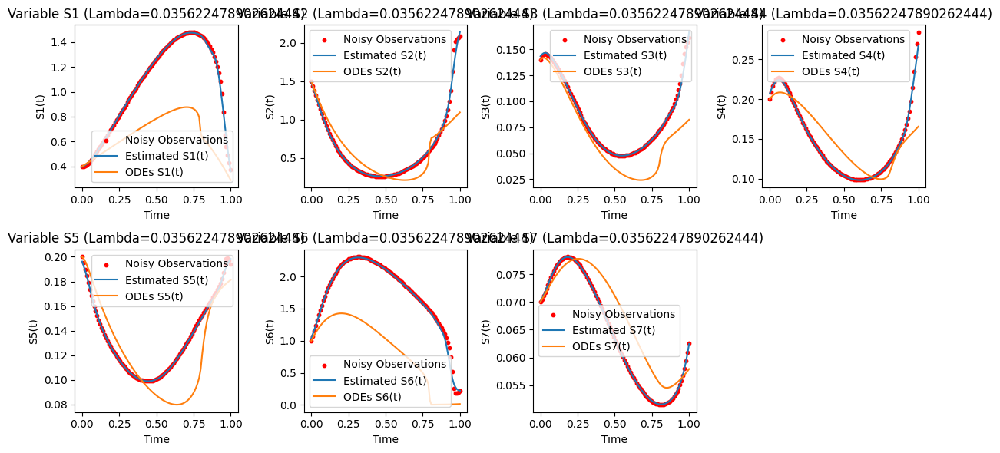

Lambda: 0.0529831690628371; [8.35878067e-01 7.30402749e+02 5.36031327e+00 8.95076827e+00
 7.92565709e+01 3.58135241e+00 4.17890136e+00 1.79191421e+00
 5.31525172e+00 1.70951541e+01 1.32157511e-01 2.45770383e-01
 7.42480588e-01 4.29275887e+00]


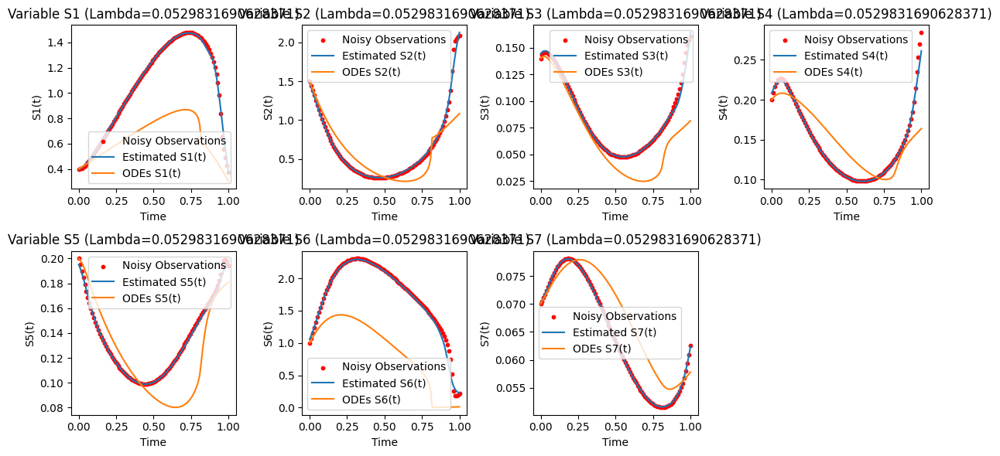

Lambda: 0.07880462815669913; [8.17489190e-01 7.30241721e+02 5.30010560e+00 8.82447438e+00
 7.83400696e+01 3.46993423e+00 4.02912372e+00 1.79145286e+00
 5.14907427e+00 1.70951541e+01 1.35002299e-01 2.54577920e-01
 7.39252610e-01 4.28891655e+00]


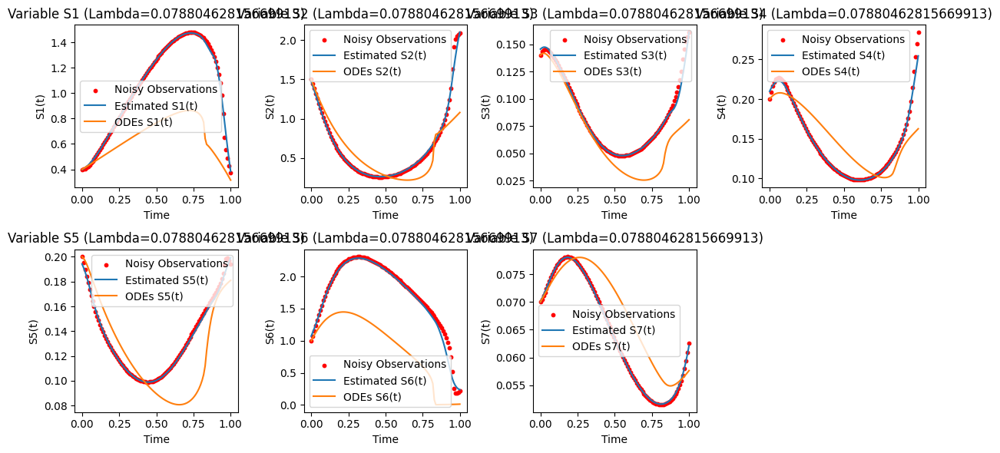

Lambda: 0.11721022975334805; [8.05418696e-01 7.30097188e+02 5.23481751e+00 8.72138114e+00
 7.75459862e+01 3.35437405e+00 3.89072524e+00 1.79207848e+00
 5.00959228e+00 1.70951541e+01 1.38230218e-01 2.62742851e-01
 7.37560062e-01 4.28270197e+00]


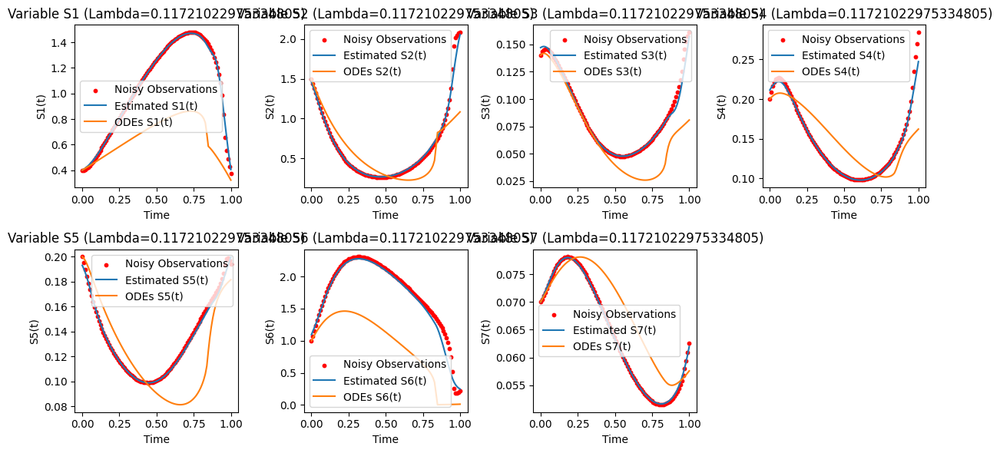

Lambda: 0.1743328822199989; [8.01668946e-01 7.29994378e+02 5.17783206e+00 8.65963916e+00
 7.70177988e+01 3.25002745e+00 3.78811159e+00 1.79490724e+00
 4.91923555e+00 1.70951541e+01 1.41896053e-01 2.68922698e-01
 7.37649219e-01 4.27573496e+00]


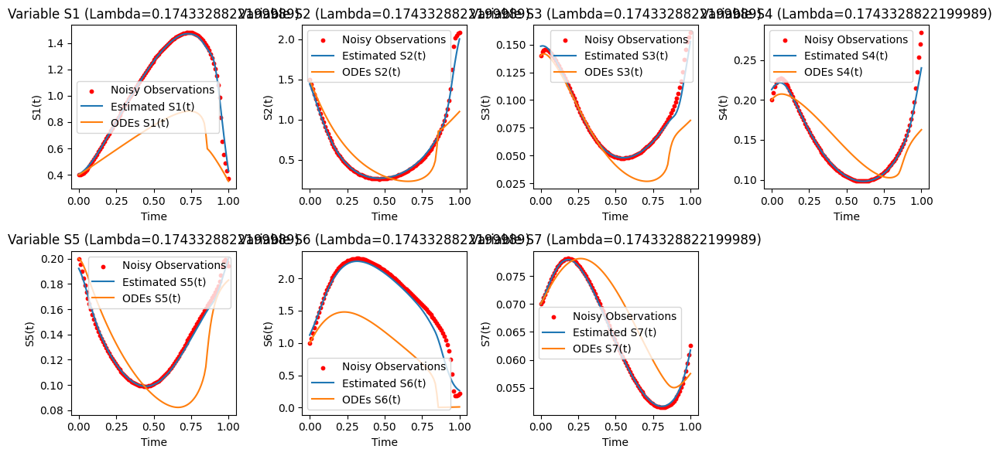

Lambda: 0.2592943797404667; [8.31399515e-01 7.29911777e+02 5.11857740e+00 8.62132861e+00
 7.66416008e+01 3.13326025e+00 3.70049290e+00 1.80082716e+00
 4.85517606e+00 1.70951541e+01 1.45812057e-01 2.74132457e-01
 7.39895583e-01 4.26840634e+00]


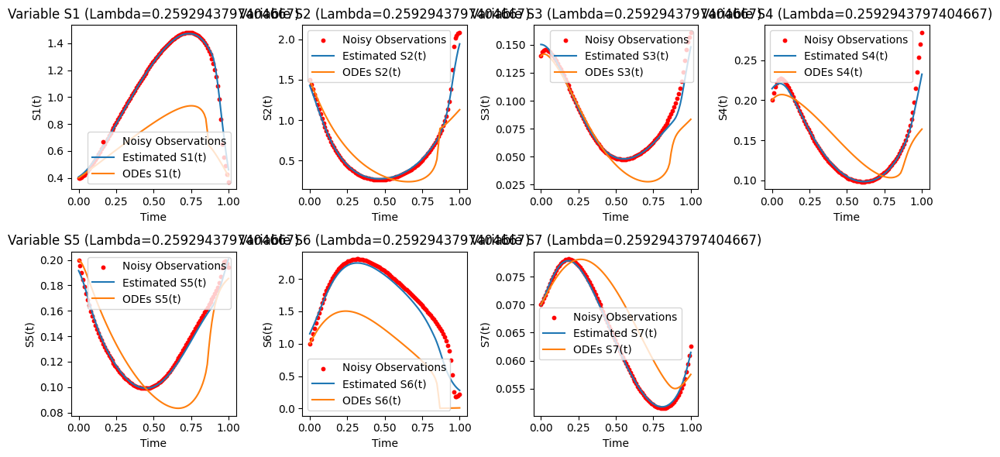

Lambda: 0.38566204211634725; [9.06671967e-01 7.29845133e+02 5.05531247e+00 8.59794572e+00
 7.63849367e+01 3.00200318e+00 3.62271996e+00 1.81095818e+00
 4.81112859e+00 1.70951541e+01 1.49955633e-01 2.78584798e-01
 7.43933634e-01 4.26111941e+00]


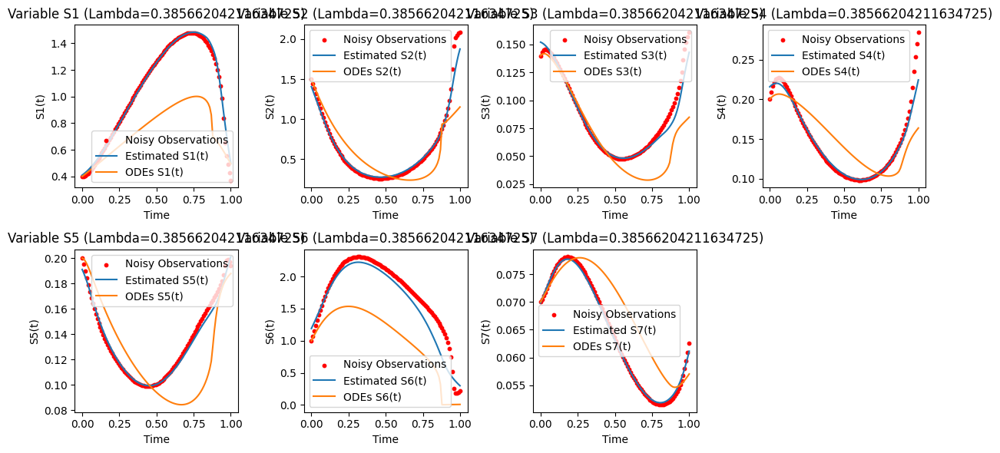

Lambda: 0.5736152510448681; [9.93667701e-01 7.29788497e+02 4.98456659e+00 8.58213404e+00
 7.62174229e+01 2.85179889e+00 3.54877404e+00 1.82704976e+00
 4.78154732e+00 1.70951541e+01 1.54263918e-01 2.82684080e-01
 7.49989359e-01 4.25414463e+00]


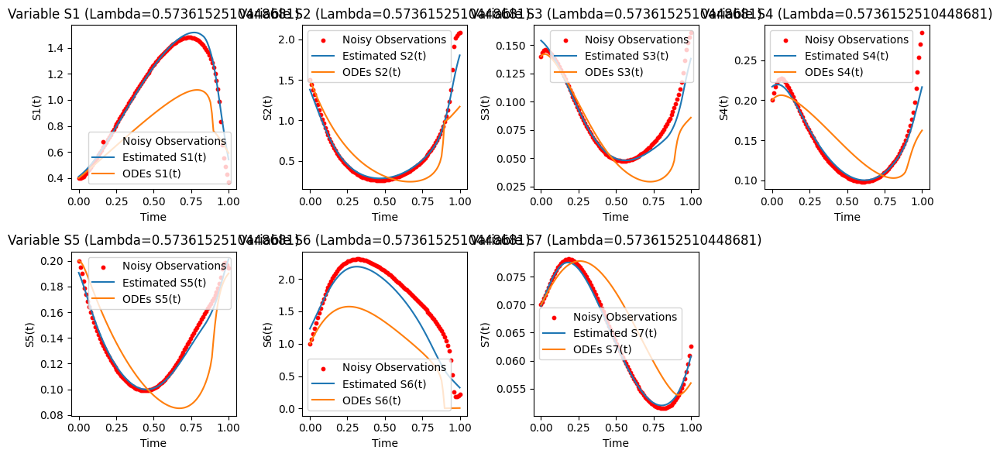

Lambda: 0.8531678524172814; [1.08775261e+00 7.29743373e+02 4.91389160e+00 8.58192874e+00
 7.61640990e+01 2.69030468e+00 3.48720868e+00 1.84949387e+00
 4.76872444e+00 1.70951541e+01 1.58736263e-01 2.86184362e-01
 7.57901688e-01 4.24720705e+00]


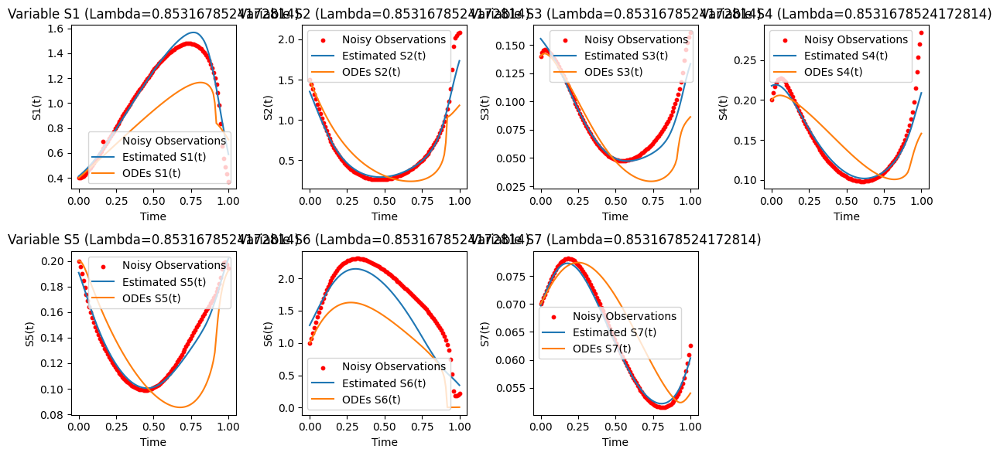

Lambda: 1.2689610031679235; [1.19170783e+00 7.29706314e+02 4.84974015e+00 8.69621378e+00
 7.70060140e+01 2.51700327e+00 3.44342591e+00 1.88411031e+00
 4.80754718e+00 1.70951541e+01 1.63537397e-01 2.87647090e-01
 7.72661993e-01 4.23436603e+00]


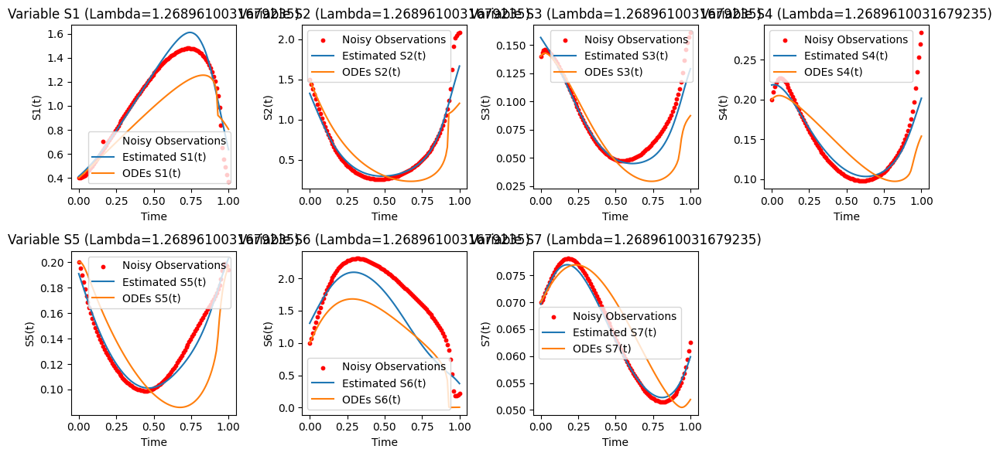

Lambda: 1.8873918221350976; [1.30027202e+00 7.29683691e+02 4.81289727e+00 8.93694628e+00
 7.87233055e+01 2.37981059e+00 3.42818016e+00 1.93192739e+00
 4.94240919e+00 1.70951541e+01 1.68359633e-01 2.85256529e-01
 7.92251424e-01 4.21590426e+00]


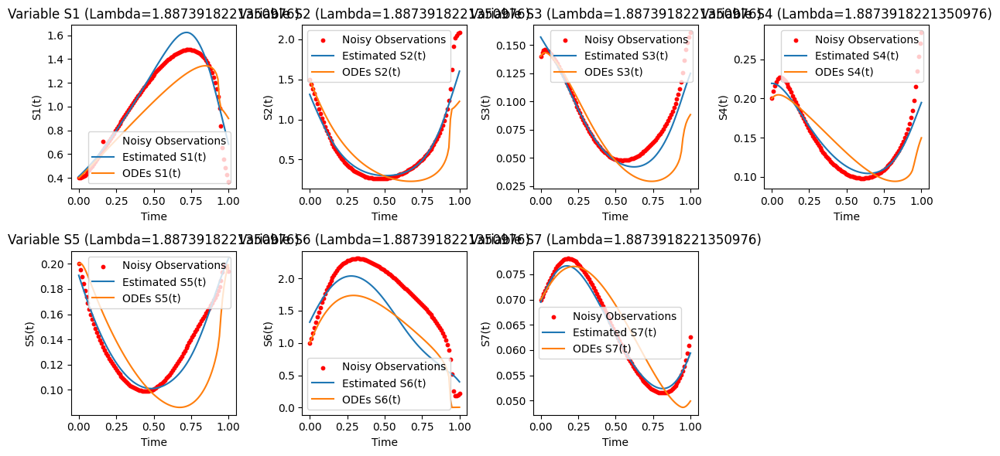

Lambda: 2.8072162039411785; [1.40467832e+00 7.29667692e+02 4.79064316e+00 9.22641285e+00
 8.07591890e+01 2.26445235e+00 3.43250526e+00 1.97781734e+00
 5.09475398e+00 1.70951541e+01 1.72718153e-01 2.82136147e-01
 8.13059534e-01 4.19511537e+00]


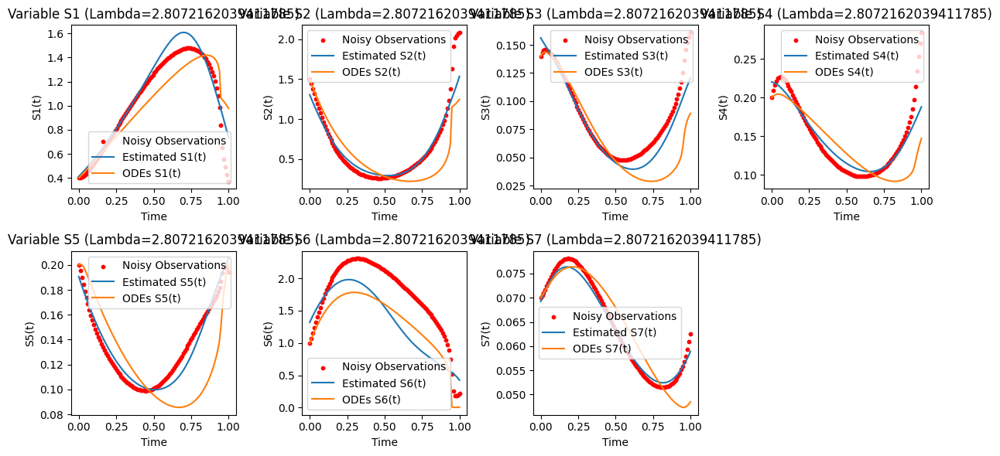

Lambda: 4.175318936560405; [1.49786612e+00 7.29656762e+02 4.77670509e+00 9.52724530e+00
 8.26473409e+01 2.17480865e+00 3.51903355e+00 2.02005871e+00
 5.26726319e+00 1.70951541e+01 1.76437755e-01 2.78496505e-01
 8.33356894e-01 4.17357312e+00]


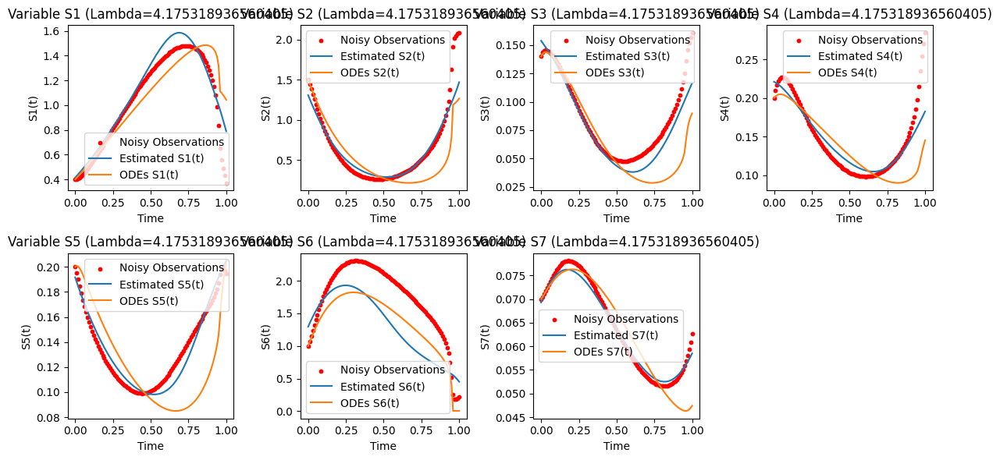

Lambda: 6.2101694189156165; [1.57764289e+00 7.29648568e+02 4.76449797e+00 9.81150565e+00
 8.43699674e+01 2.10562613e+00 3.61044668e+00 2.05423982e+00
 5.41129353e+00 1.70951541e+01 1.79480695e-01 2.75275729e-01
 8.51818797e-01 4.15194074e+00]


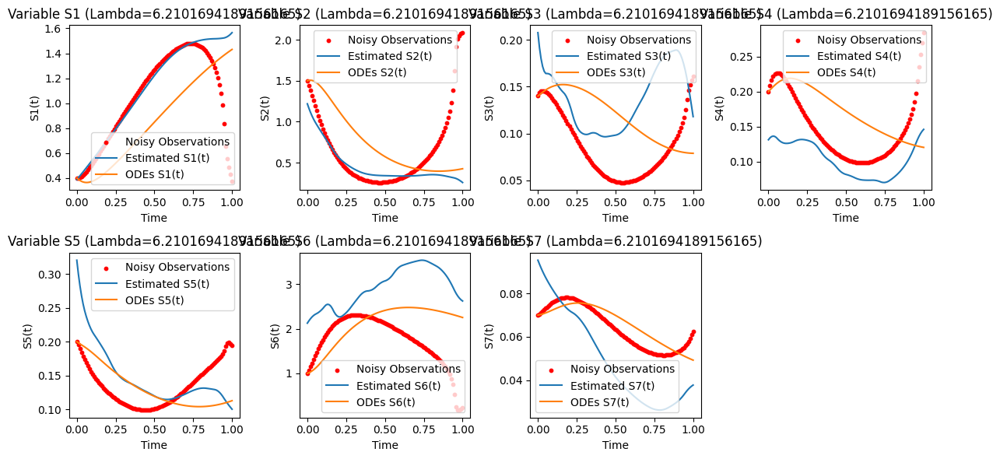

Lambda: 9.236708571873866; [1.80479999e+00 7.29632810e+02 4.56026919e+00 9.13785628e+00
 8.00751962e+01 8.33062960e-01 3.69307872e+00 3.34628892e+00
 4.30209832e+00 1.70951541e+01 3.19736308e-01 4.39741781e-01
 8.04509993e-01 4.12955607e+00]


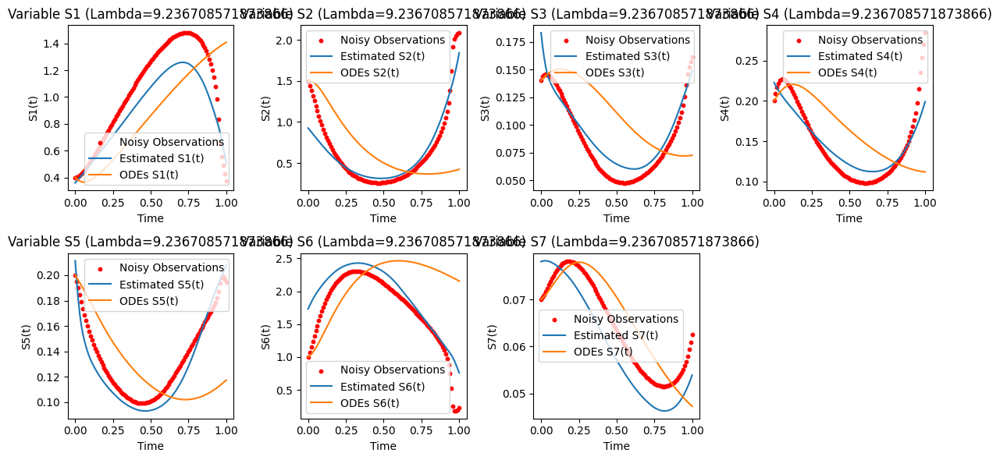

Lambda: 13.738237958832638; [1.78892003e+00 7.29624680e+02 4.63884227e+00 9.70148340e+00
 8.25167134e+01 8.56268520e-01 4.44709668e+00 3.37059361e+00
 5.15280518e+00 1.70951541e+01 3.21356301e-01 3.92854524e-01
 8.34669986e-01 4.13744006e+00]


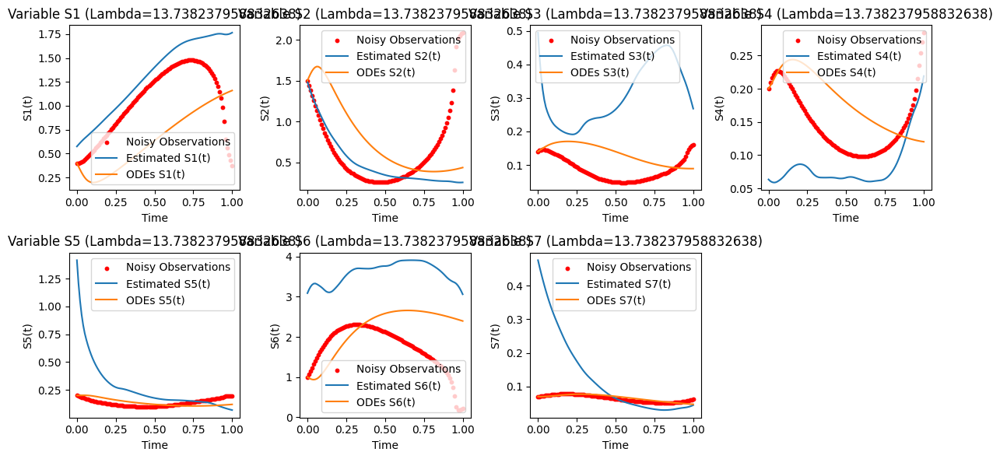

Lambda: 20.43359717856944; [1.78487046e+00 7.29624863e+02 4.79314080e+00 9.79959033e+00
 8.21863907e+01 8.26305101e-01 4.37562332e+00 3.28520628e+00
 5.02896228e+00 1.70951541e+01 3.68657472e-01 3.35153229e-01
 8.43030878e-01 4.13575442e+00]


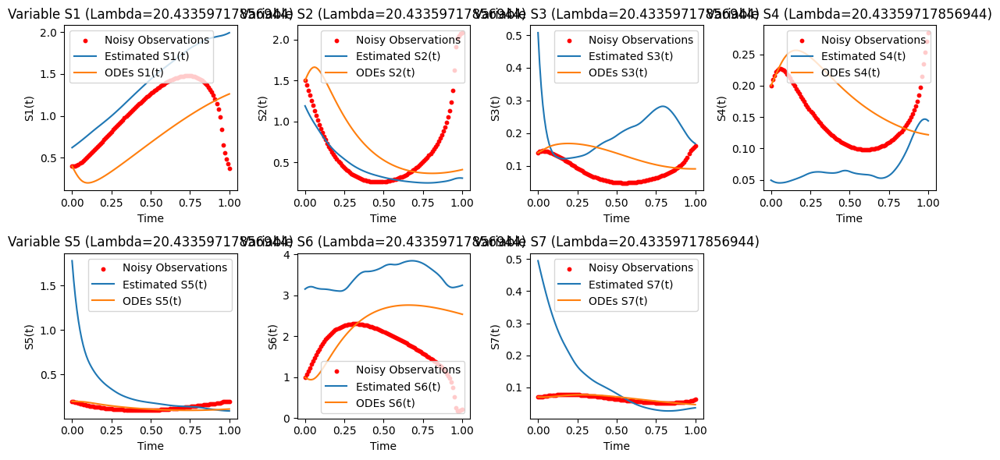

Lambda: 30.39195382313201; [1.88814625e+00 7.29622015e+02 5.00779926e+00 1.03980015e+01
 8.29780336e+01 7.26991944e-01 5.08918027e+00 3.20387777e+00
 4.95123938e+00 1.70951541e+01 3.73177961e-01 3.10499769e-01
 8.34734219e-01 4.11015928e+00]


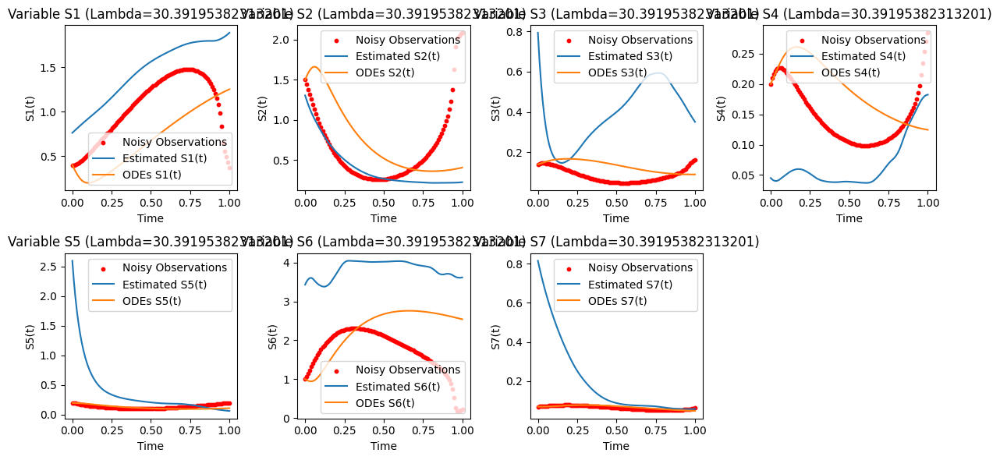

Lambda: 45.2035365636025; [1.87880769e+00 7.29621609e+02 5.11413774e+00 1.03893188e+01
 8.31935388e+01 7.16244072e-01 5.45666671e+00 3.09171133e+00
 4.94067690e+00 1.70951541e+01 3.73242819e-01 2.99680968e-01
 8.13799001e-01 4.11425816e+00]


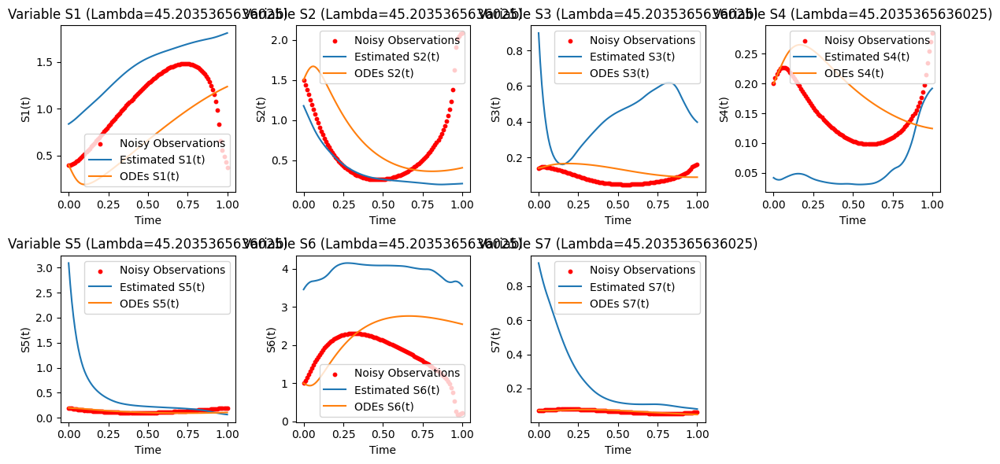

Lambda: 67.23357536499334; [1.86591042e+00 7.29621496e+02 5.24889310e+00 1.04866683e+01
 8.32211967e+01 7.06441713e-01 5.67932538e+00 2.96537158e+00
 4.91622401e+00 1.70951541e+01 3.74758276e-01 2.68623345e-01
 7.90659857e-01 4.11382662e+00]


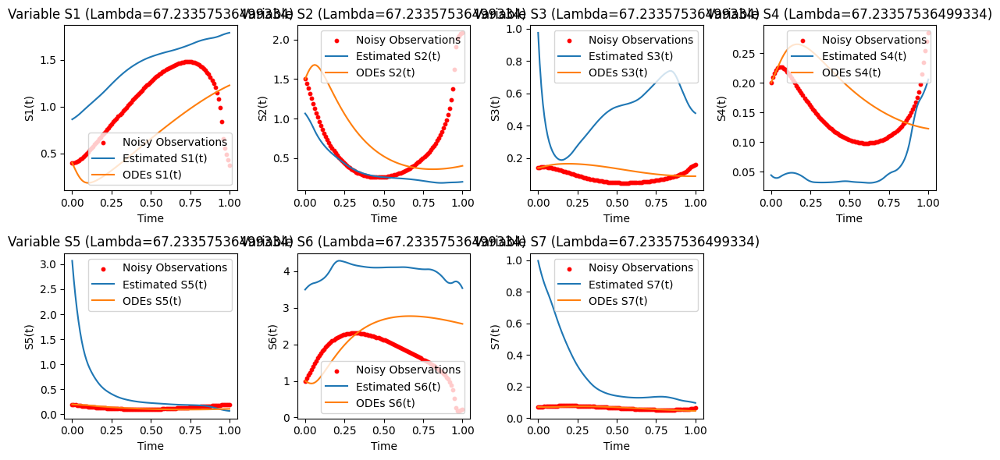

Lambda: 100.0; [1.85830597e+00 7.29621485e+02 5.31379869e+00 1.04763578e+01
 8.31989060e+01 7.00966821e-01 5.67216435e+00 2.89431573e+00
 4.91540278e+00 1.70951541e+01 3.75944878e-01 2.48089813e-01
 7.83670053e-01 4.11404160e+00]


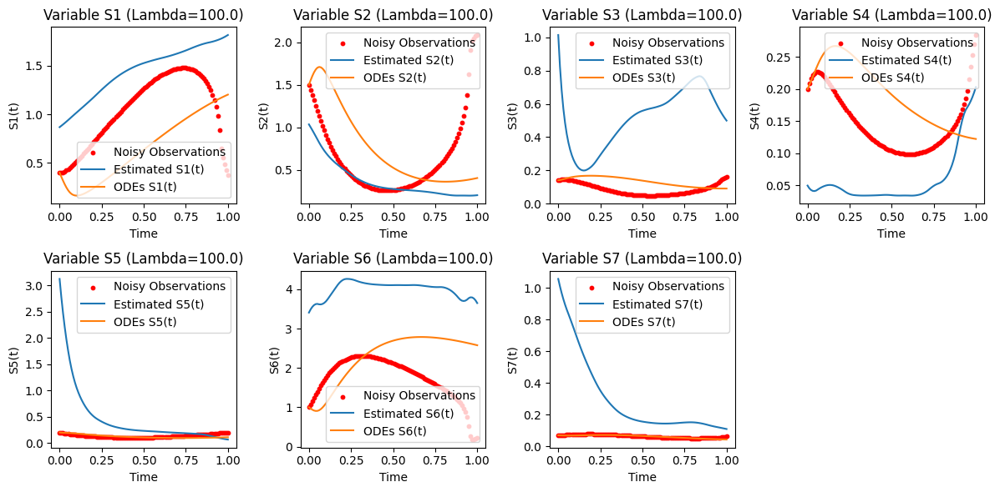

In [12]:
# [11]
# Running the CollocInfer Method

# Define initial θ and λ sequence
theta_init = model.get_initial_parameter_guess()

lambda_seq = list(np.logspace(-3, 2, 30)) + list(np.logspace(-3, 2, 30))[::-1] + list(np.logspace(-3, 2, 30)) + list(np.logspace(-3, 2, 30))[::-1] + list(np.logspace(-3, 2, 30)) # + list(np.logspace(-3, 2, 30))[::-1] + list(np.logspace(-3, 2, 30)) + list(np.logspace(-3, 2, 30))[::-1] + list(np.logspace(-3, 2, 30)) + list(np.logspace(-3, 2, 30))[::-1] + list(np.logspace(-3, 2, 30)) + list(np.logspace(-3, 2, 30))[::-1]
# lambda_seq = np.linspace(1e-3, 1e2, 200)# [::-1]
# lambda_seq = np.logspace(0.0, 1.0, 10)

# Run CollocInfer method
theta_list, c_list, J_list = colloc_infer(theta_init, lambda_seq)

<!-- MD -->

## Running the CollocInfer Method

We define a sequence of λ \lambda  values and initial guesses for θ \theta . We then run the `CollocInfer` method to estimate θ \theta  and the coefficients c \mathbf{c} .

We use the estimates from the previous λ \lambda  as the initial guess for the next λ \lambda , as per the lambda progression strategy.


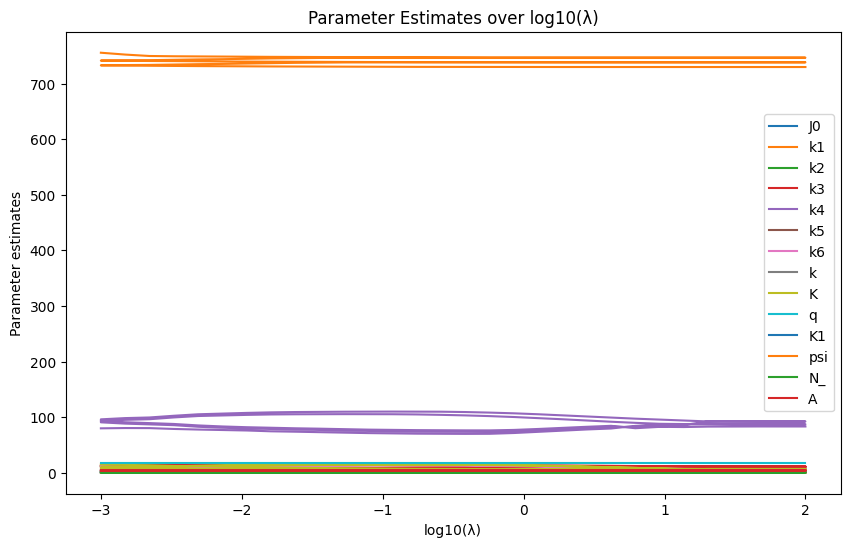

In [13]:
# [12]
# Visualizing Parameter Estimates Over λ

# Plot parameter estimates over lambda
log_lambda = np.log10(lambda_seq)
theta_array = np.array(theta_list)
if enforce_positive_parameters:
    # Convert back from log parameters
    theta_array_exp = np.exp(theta_array)
    param_names = model.parameter_names
    plt.figure(figsize=(10, 6))
    for i, param in enumerate(param_names):
        plt.plot(log_lambda, theta_array_exp[:, i], label=param)
    plt.xlabel('log10(λ)')
    plt.ylabel('Parameter estimates')
    plt.legend()
    plt.title('Parameter Estimates over log10(λ)')
    plt.show()
else:
    param_names = model.parameter_names
    plt.figure(figsize=(10, 6))
    for i, param in enumerate(param_names):
        plt.plot(log_lambda, theta_array[:, i], label=param)
    plt.xlabel('log10(λ)')
    plt.ylabel('Parameter estimates')
    plt.legend()
    plt.title('Parameter Estimates over log10(λ)')
    plt.show()

<!-- MD -->

## Visualizing Parameter Estimates Over λ \lambda 

We plot the estimated parameters θ \theta  as a function of log10(λ) \log_{10}(\lambda)  to observe how they stabilize as λ \lambda  increases.

This helps in selecting the final model based on the stability of parameter estimates.

## Conclusion

We have implemented the CollocInfer method for ODE systems, estimating both the parameters and the initial conditions from noisy data. The method iteratively updates the spline coefficients and parameters, balancing data fitting and equation fitting through the smoothing parameter λ \lambda .

**Key Points:**

- **Basis Functions:** We used B-splines of order 5 with 34 basis functions for each variable.
- **Quadrature:** Simpson's Rule was used with 151 equally spaced quadrature points to approximate the integral in the inner criterion.
- **Optimization:** Both inner and outer optimizations were performed using the `L-BFGS-B` method, with explicit gradients provided for the outer optimization.
- **Lambda Progression:** A logarithmic sequence of λ \lambda  values was used to explore the trade-off between data fit and equation fit.
- **Unobservable Variables:** We handled unobservable variables by not including their data fitting terms in the inner criterion.
- **Parameter Constraints:** We estimated the logarithms of parameters to ensure positivity, as suggested.